In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader

import torchvision.transforms as transforms
import torchvision.utils
from torchvision.utils import make_grid

import torchvision.datasets

import matplotlib.pyplot as plt
plt.rcParams["figure.figsize"] = (10,6)

from tqdm import tqdm

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Introduction to Generative Adversarial Networks (GANs)

In this notebook you will build a GAN from scratch, grossly following the DCGAN architecture.

**Goals:**


1.   Build a GAN arhictecture from scratch
2.   Write the GAN loss function and train GAN from scratch
3.   Have experience with some of the instability problems inherent with training GANs.
4.   [Bonus] Extend the unconditional GAN into a conditional GAN.



## 1. Getting Started

We will work with the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset. It contains 60,000 images size 28x28 of handwritten digits, from 0 to 9.

## 1. Dataloading

### 1.1 Define some hyperparameters and transforms


In [2]:
batch_size = 128 # Images per batch

# Resize to 32x32 for easier upsampling/downsampling
mytransform = transforms.Compose([transforms.Resize(32),
                                  transforms.ToTensor(),
                                 transforms.Normalize((.5), (.5))]) # normalize between [-1, 1] with tanh activation

mnist_train = torchvision.datasets.MNIST(root='.', download=True, transform=mytransform)

100%|██████████| 9912422/9912422 [00:00<00:00, 79963440.06it/s]


Extracting ./MNIST/raw/train-images-idx3-ubyte.gz to ./MNIST/raw



100%|██████████| 28881/28881 [00:00<00:00, 105427061.64it/s]

Extracting ./MNIST/raw/train-labels-idx1-ubyte.gz to ./MNIST/raw




100%|██████████| 1648877/1648877 [00:00<00:00, 19999628.10it/s]


Extracting ./MNIST/raw/t10k-images-idx3-ubyte.gz to ./MNIST/raw



100%|██████████| 4542/4542 [00:00<00:00, 19700650.23it/s]


Extracting ./MNIST/raw/t10k-labels-idx1-ubyte.gz to ./MNIST/raw



In [3]:
dataloader = DataLoader(dataset=mnist_train,
                         batch_size=batch_size,
                         shuffle=True)

In [4]:
# plot some images
real_batch, real_labels = next(iter(dataloader))

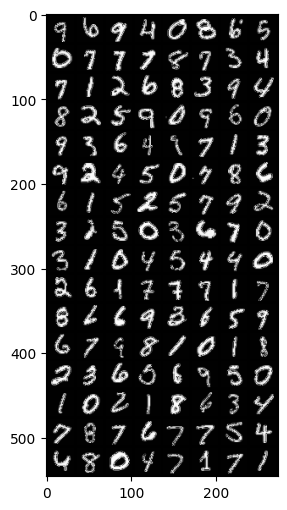

In [5]:
plt.imshow(transforms.ToPILImage()(make_grid(real_batch)))

## 2. Model Architecture

We will follow the general architecture of a DCGAN - or deep convolutional GAN. This [influential paper](https://arxiv.org/pdf/1511.06434v2.pdf) produced much of the foundation for modern GANs and how to train them.

(GANs are notoriously **hard** to train, we will try to get a feeling why in this notebook.)


Complete the function `get_upscaling_block`. Then, use the function to define our model defined as follows:

Input: Random "noise" $z$ shaped `[n_batch, n_z]`

Output: Generated image size `[n_batch, 1, 32, 32]` in range [-1, 1]

1. Reshape z into `[n_batch, n_z, 1, 1]` to make it into an "image"
2. First upscaling block $\rightarrow$ `[n_batch, ngf*4, 4, 4]`
3. Second upscaling block $\rightarrow$ `[n_batch, ngf*2, 8, 8]`
4. Third upscaling block $\rightarrow$ `[n_batch, ngf, 16, 16]`
5. Fourth (and last) upscaling block $\rightarrow$ `[n_batch, 1, 32, 32]`

## 2.1. The Generator



The generator performs subsequent upsampling blocks, transforming a latent vector shaped [batch_size, latent_size] into an image (values in [-1, 1]).

The generator block will consists of:
- Transpose Convolution
- Batch Norm
- ReLU

In [6]:
def get_upscaling_block(channels_in, channels_out, kernel, stride, padding, bias=False,last_layer=False):
    '''
    Each transpose conv will be followed by BatchNorm and ReLU,
    except the last block (which is only followed by tanh)
    '''
    if last_layer:
        upscaling_block = nn.Sequential(
            nn.ConvTranspose2d(channels_in,channels_out,kernel,stride,padding,bias=bias),
            nn.Tanh()
        )
    else:
        upscaling_block = nn.Sequential(
          nn.ConvTranspose2d(channels_in,channels_out,kernel,stride,padding,bias=False),
          nn.BatchNorm2d(channels_out),
          nn.ReLU() )
    return upscaling_block

class Generator(nn.Module):
    def __init__(self, nz, ngf, nchannels=1):
        '''
        nz: The latent size (100 in our case)
        ngf: The channel-size before the last layer (32 our case)
        '''
        super().__init__()

        kernel = 4
        self.model = nn.Sequential(
            get_upscaling_block(nz, ngf*4, kernel, stride=1, padding=0),
            get_upscaling_block(ngf*4, ngf*2, kernel, stride=2, padding=1),
            get_upscaling_block(ngf*2, ngf, kernel, stride=2, padding=1),
            get_upscaling_block(ngf,nchannels, kernel, stride=2, padding=1, last_layer=True)
        )

    def forward(self, z):
        x = z.unsqueeze(2).unsqueeze(2) # give spatial dimensions to z
        return self.model(x)


### 2.1.3. Sanity Tests

In [7]:
nz = 1000
z = torch.randn(batch_size, nz)

G = Generator(nz=nz, ngf=16,nchannels=3)
print(G)
assert G(z).shape == (batch_size, 3, 32, 32)

print("-----------------------------")
G = Generator(nz=nz, ngf=32)
print(G)
assert G(z).shape == (batch_size, 1, 32, 32)

Generator(
  (model): Sequential(
    (0): Sequential(
      (0): ConvTranspose2d(1000, 64, kernel_size=(4, 4), stride=(1, 1), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
    (1): Sequential(
      (0): ConvTranspose2d(64, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
    (2): Sequential(
      (0): ConvTranspose2d(32, 16, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU()
    )
    (3): Sequential(
      (0): ConvTranspose2d(16, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): Tanh()
    )
  )
)
-----------------------------
Generator(
  (model): Sequential(
    (0): Sequential(
      (0): ConvTranspose2d(1000, 128, kernel_

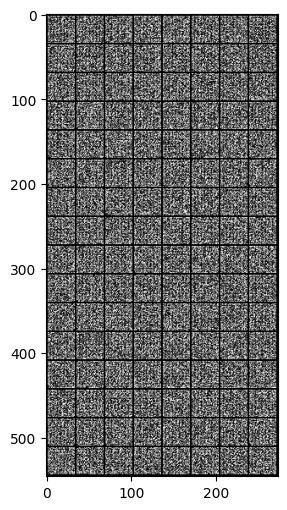

In [8]:
# visualize the output - at first it should just look like random noise!!
x_fake = G(z)
plt.imshow(transforms.ToPILImage()(make_grid(x_fake, nrow=8)))

## 2.2. The discriminator

The discriminator will be a mirror image of the generator.

The discriminator will also use a fully convolutional architecutre, with each block consisting of:
- Conv layer
- BatchNorm
- ReLU

Complete the function `get_downscaling_block` and then use it to define the following architecture for the discriminator:

Input: Image shaped `[n_batch, 1, 32, 32]` (in [-1, 1])
Output: Discriminator scores `[n_batch, 1]` in range [0, 1]

1. First downscaling block $\rightarrow$ `[n_batch, ndf, 16, 16]`
2. Second downscaling block $\rightarrow$ `[n_batch, ndf*2, 8, 8]`
3. Third downscaling block $\rightarrow$ `[n_batch, ndf*4, 4, 4]`
4. Last downscaling block $\rightarrow$ `[n_batch, 1]`

In [9]:
def get_downscaling_block(channels_in, channels_out, kernel, stride, padding, use_batch_norm=True, is_last=False):

    if is_last:
        downscaling_block = nn.Sequential(
            nn.Conv2d(channels_in,channels_out,kernel,stride,padding,bias=False),
            nn.Sigmoid()
        )

    elif not use_batch_norm:
        downscaling_block = nn.Sequential(
            nn.Conv2d(channels_in,channels_out,kernel,stride,padding,bias=False),
            nn.LeakyReLU(0.2)
        )

    else:
        downscaling_block = nn.Sequential(
            nn.Conv2d(channels_in,channels_out,kernel,stride,padding,bias=False),
            nn.BatchNorm2d(channels_out),
            nn.LeakyReLU(0.2)
        )

    return downscaling_block


class Discriminator(nn.Module):
    def __init__(self, ndf, nchannels=1,use_batch_norm=True):
        super().__init__()

        kernel = 4
        self.model = nn.Sequential(
            get_downscaling_block(nchannels,ndf, kernel, stride=2, padding=1, use_batch_norm=use_batch_norm),
            get_downscaling_block(ndf,ndf*2, kernel, stride=2, padding=1, use_batch_norm=use_batch_norm),
            get_downscaling_block(ndf*2,ndf*4, kernel, stride=2, padding=1, use_batch_norm=use_batch_norm),
            get_downscaling_block(ndf*4,1, kernel, stride=1, padding=0, use_batch_norm=use_batch_norm,is_last=True)
        )

    def forward(self, x):
        return self.model(x).squeeze(1).squeeze(1) # remove spatial dimensions

### 2.2.3 Sanity Checking

In [10]:
real_batch, real_labels = next(iter(dataloader))

In [11]:
D = Discriminator(ndf=32, nchannels=1)
print(D)
assert D(real_batch).shape == (real_batch.shape[0],1)

Discriminator(
  (model): Sequential(
    (0): Sequential(
      (0): Conv2d(1, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (1): Sequential(
      (0): Conv2d(32, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (2): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2)
    )
    (3): Sequential(
      (0): Conv2d(128, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
      (1): Sigmoid()
    )
  )
)


# 3. Training

## 3.1 Loss
The essential thing to remember is that the logistic and the non-saturating logistic GAN losses can be written exclusively using the [binary cross entropy loss](https://pytorch.org/docs/stable/generated/torch.nn.BCELoss.html). Our GAN loss will be defined ONLY using the following criterion:



In [13]:
criterion = nn.BCELoss() # we will build off of this to make our final GAN loss!

## 3.2 Helper functions

We will need a few helper functions.
1. First, we need to continuously sample z from a Gaussian distribution.
2. Secondly, we need to make our "ground-truth" labels when using the BCE loss. This should output vectors of either 0s or 1s.

In [14]:
def sample_z(batch_size, nz):
    return torch.randn(batch_size, nz, device=device)

# this is for the real ground-truth label
def get_labels_one(batch_size):
    r = torch.ones(batch_size, 1)
    return r.to(device)

# this is for the generated ground-truth label
def get_labels_zero(batch_size):
    r = torch.zeros(batch_size, 1)
    return r.to(device)


# To initialize the weights of a GAN, the DCGAN paper found that best results are obtained
# with Gaussian initialization with mean=0; std=0.02
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)


# for visualization
to_pil = transforms.ToPILImage()
renorm = transforms.Normalize((-1.), (2.))

### Define noises

In [ ]:
NOISES_100 = [sample_z(64,nz=100) for _ in range(5)]
NOISES_10 = [sample_z(64,nz=10) for _ in range(5)]
NOISES_1000 = [sample_z(64,nz=1000) for _ in range(5)]

NOISES_1000_CIFAR = [sample_z(64,nz=1000) for _ in range(2)]

## 3.3 Creating the optimizers and hyperparameters

The original DCGAN paper shows that Adam works well in the generator and the discriminator with a learning rate of 0.0002 and Beta1 = 0.5.

Define your optimizers

In [ ]:
nz = 100
ngf = 32
ndf = 32

nchannels= 1
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

netD = Discriminator(ndf, nchannels).to(device)
netG = Generator(nz, ngf).to(device)

netD.apply(weights_init)
netG.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))

## 3.3 Training!

Now for the fun part, training!
Training a GAN consists in making an update to the discriminator, then the generator.
Training a GAN requires BABYSITTING!! Remember that many things can go wrong when training a GAN:
- The discriminator is too strong for the generator - the generator cannot improve.
- The generator easily fools the discriminator - cannot learn.
- Mode collapse - generator is not capable of generating diverse images.

In [ ]:
def training(netG, netD, nz, g_opt, d_opt, dataloader, display_freq=200, nb_epochs=5, display_first_last=False):
    g_losses = []
    d_losses = []
    g_mean_grad = []
    d_mean_grad = []

    j = 0

    z_test = sample_z(64, nz)  # we generate the noise only once for testing

    for epoch in tqdm(range(nb_epochs)):

        # train
        for i, batch in enumerate(dataloader):
            im, _ = batch  # we don't care about the label for unconditional generation
            im = im.to(device)

            cur_batch_size = im.shape[0]
            # gt --> ground-truth
            real_gt_labels = get_labels_one(batch_size)
            generated_gt_labels = get_labels_zero(batch_size)

            # 1. sample a z vector
            random_sample = sample_z(cur_batch_size, nz)

            # 2. Generate a fake image
            fake_image = netG(random_sample)

            # 3. Classify real image with D
            yhat_real = netD(im)

            # 4. Classify fake image with D
            yhat_fake = netD(fake_image)

            ###
            ### Discriminator
            ###

            d_loss_fake = criterion(yhat_fake, get_labels_zero(cur_batch_size))
            d_loss_real = criterion(yhat_real, get_labels_one(cur_batch_size))
            d_loss = d_loss_real + d_loss_fake
            d_opt.zero_grad()
            d_loss.backward(retain_graph=True)
            gradient_d = [param.grad for param in netD.parameters()][0]
            d_opt.step()

            ###
            ### Generator
            ###

            yhat_fake_for_generator = netD(fake_image)
            g_loss = criterion(yhat_fake_for_generator, get_labels_one(cur_batch_size))
            g_opt.zero_grad()
            g_loss.backward()
            gradient_g = [param.grad for param in netG.parameters()][0]
            g_opt.step()

            # Save Metrics
            d_losses.append(d_loss.item())
            g_losses.append(g_loss.item())
            g_mean_grad.append(torch.mean(gradient_g).item())
            d_mean_grad.append(torch.mean(gradient_d).item())

            avg_real_score = yhat_real.mean().item()
            avg_fake_score = yhat_fake.mean().item()

            # Display after each display_freq batches
            if not display_first_last and j % display_freq == 0:
                print(f"it: {j}; g_loss: {g_loss}; d_loss: {d_loss}; avg_real_score: {avg_real_score}; avg_fake_score: {avg_fake_score};\n\
                    g_gradient: [mean,norm,max,min]={torch.mean(gradient_g).item(),torch.norm(gradient_g).item(),torch.max(gradient_g).item(),torch.min(gradient_g).item()};\n\
                    d_gradient: [mean,norm,max,min]={torch.mean(gradient_d).item(),torch.norm(gradient_d).item(),torch.max(gradient_d).item(),torch.min(gradient_d).item()}")

                display_plots(netG, z_test, g_losses, d_losses, g_mean_grad, d_mean_grad)

            # Display for the first and last iteration
            thesize = len(dataloader)*nb_epochs
            if display_first_last and (j == 0 or j == thesize//2 or j == thesize - 1):
                print(f"it: {j}; g_loss: {g_loss}; d_loss: {d_loss}; avg_real_score: {avg_real_score}; avg_fake_score: {avg_fake_score};\n\
                    g_gradient: [mean,norm,max,min]={torch.mean(gradient_g).item(),torch.norm(gradient_g).item(),torch.max(gradient_g).item(),torch.min(gradient_g).item()};\n\
                    d_gradient: [mean,norm,max,min]={torch.mean(gradient_d).item(),torch.norm(gradient_d).item(),torch.max(gradient_d).item(),torch.min(gradient_d).item()}")

                display_plots(netG, z_test, g_losses, d_losses, g_mean_grad, d_mean_grad)

            j += 1

    print("Training complete.")
    # display_plots(netG, z_test, g_losses, d_losses, g_mean_grad, d_mean_grad)


def display_plots(netG, z_test, g_losses, d_losses, g_mean_grad, d_mean_grad):
    fake_im = netG(z_test)

    un_norm = renorm(fake_im)  # for visualization

    grid = torchvision.utils.make_grid(un_norm, nrow=8)
    pil_grid = to_pil(grid)

    plt.imshow(pil_grid)
    plt.show()

    plt.figure(figsize=(12, 7))
    plt.subplot(121)
    plt.title("Losses during the train")
    plt.plot(range(len(g_losses)), g_losses, label='g loss', alpha=0.5)
    plt.plot(range(len(g_losses)), d_losses, label='d loss', alpha=0.5)
    plt.legend()

    plt.subplot(122)
    plt.title("Mean of the first layer parameter gradients")
    plt.plot(range(len(g_mean_grad)), g_mean_grad, label='g mean grad', c='green', alpha=0.5)
    plt.plot(range(len(d_mean_grad)), d_mean_grad, label='d mean grad', c='pink', alpha=0.7)

    plt.legend()
    plt.show()

  0%|          | 0/5 [00:00<?, ?it/s]

it: 0; g_loss: 0.9882804155349731; d_loss: 1.4374113082885742; avg_real_score: 0.5144361257553101; avg_fake_score: 0.5096443891525269;
                    g_gradient: [mean,norm,max,min]=(1.1423789146647323e-05, 3.3224010467529297, 0.04635477811098099, -0.05174309387803078);
                    d_gradient: [mean,norm,max,min]=(-0.02353857457637787, 7.344161510467529, 1.188443899154663, -1.4315353631973267)


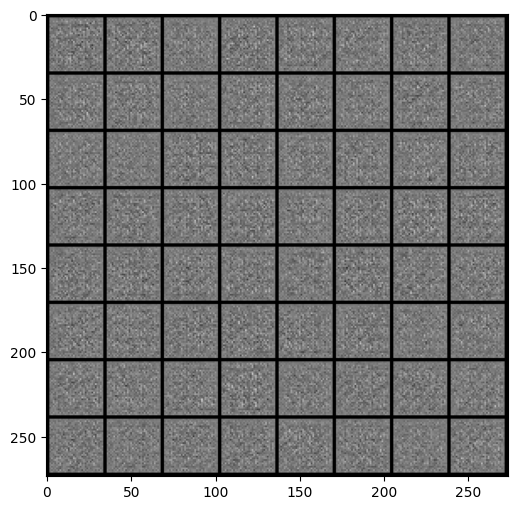

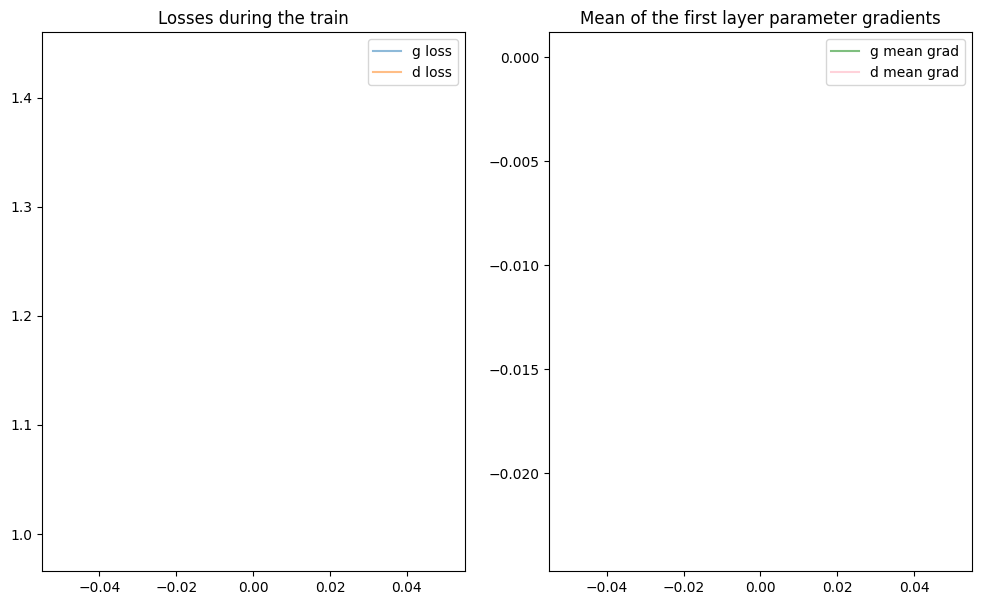

 40%|████      | 2/5 [01:03<01:35, 31.84s/it]

it: 1172; g_loss: 1.5564485788345337; d_loss: 0.6736843585968018; avg_real_score: 0.7213537693023682; avg_fake_score: 0.27066361904144287;
                    g_gradient: [mean,norm,max,min]=(6.78953729220666e-05, 5.649418830871582, 0.14395098388195038, -0.2293531447649002);
                    d_gradient: [mean,norm,max,min]=(0.16878151893615723, 126.18385314941406, 17.74843978881836, -18.003950119018555)


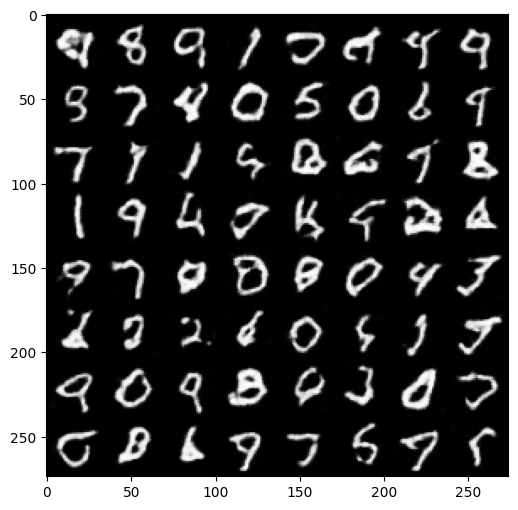

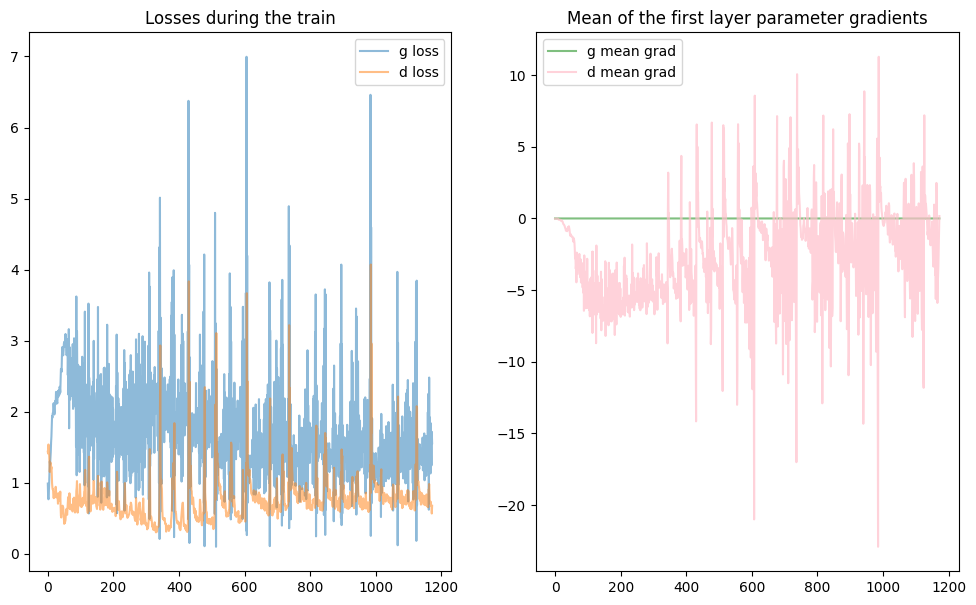

 80%|████████  | 4/5 [02:00<00:29, 29.65s/it]

it: 2344; g_loss: 1.8649511337280273; d_loss: 0.3897806704044342; avg_real_score: 0.7780452966690063; avg_fake_score: 0.10935996472835541;
                    g_gradient: [mean,norm,max,min]=(3.154459045617841e-05, 9.345677375793457, 0.34148529171943665, -0.3592793047428131);
                    d_gradient: [mean,norm,max,min]=(-3.5695486068725586, 239.41864013671875, 40.4133186340332, -61.7952880859375)


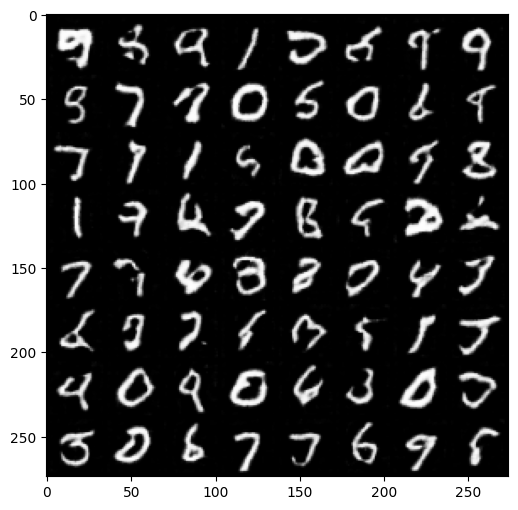

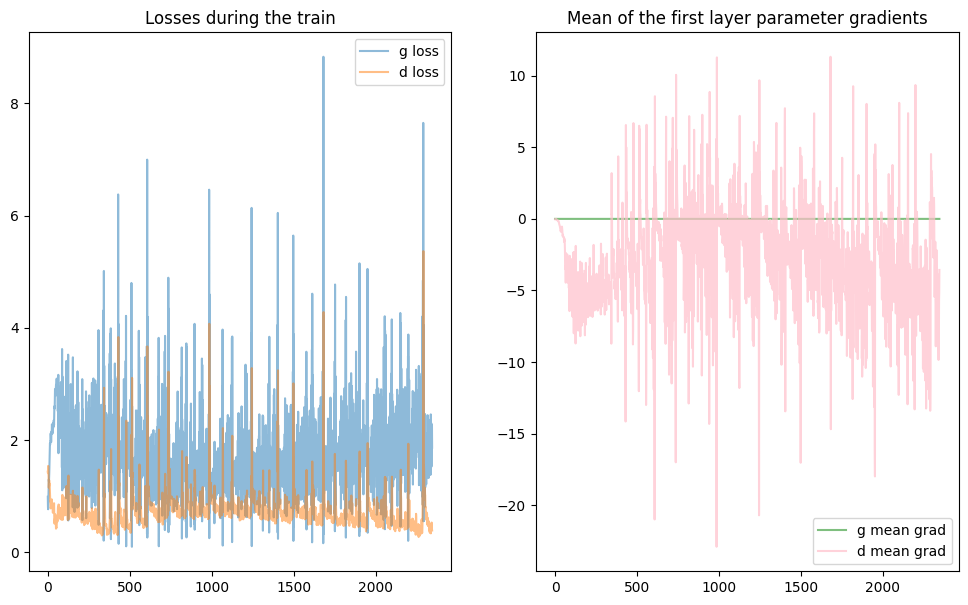

100%|██████████| 5/5 [02:27<00:00, 29.58s/it]

Training complete.


In [ ]:
nz = 100
ngf = 32
ndf = 32

nchannels= 1
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

basic_netD = Discriminator(ndf, nchannels).to(device)
basic_netG = Generator(nz, ngf).to(device)

basic_netD.apply(weights_init)
basic_netG.apply(weights_init)

g_opt = torch.optim.Adam(basic_netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(basic_netD.parameters(), lr=lr_d, betas=(beta1, 0.999))

training(basic_netG,basic_netD,nz,g_opt,d_opt,dataloader,display_freq=200,nb_epochs=5,display_first_last=True)

# Training Challenges in our GAN model

## Mode Collapse

***Mode Collapse***: GANs can suffer from mode collapse, where the generator learns to produce only a limited set of samples, ignoring the diversity in the data distribution. This happens when the generator collapses to a specific mode that fools the discriminator.

- To verifiy this , we will generate 5 times images from a random noise with our trained GAN .
  - ***Assumption*** : Some patterns and images occur too frequently, while certain patterns present in real data are not available.

In [ ]:
def display_generated_images(netG,noises,title,nz=100, times=5,interpolation=False):
    plt.figure(figsize=(15, 9))

    fig = plt.gcf()
    fig.suptitle(title, fontsize=16, color='black', va='center')
    margin = 1.55
    if times == 2 : margin = 1.2
    plt.subplots_adjust(top=margin)  # Adjust the top margin
    
    for i in range(times):
        
        noise = noises[i]
        
        if interpolation:
            alpha  = torch.rand(1).item()
            k = torch.randint(0,1,(1,)).item()
            j  = torch.randint(0,1,(1,)).item()
            noise = alpha*noises[k] + (1-alpha)*noises[j]

        fake_im = netG(noise)
        un_norm = renorm(fake_im)

        grid = torchvision.utils.make_grid(un_norm, nrow=8)
        pil_grid = to_pil(grid)

        plt.subplot(1, times, i + 1)
        plt.imshow(pil_grid)
        plt.axis('off')

    plt.show()

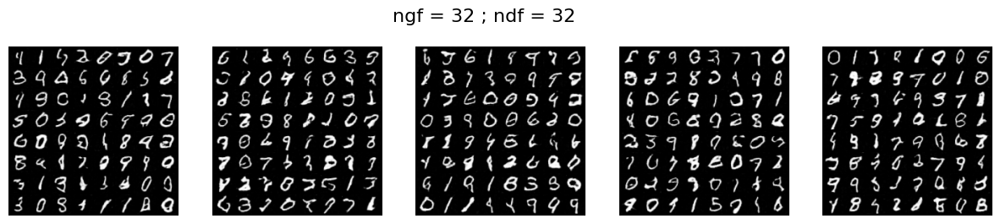

In [ ]:
display_generated_images(netG,NOISES_100,"ngf = 32 ; ndf = 32")

## Non Stability

***Non-Stability***: GANs may not converge to a stable solution, and the generator and discriminator may keep oscillating between states. Achieving a Nash equilibrium between the generator and discriminator is a delicate balancing act.

We can see this in losses plot and mean of the first layer parameter gradients

## Others

- ***Difficulty in Evaluation***: Unlike supervised learning tasks with clear evaluation metrics, evaluating the performance of GANs is challenging. Traditional metrics may not fully capture the quality of generated samples, making it hard to objectively assess the model.

- ***Mode Connectivity***: Even if a GAN successfully generates diverse samples, the latent space may have areas with poor connectivity, making it challenging to smoothly interpolate between different generated samples.

# Dig a little deeper : seeking some improvements

## Modification of $ngf$ and/or $ndf$

### Higher $ndf$

it: 0; g_loss: 3.2976040840148926; d_loss: 1.3766889572143555; avg_real_score: 0.5064529180526733; avg_fake_score: 0.3888096809387207;
                    g_gradient: [mean,norm,max,min]=(3.5472967283567414e-05, 10.38427734375, 0.14734017848968506, -0.16163264214992523);
                    d_gradient: [mean,norm,max,min]=(-0.023019351065158844, 21.50013542175293, 2.2242064476013184, -2.4452648162841797)


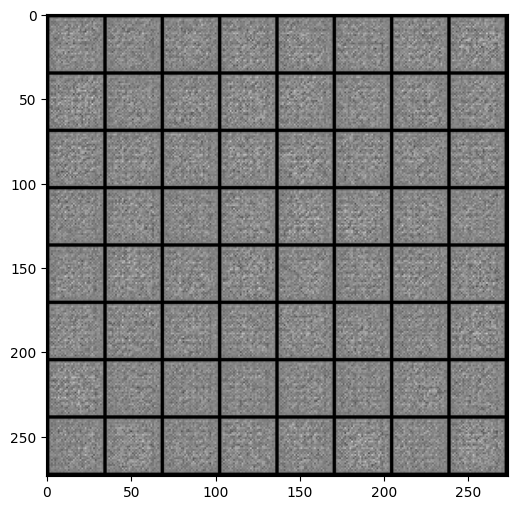

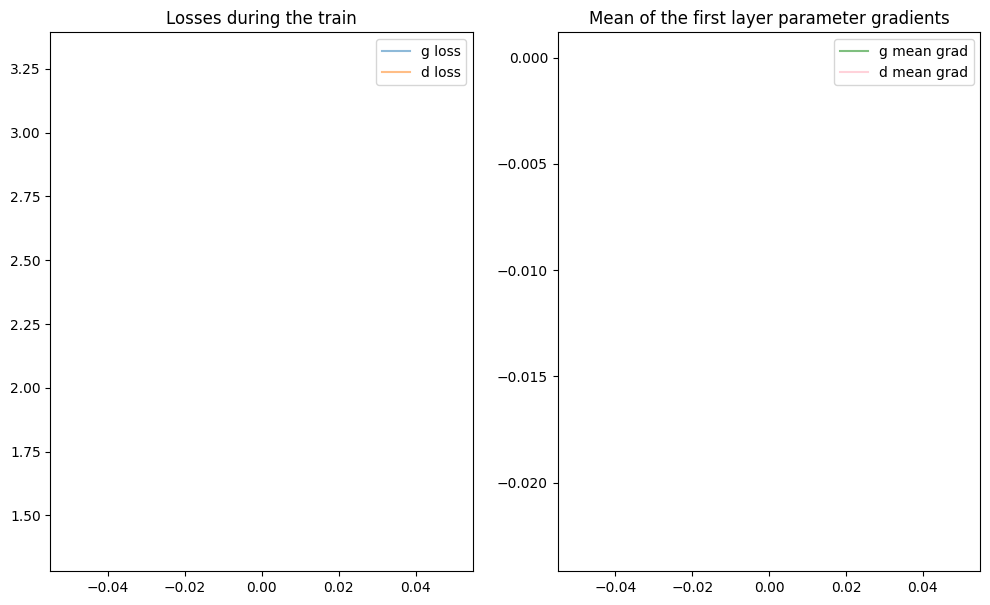

it: 1172; g_loss: 2.2113053798675537; d_loss: 0.3076988756656647; avg_real_score: 0.791612982749939; avg_fake_score: 0.0538967028260231;
                    g_gradient: [mean,norm,max,min]=(-2.1035768440924585e-05, 13.966839790344238, 0.3979569673538208, -0.32934287190437317);
                    d_gradient: [mean,norm,max,min]=(-0.847403347492218, 99.42616271972656, 16.51316261291504, -14.953774452209473)


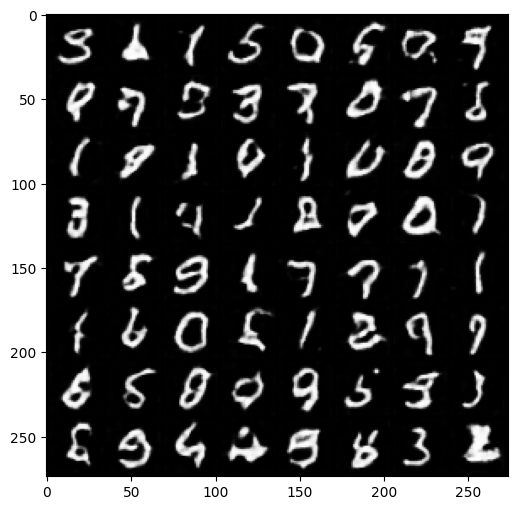

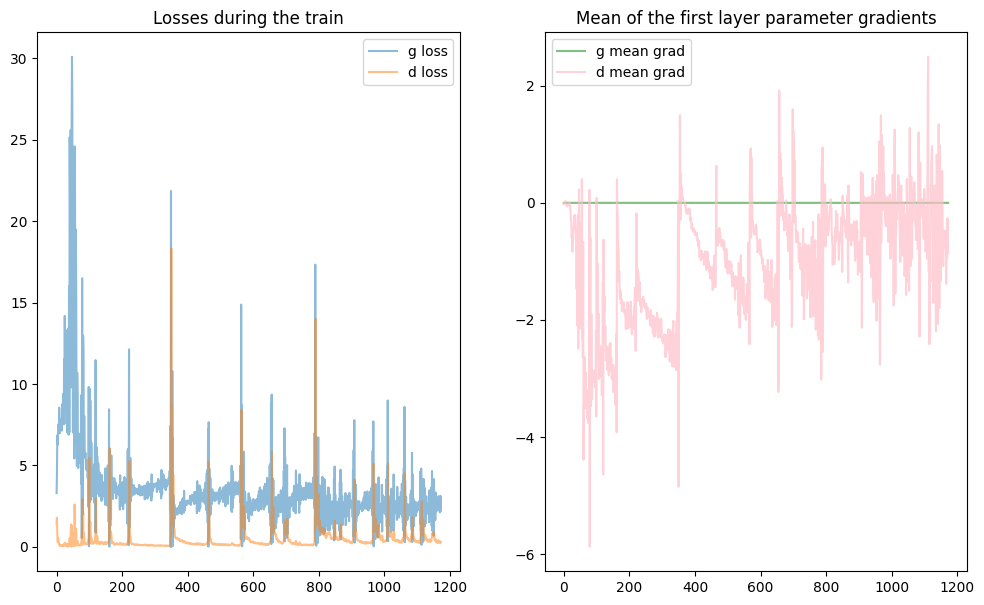

it: 2344; g_loss: 1.5247782468795776; d_loss: 0.72175133228302; avg_real_score: 0.643776535987854; avg_fake_score: 0.16442714631557465;
                    g_gradient: [mean,norm,max,min]=(1.3046196727373172e-05, 6.872990608215332, 0.31668466329574585, -0.2509523630142212);
                    d_gradient: [mean,norm,max,min]=(0.7561391592025757, 211.75563049316406, 47.438175201416016, -7.3820695877075195)


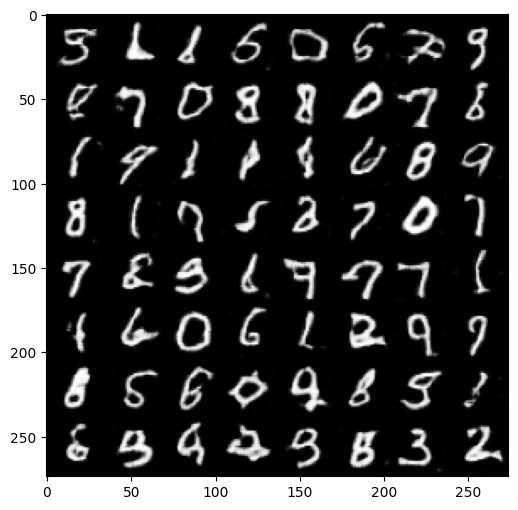

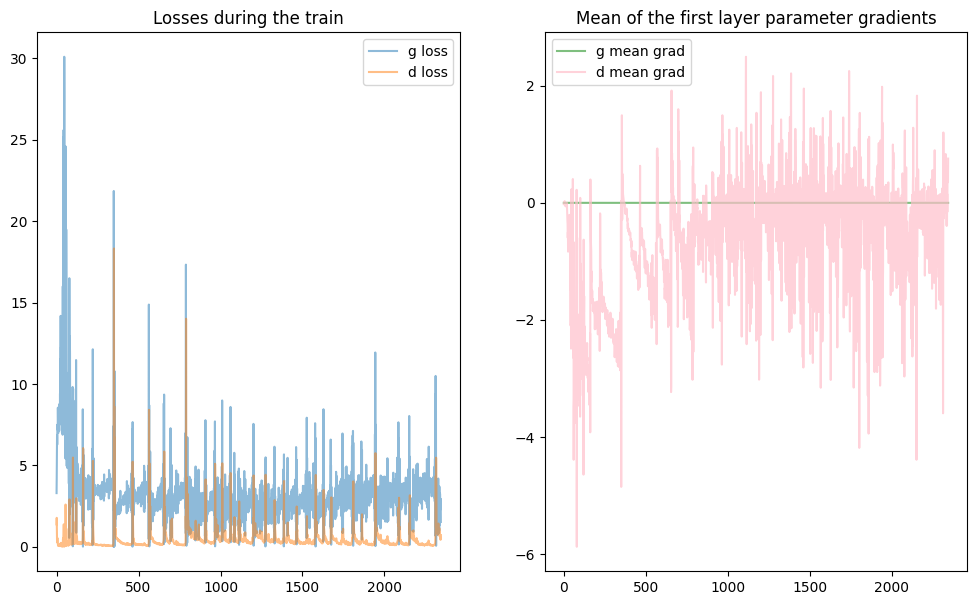

Training complete.


In [ ]:
nz = 100
ngf = 32
ndf = 128

nchannels= 1
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

netD = Discriminator(ndf, nchannels).to(device)
netG = Generator(nz, ngf).to(device)

netD.apply(weights_init)
netG.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))

training(netG,netD,nz,g_opt,d_opt,dataloader,display_freq=200,nb_epochs=5,display_first_last=True)

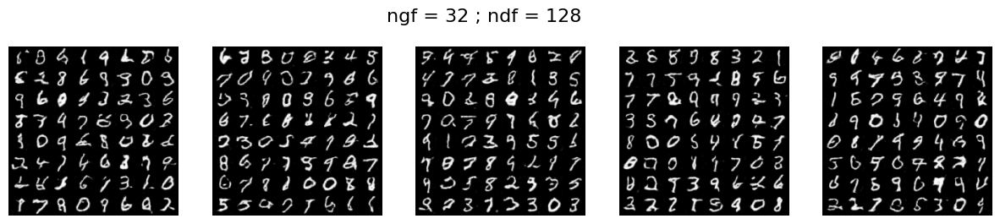

In [ ]:
display_generated_images(netG,NOISES_100,"ngf = 32 ; ndf = 128")

### Higher $ngf$

it: 0; g_loss: 0.9618080258369446; d_loss: 1.555783748626709; avg_real_score: 0.4862521290779114; avg_fake_score: 0.5297408103942871;
                    g_gradient: [mean,norm,max,min]=(3.855062004731735e-06, 3.1848418712615967, 0.02684183232486248, -0.02531564235687256);
                    d_gradient: [mean,norm,max,min]=(0.028773300349712372, 6.732875347137451, 1.1993342638015747, -1.1708601713180542)


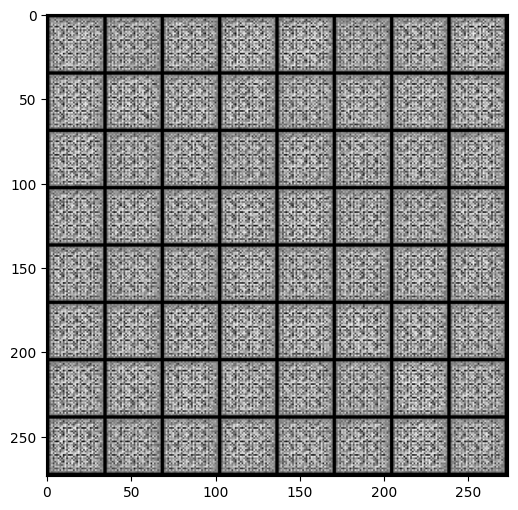

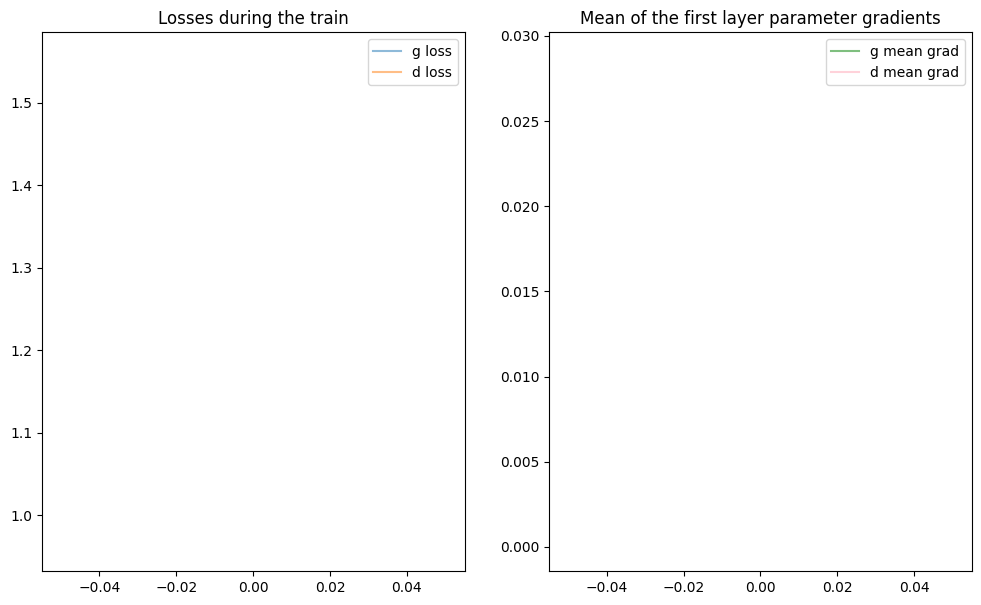

it: 1172; g_loss: 0.44117867946624756; d_loss: 1.2595597505569458; avg_real_score: 0.37668734788894653; avg_fake_score: 0.2210635244846344;
                    g_gradient: [mean,norm,max,min]=(-7.733933102826995e-07, 0.7910705804824829, 0.013513363897800446, -0.014802091754972935);
                    d_gradient: [mean,norm,max,min]=(-3.4025778770446777, 136.1931610107422, 16.635082244873047, -34.667388916015625)


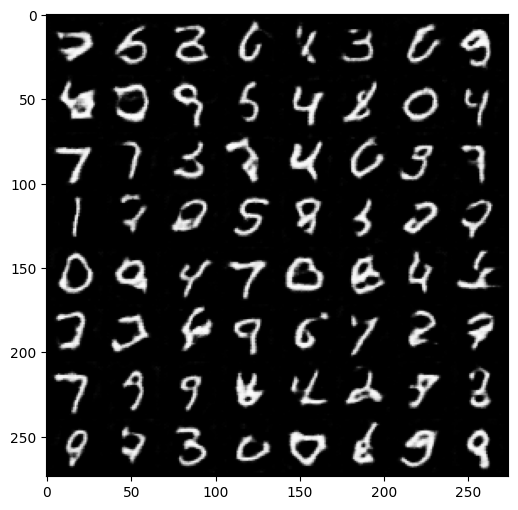

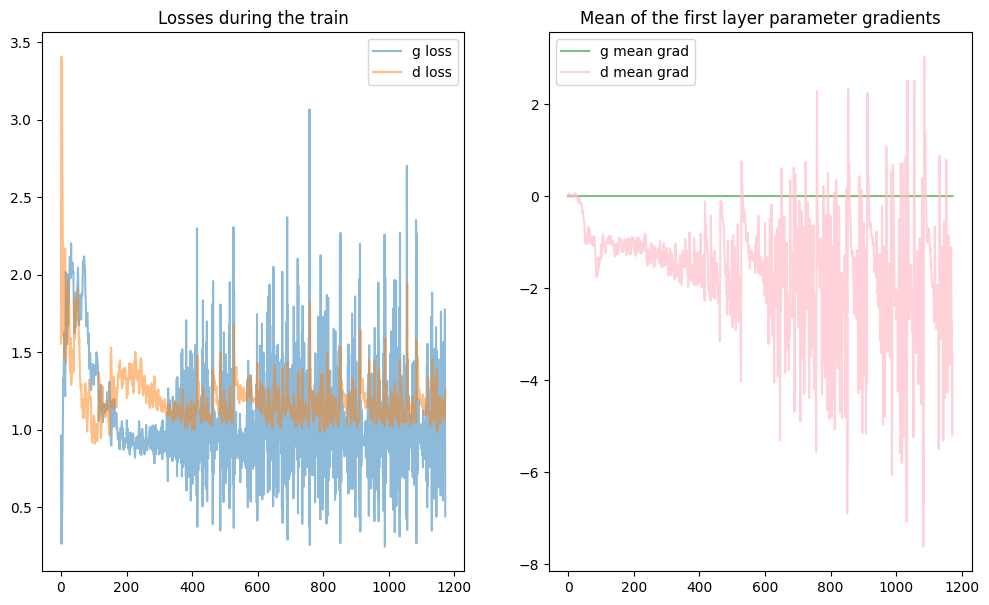

it: 2344; g_loss: 2.6605827808380127; d_loss: 0.572245717048645; avg_real_score: 0.9366976618766785; avg_fake_score: 0.3831429183483124;
                    g_gradient: [mean,norm,max,min]=(4.783427129950724e-07, 4.670628070831299, 0.076557457447052, -0.07355796545743942);
                    d_gradient: [mean,norm,max,min]=(-1.2682851552963257, 168.9427947998047, 41.79095458984375, -61.62464141845703)


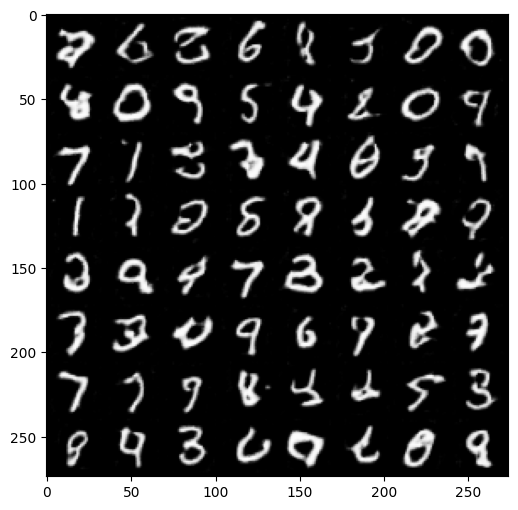

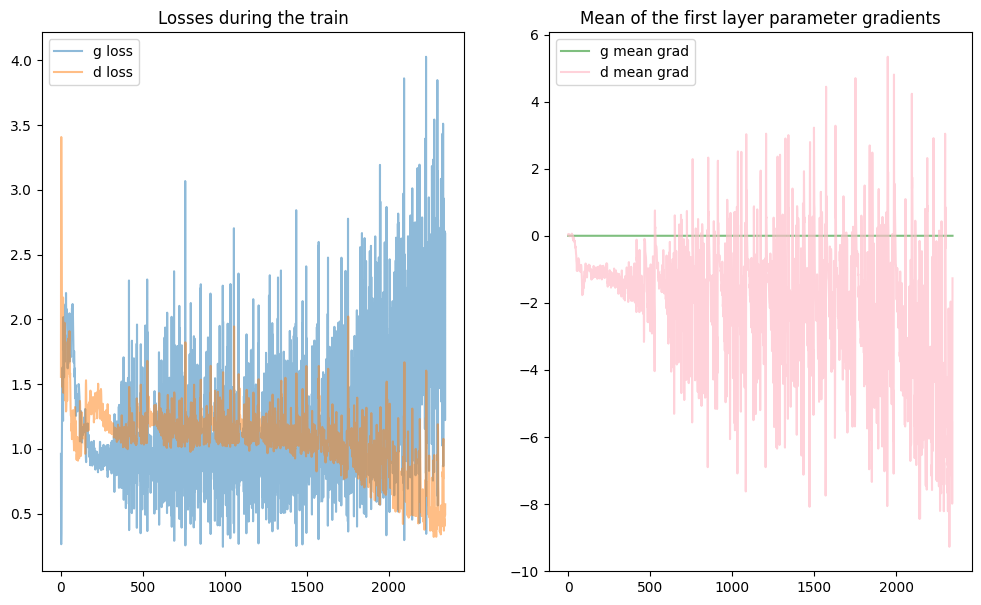

Training complete.


In [ ]:
nz = 100
ngf = 128
ndf = 32

nchannels= 1
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

netD = Discriminator(ndf, nchannels).to(device)
netG = Generator(nz, ngf).to(device)

netD.apply(weights_init)
netG.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))

training(netG,netD,nz,g_opt,d_opt,dataloader,display_freq=200,nb_epochs=5,display_first_last=True)

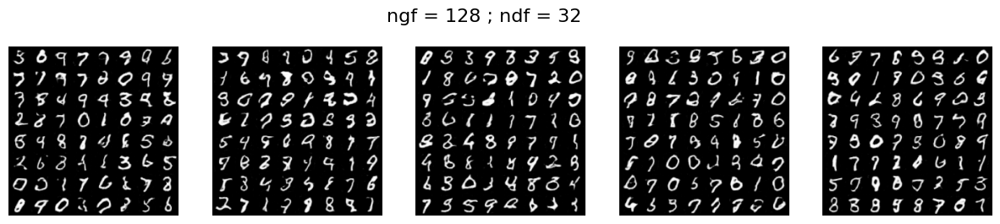

In [ ]:
display_generated_images(netG,NOISES_100,"ngf = 128 ; ndf = 32")

### Lower $ngf$ and lower $ndf$

it: 0; g_loss: 0.5968952775001526; d_loss: 1.5502886772155762; avg_real_score: 0.5015310049057007; avg_fake_score: 0.5701569318771362;
                    g_gradient: [mean,norm,max,min]=(1.5673978850827552e-05, 1.0760446786880493, 0.0284544937312603, -0.027421841397881508);
                    d_gradient: [mean,norm,max,min]=(0.004495508968830109, 2.215702533721924, 0.9683588743209839, -0.4874071776866913)


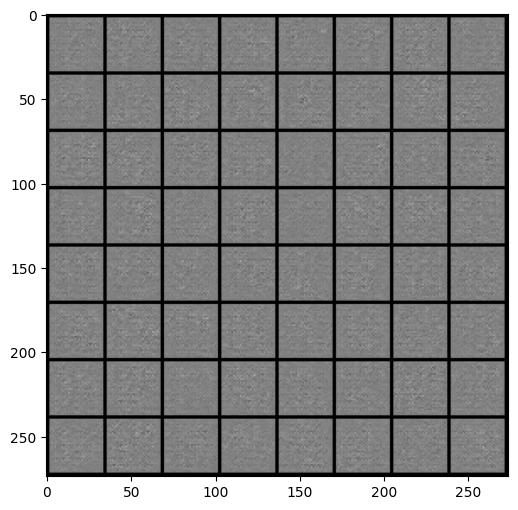

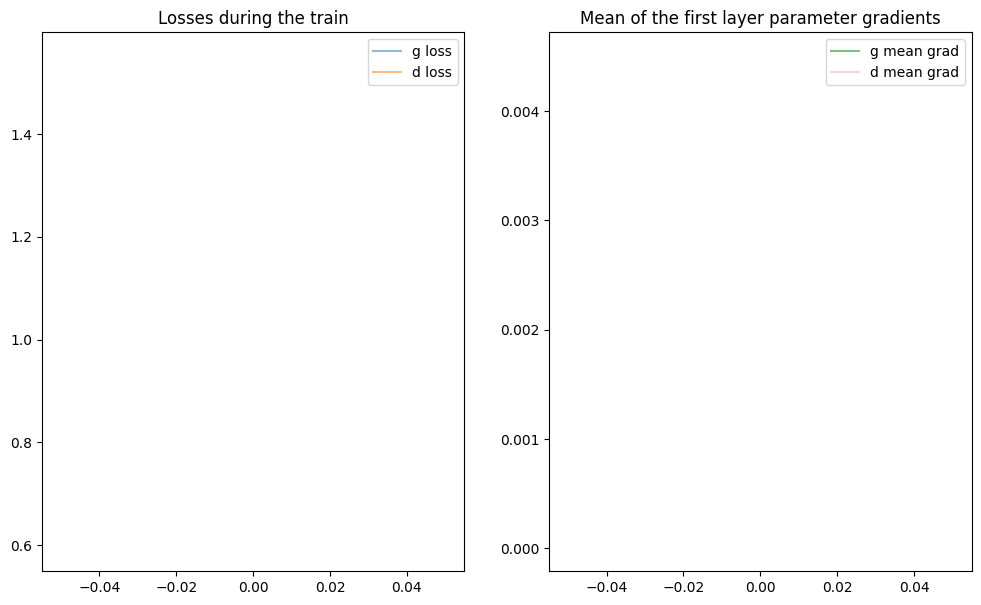

it: 1172; g_loss: 0.7120707631111145; d_loss: 1.0924253463745117; avg_real_score: 0.43774014711380005; avg_fake_score: 0.2004595398902893;
                    g_gradient: [mean,norm,max,min]=(-1.2228554624016397e-05, 2.187939405441284, 0.062146689742803574, -0.07076126337051392);
                    d_gradient: [mean,norm,max,min]=(-37.46404266357422, 1208.3541259765625, 95.39118957519531, -608.9654541015625)


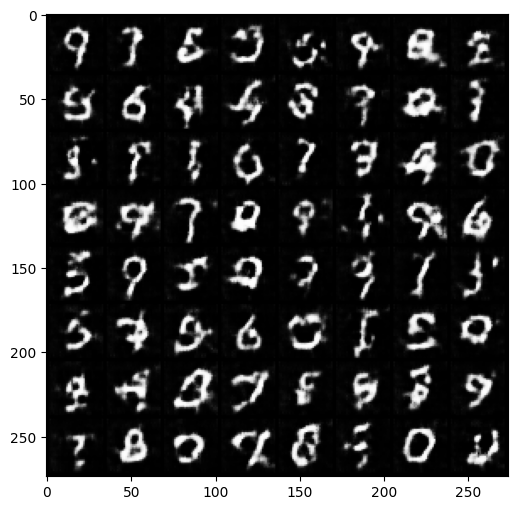

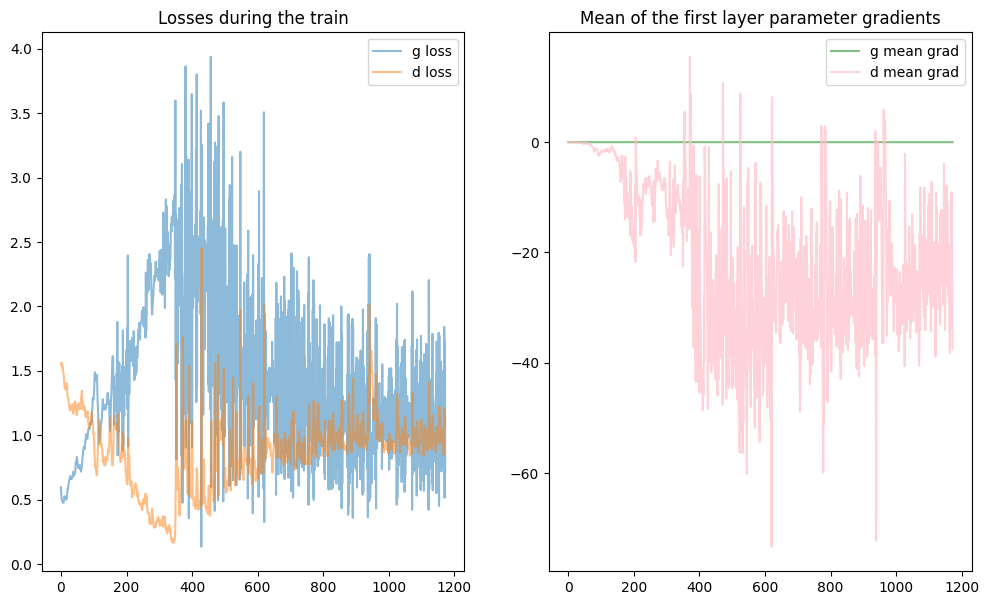

it: 2344; g_loss: 1.476572036743164; d_loss: 0.7655503153800964; avg_real_score: 0.7467650175094604; avg_fake_score: 0.365014910697937;
                    g_gradient: [mean,norm,max,min]=(0.00010987860878231004, 5.541476249694824, 0.24682633578777313, -0.16341567039489746);
                    d_gradient: [mean,norm,max,min]=(-24.150650024414062, 910.6105346679688, 100.48048400878906, -428.84307861328125)


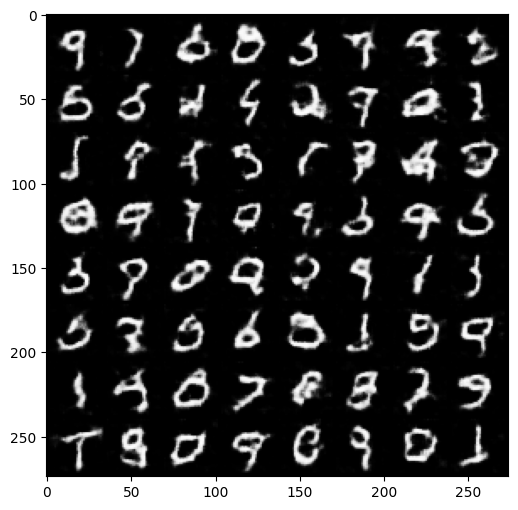

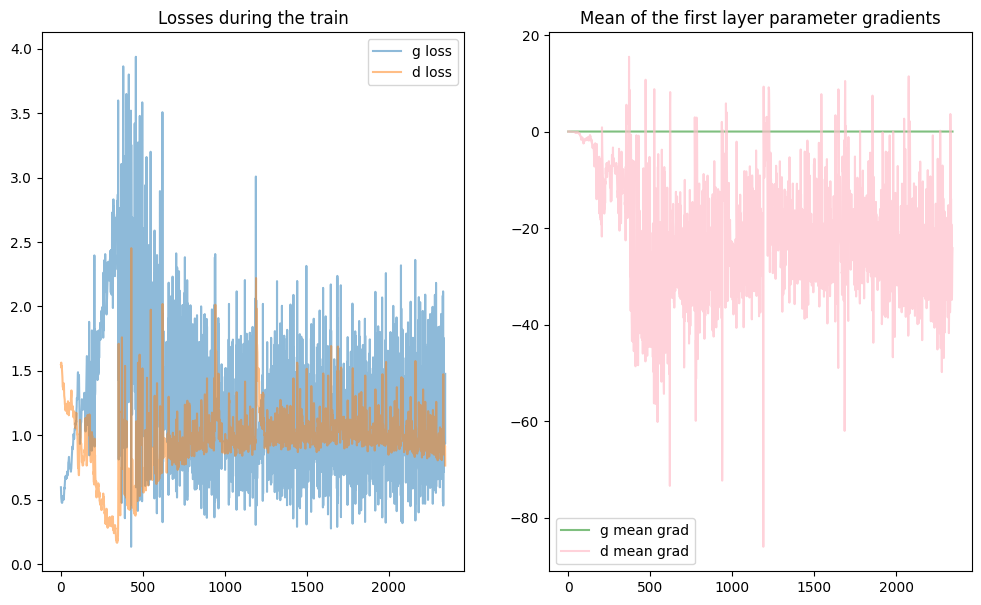

Training complete.


In [ ]:
nz = 100
ngf = 8
ndf = 8

nchannels= 1
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

netD = Discriminator(ndf, nchannels).to(device)
netG = Generator(nz, ngf).to(device)

netD.apply(weights_init)
netG.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))

training(netG,netD,nz,g_opt,d_opt,dataloader,display_freq=200,nb_epochs=5,display_first_last=True)

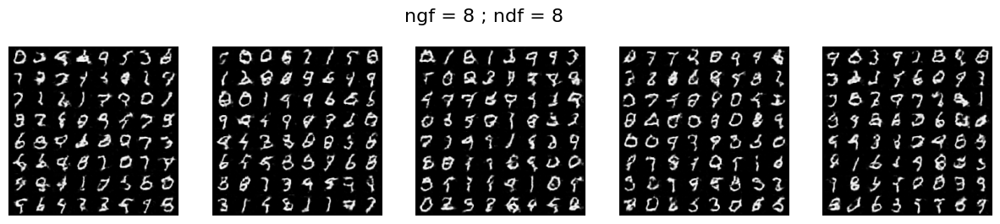

In [ ]:
display_generated_images(netG,NOISES_100,"ngf = 8 ; ndf = 8")

### Lower $ngf$

it: 0; g_loss: 1.5093767642974854; d_loss: 1.5847315788269043; avg_real_score: 0.49045056104660034; avg_fake_score: 0.5137559175491333;
                    g_gradient: [mean,norm,max,min]=(-1.261145735043101e-05, 5.876934051513672, 0.1852523237466812, -0.13725143671035767);
                    d_gradient: [mean,norm,max,min]=(-0.022809991613030434, 11.49169635772705, 1.2701268196105957, -1.6820586919784546)


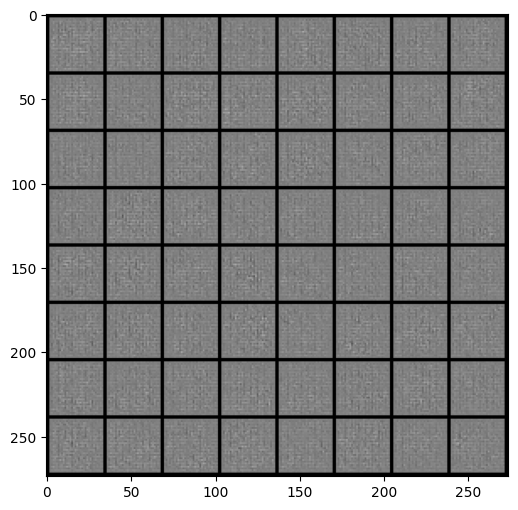

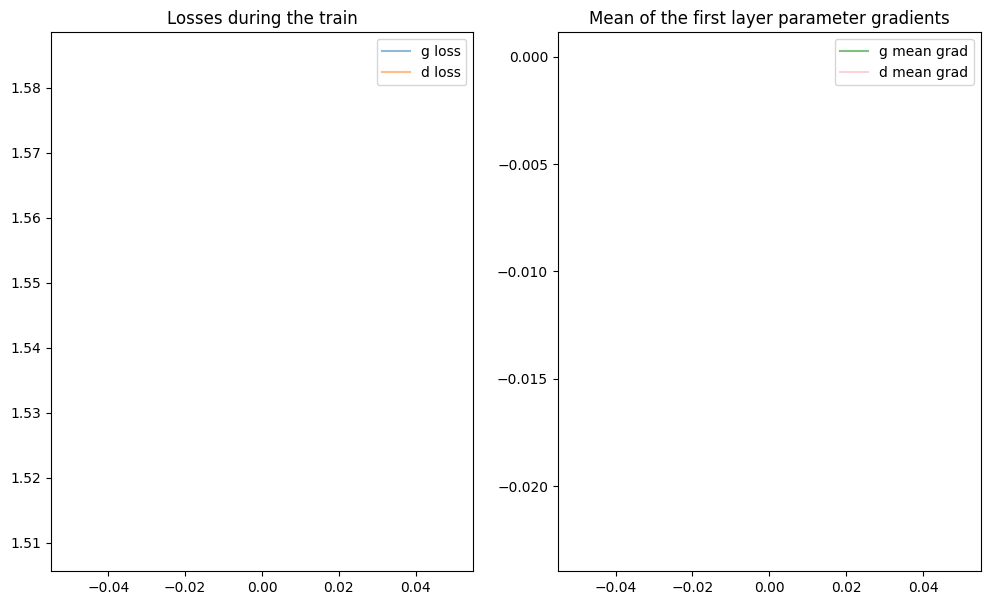

it: 1172; g_loss: 7.341729164123535; d_loss: 0.5898807048797607; avg_real_score: 0.9832022190093994; avg_fake_score: 0.40537405014038086;
                    g_gradient: [mean,norm,max,min]=(0.00011667497165035456, 13.828609466552734, 0.5564737319946289, -0.44410136342048645);
                    d_gradient: [mean,norm,max,min]=(-1.7482084035873413, 222.32528686523438, 32.107887268066406, -42.27859878540039)


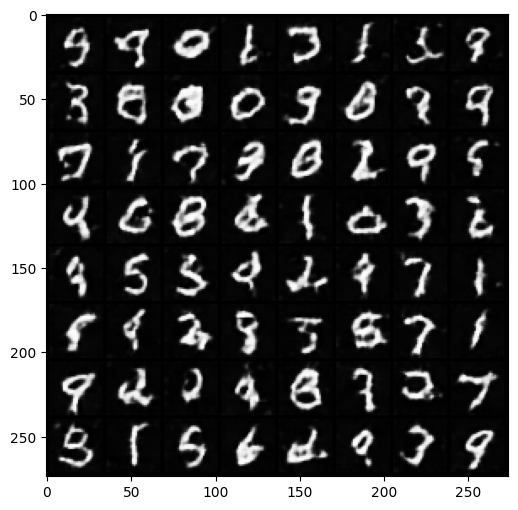

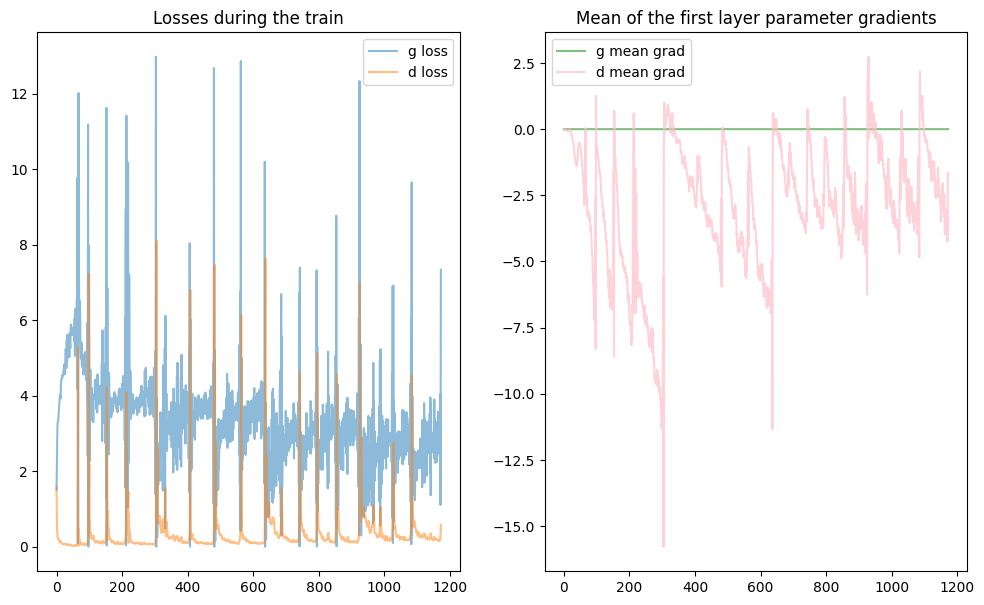

it: 2344; g_loss: 3.6718101501464844; d_loss: 0.10102656483650208; avg_real_score: 0.9574731588363647; avg_fake_score: 0.05181308835744858;
                    g_gradient: [mean,norm,max,min]=(0.00021985355124343187, 20.670900344848633, 0.8846864104270935, -0.7153362035751343);
                    d_gradient: [mean,norm,max,min]=(-2.642828941345215, 284.8943176269531, 41.92805480957031, -53.479400634765625)


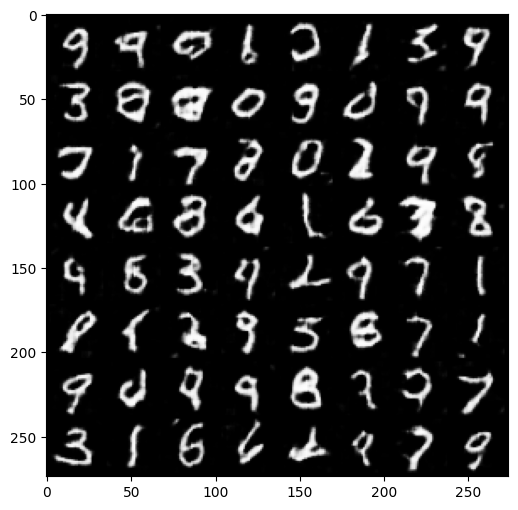

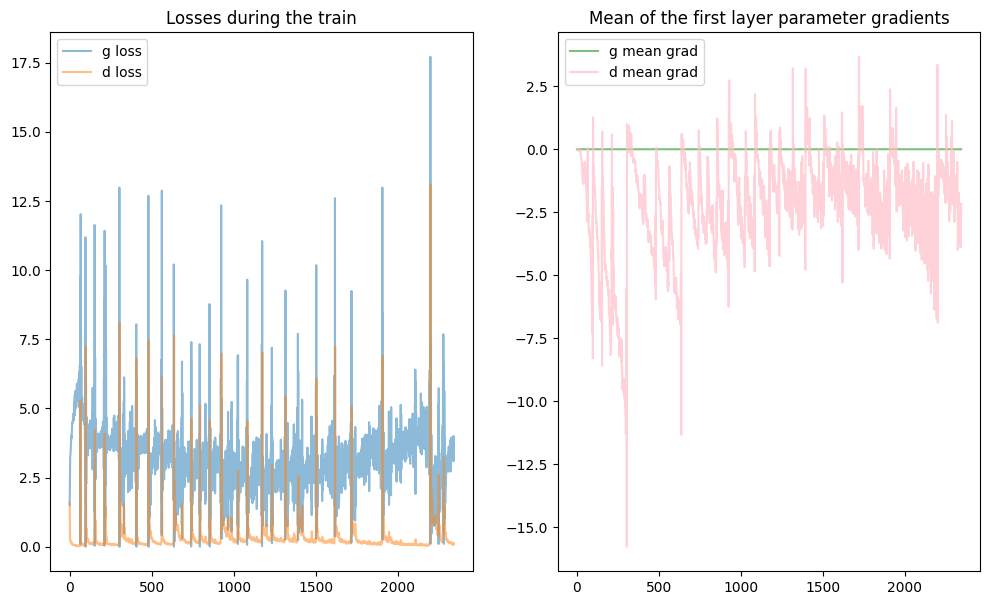

Training complete.


In [ ]:
nz = 100
ngf = 8
ndf = 64

nchannels= 1
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

netD = Discriminator(ndf, nchannels).to(device)
netG = Generator(nz, ngf).to(device)

netD.apply(weights_init)
netG.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))

training(netG,netD,nz,g_opt,d_opt,dataloader,display_freq=200,nb_epochs=5,display_first_last=True)

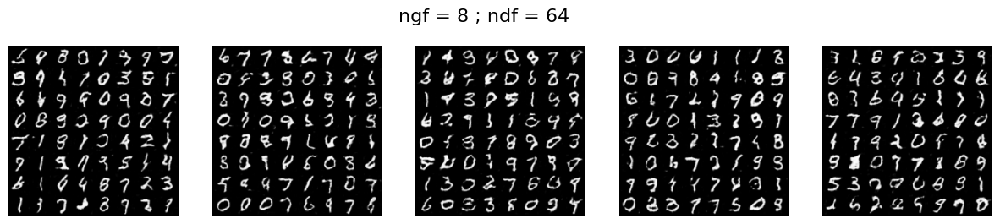

In [ ]:
display_generated_images(netG,NOISES_100,"ngf = 8 ; ndf = 64")

### Lower $ndf$

it: 0; g_loss: 0.6334773302078247; d_loss: 1.5734014511108398; avg_real_score: 0.47627317905426025; avg_fake_score: 0.5537376999855042;
                    g_gradient: [mean,norm,max,min]=(7.718539052348206e-08, 1.2496137619018555, 0.014145985245704651, -0.01516503095626831);
                    d_gradient: [mean,norm,max,min]=(-0.14443519711494446, 7.070902347564697, 1.4650592803955078, -1.6055575609207153)


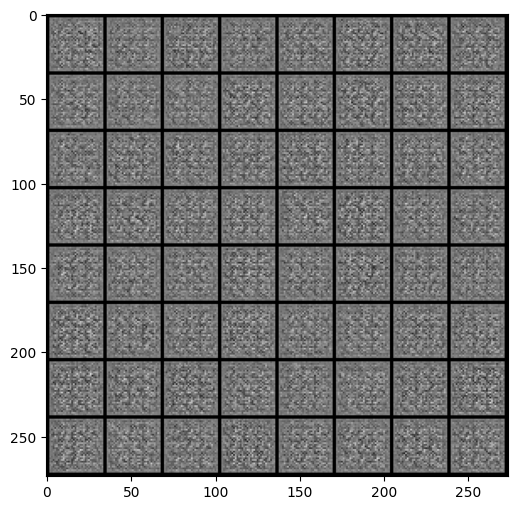

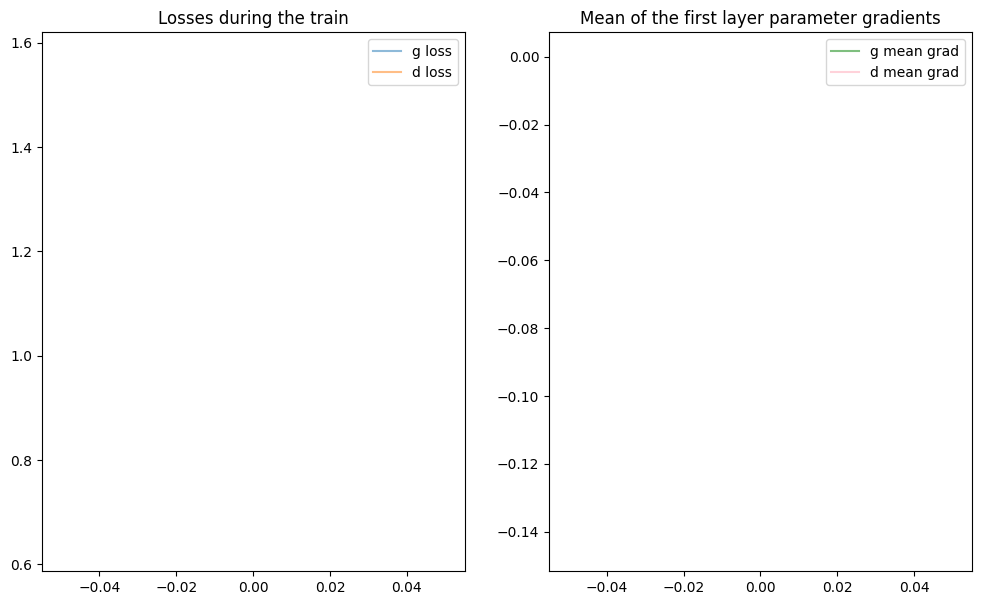

it: 1172; g_loss: 0.821049153804779; d_loss: 1.4042541980743408; avg_real_score: 0.5301020741462708; avg_fake_score: 0.5249462723731995;
                    g_gradient: [mean,norm,max,min]=(1.9628221252787625e-06, 0.22983235120773315, 0.0061294869519770145, -0.007200057618319988);
                    d_gradient: [mean,norm,max,min]=(0.06285181641578674, 21.49064064025879, 6.586333751678467, -5.620236873626709)


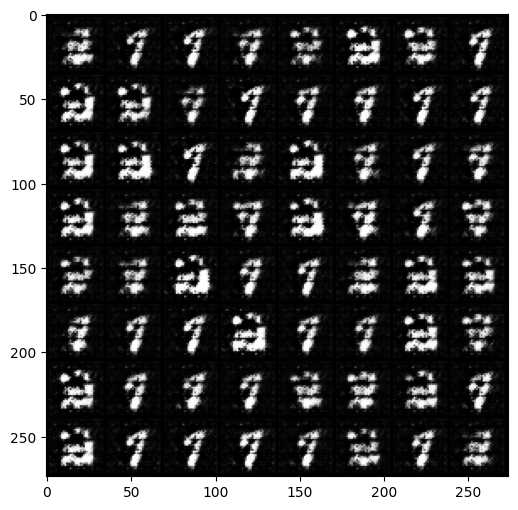

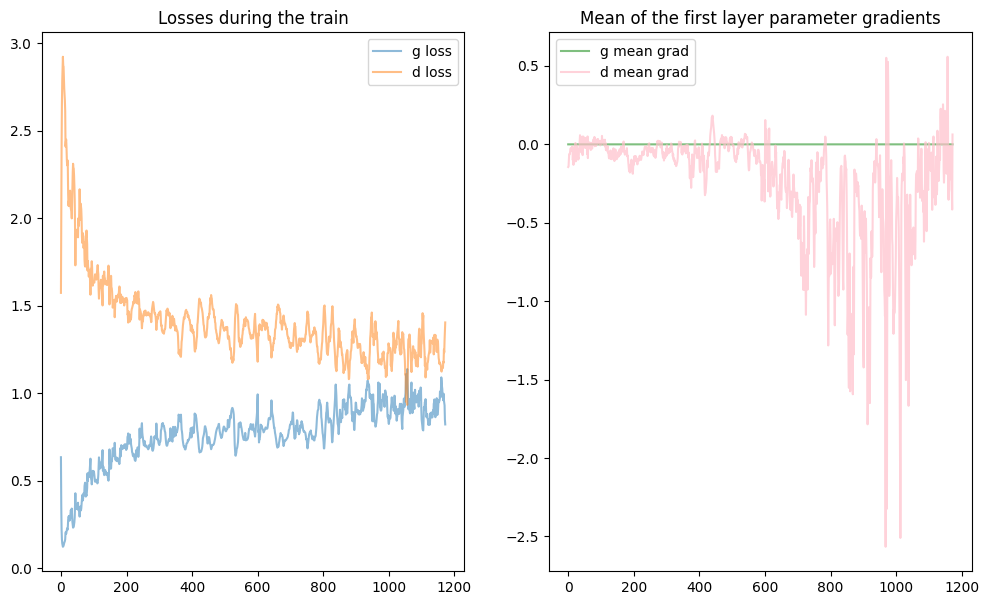

it: 2344; g_loss: 0.7502826452255249; d_loss: 1.2979776859283447; avg_real_score: 0.5052443742752075; avg_fake_score: 0.4532594084739685;
                    g_gradient: [mean,norm,max,min]=(-2.9503623864002293e-06, 0.4991694688796997, 0.007258070167154074, -0.007034905720502138);
                    d_gradient: [mean,norm,max,min]=(-1.7216640710830688, 55.70943069458008, 7.923149108886719, -15.471778869628906)


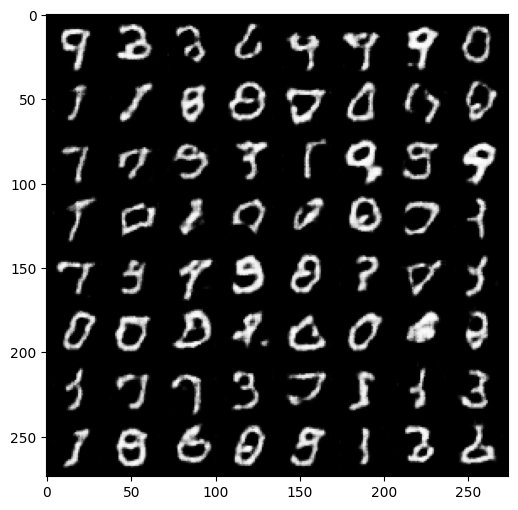

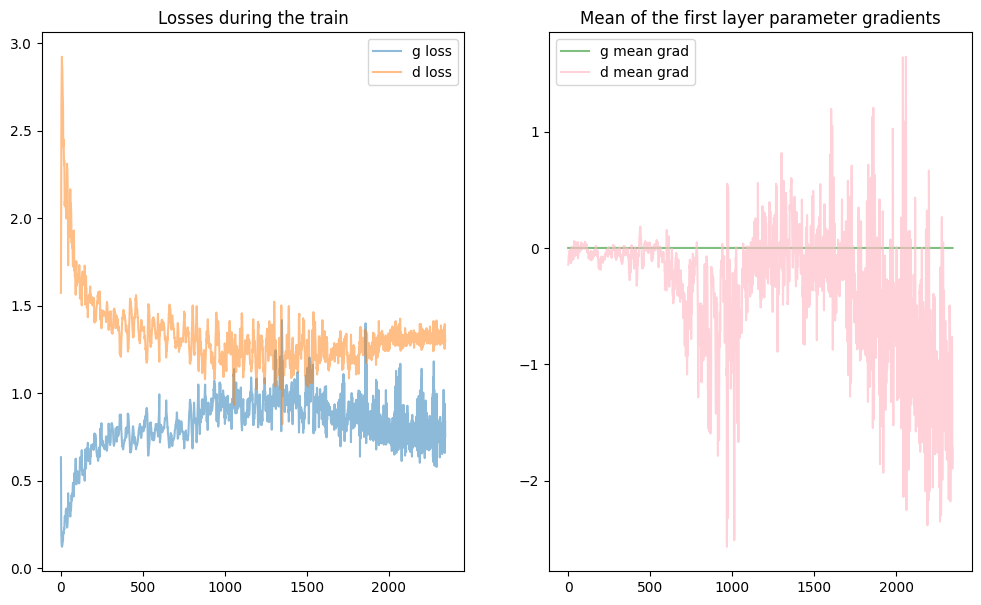

Training complete.


In [ ]:
nz = 100
ngf = 64
ndf = 8

nchannels= 1
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

netD = Discriminator(ndf, nchannels).to(device)
netG = Generator(nz, ngf).to(device)

netD.apply(weights_init)
netG.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))

training(netG,netD,nz,g_opt,d_opt,dataloader,display_freq=200,nb_epochs=5,display_first_last=True)

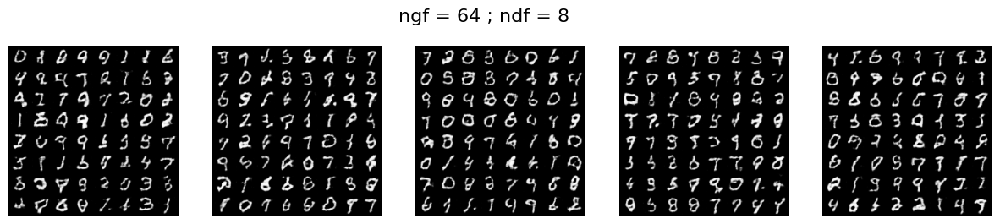

In [ ]:
display_generated_images(netG,NOISES_100,"ngf = 64 ; ndf = 8")

## Initialization

it: 0; g_loss: 0.8755858540534973; d_loss: 1.5880327224731445; avg_real_score: 0.3981780707836151; avg_fake_score: 0.46798139810562134;
                    g_gradient: [mean,norm,max,min]=(2.406135172350332e-05, 3.368225336074829, 0.042351413518190384, -0.05210069194436073);
                    d_gradient: [mean,norm,max,min]=(0.012250012718141079, 1.1226874589920044, 0.1572474241256714, -0.15602701902389526)


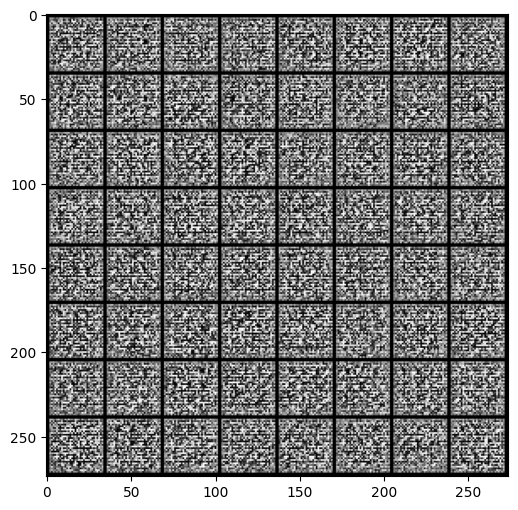

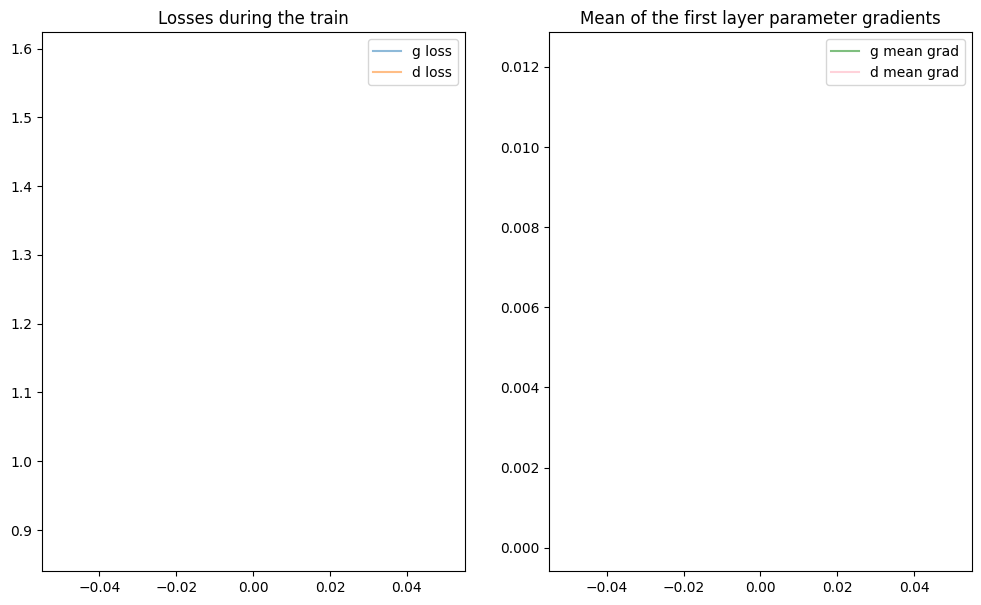

it: 1172; g_loss: 1.6697044372558594; d_loss: 0.4597141146659851; avg_real_score: 0.7763330936431885; avg_fake_score: 0.1729280948638916;
                    g_gradient: [mean,norm,max,min]=(6.102243787609041e-05, 8.38007926940918, 0.1879059374332428, -0.2862681746482849);
                    d_gradient: [mean,norm,max,min]=(-1.6785705089569092, 56.56022644042969, 2.6532254219055176, -10.412391662597656)


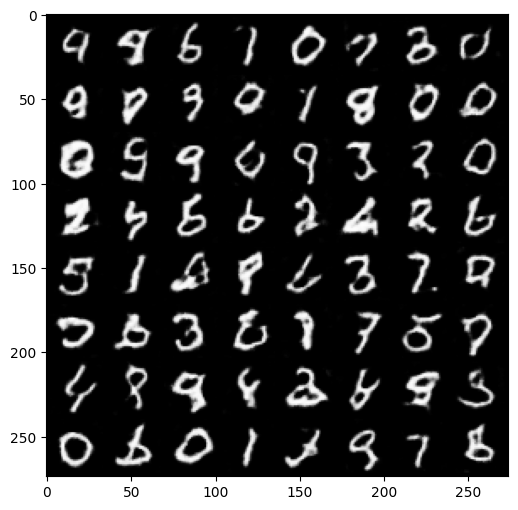

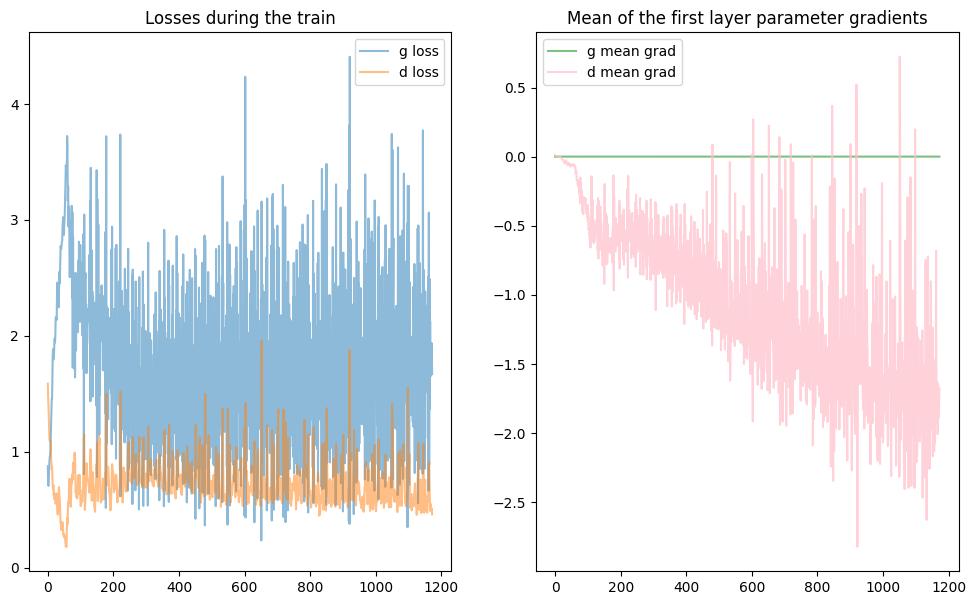

it: 2344; g_loss: 2.4670653343200684; d_loss: 0.26962777972221375; avg_real_score: 0.8994909524917603; avg_fake_score: 0.13835516571998596;
                    g_gradient: [mean,norm,max,min]=(-0.00011851776798721403, 10.695430755615234, 0.24255354702472687, -0.22956620156764984);
                    d_gradient: [mean,norm,max,min]=(-1.8601478338241577, 62.268943786621094, 3.7217555046081543, -13.13440990447998)


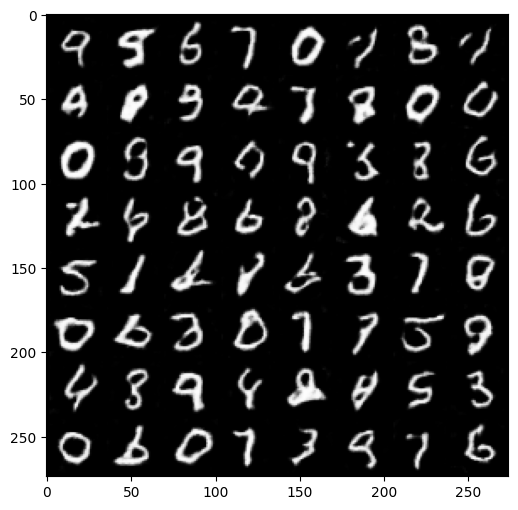

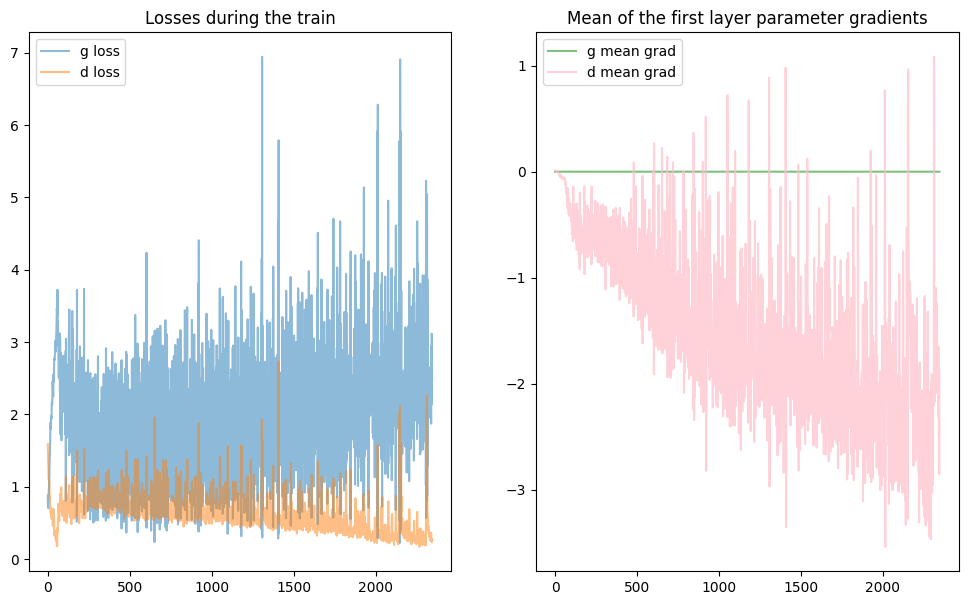

Training complete.


In [ ]:
nz = 100
ngf = 32
ndf = 32

nchannels= 1
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

netD = Discriminator(ndf, nchannels).to(device)
netG = Generator(nz, ngf).to(device)

# default pytorch initialization will be done
# netD.apply(weights_init)
# netG.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))

training(netG,netD,nz,g_opt,d_opt,dataloader,display_freq=200,nb_epochs=5,display_first_last=True)

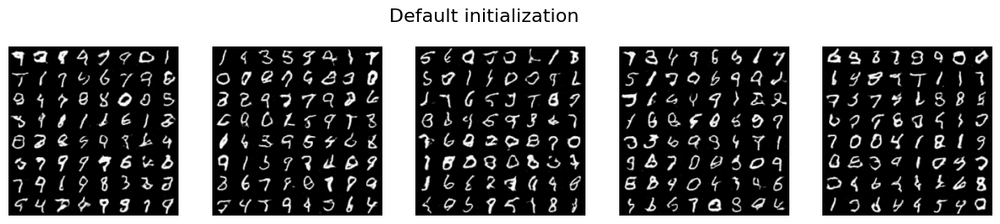

In [ ]:
display_generated_images(netG,NOISES_100,"Default initialization")

## More epochs

  0%|          | 0/30 [00:00<?, ?it/s]

it: 0; g_loss: 1.1622779369354248; d_loss: 1.2617783546447754; avg_real_score: 0.5458738803863525; avg_fake_score: 0.44571471214294434;
                    g_gradient: [mean,norm,max,min]=(3.8126538129290566e-05, 3.7033464908599854, 0.060486290603876114, -0.05301118269562721);
                    d_gradient: [mean,norm,max,min]=(-0.040623195469379425, 7.364071846008301, 1.5089836120605469, -0.9466126561164856)


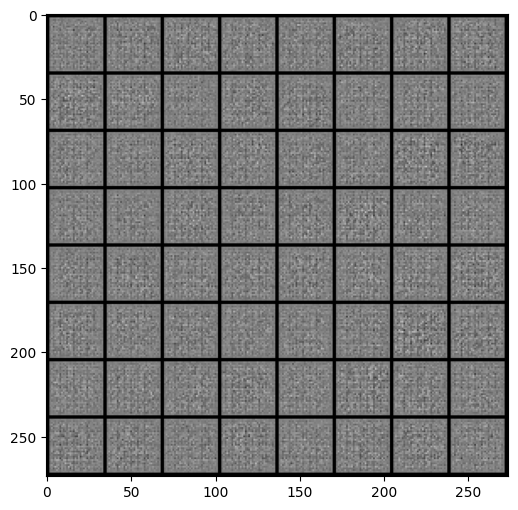

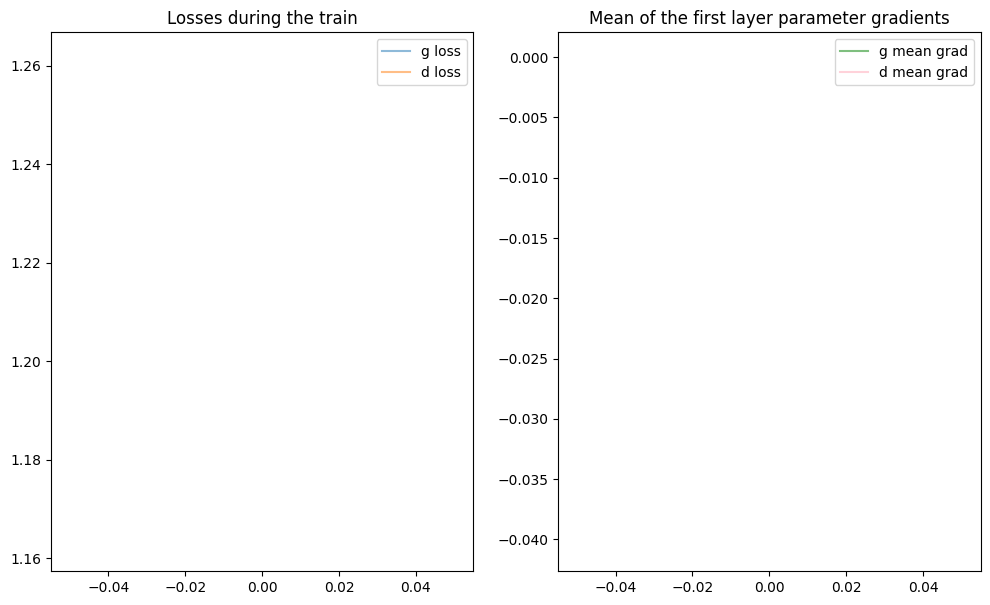

 50%|█████     | 15/30 [06:35<06:33, 26.22s/it]

it: 7035; g_loss: 5.412778377532959; d_loss: 0.020074540749192238; avg_real_score: 0.9939733743667603; avg_fake_score: 0.013644801452755928;
                    g_gradient: [mean,norm,max,min]=(0.00016346714983228594, 16.186031341552734, 0.43957290053367615, -0.5164647698402405);
                    d_gradient: [mean,norm,max,min]=(-14.842416763305664, 633.9043579101562, 105.276611328125, -143.02618408203125)


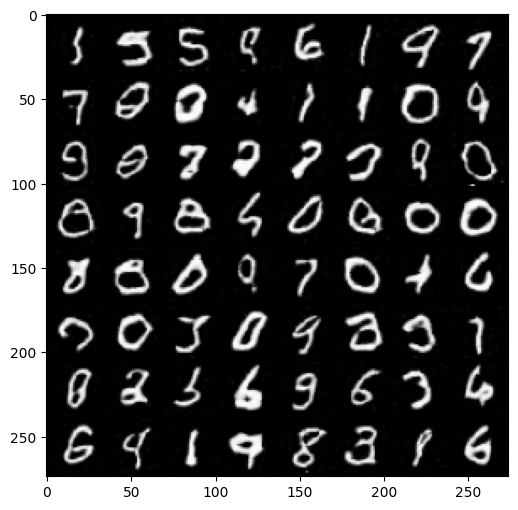

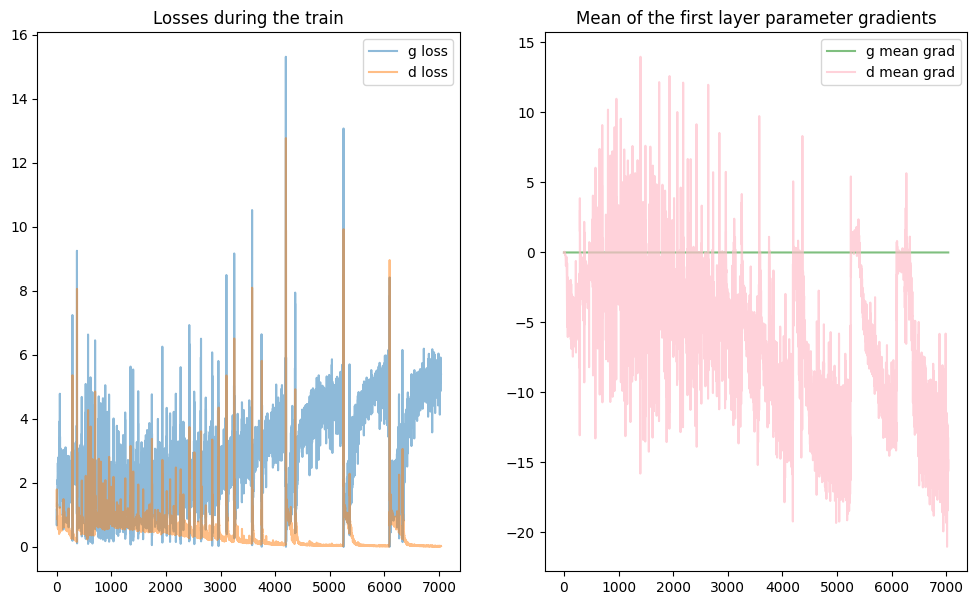

 97%|█████████▋| 29/30 [12:43<00:26, 26.32s/it]

it: 14069; g_loss: 4.598728179931641; d_loss: 0.024927286431193352; avg_real_score: 0.991717517375946; avg_fake_score: 0.016016967594623566;
                    g_gradient: [mean,norm,max,min]=(3.373803338035941e-05, 13.53001594543457, 0.52080237865448, -0.5524454116821289);
                    d_gradient: [mean,norm,max,min]=(-4.7599382400512695, 651.4893798828125, 184.38668823242188, -132.7154083251953)


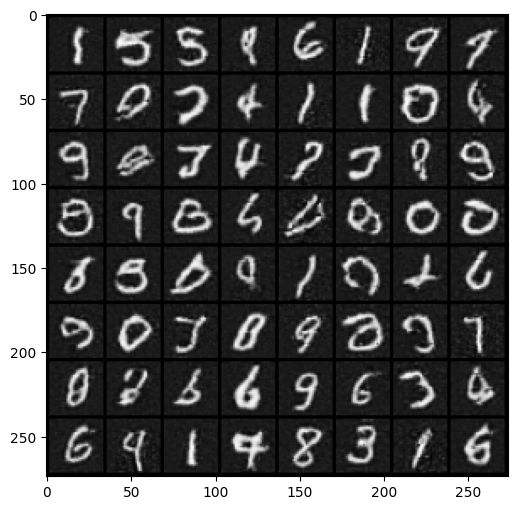

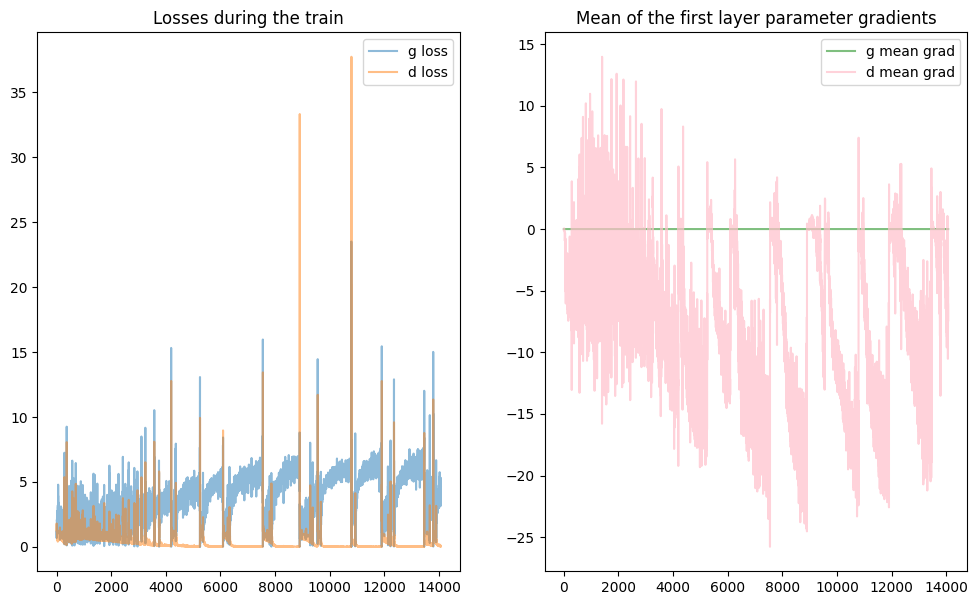

100%|██████████| 30/30 [13:10<00:00, 26.36s/it]

Training complete.


In [ ]:
nz = 100
ngf = 32
ndf = 32

nchannels= 1
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

netD = Discriminator(ndf, nchannels).to(device)
netG = Generator(nz, ngf).to(device)

# default pytorch initialization will be done
netD.apply(weights_init)
netG.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))

training(netG,netD,nz,g_opt,d_opt,dataloader,display_freq=200,nb_epochs=30,display_first_last=True)

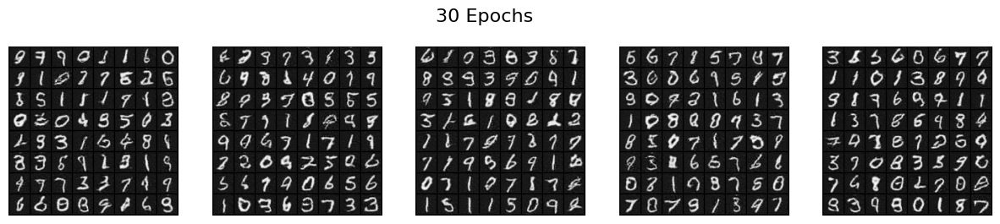

In [ ]:
display_generated_images(netG,NOISES_100,"30 Epochs")

The digits become sharper !!!

## Dimensionality of the initial noise

  0%|          | 0/5 [00:00<?, ?it/s]

it: 0; g_loss: 1.1530957221984863; d_loss: 1.2651770114898682; avg_real_score: 0.5297353267669678; avg_fake_score: 0.44540244340896606;
                    g_gradient: [mean,norm,max,min]=(-0.0002270783152198419, 5.133942604064941, 0.23491604626178741, -0.196238175034523);
                    d_gradient: [mean,norm,max,min]=(0.006462715100497007, 6.832341194152832, 0.871539831161499, -1.2995117902755737)


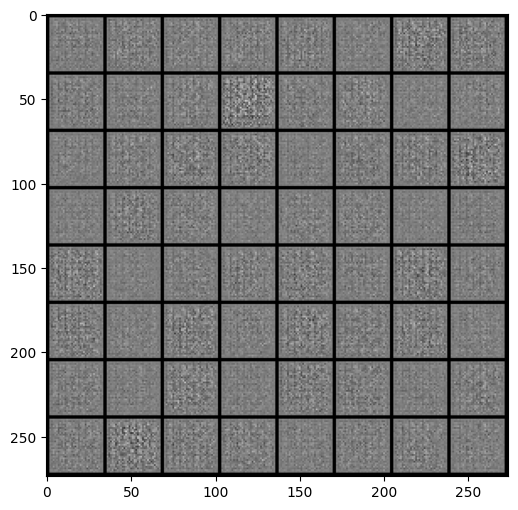

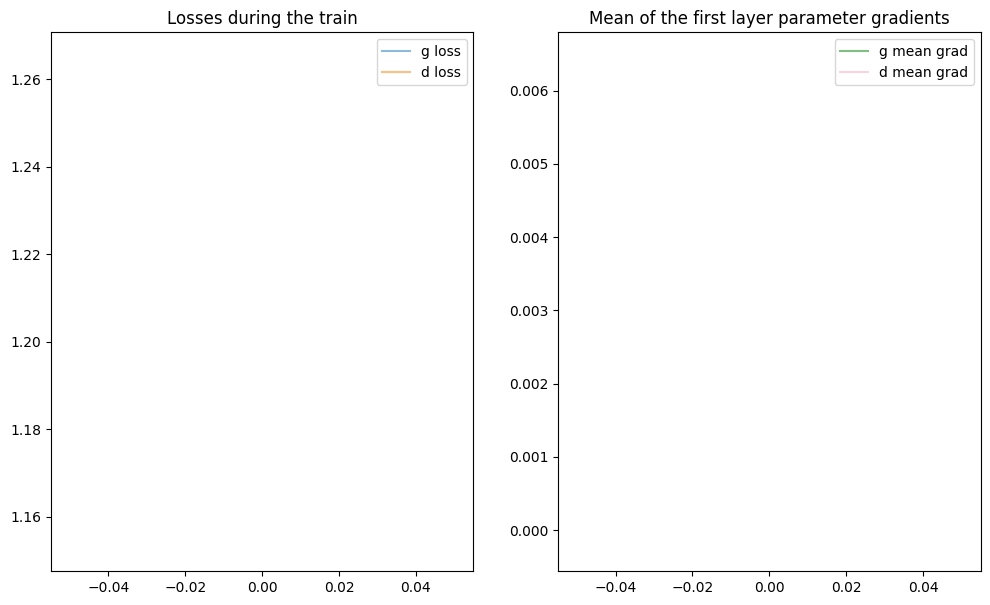

 40%|████      | 2/5 [01:02<01:34, 31.48s/it]

it: 1172; g_loss: 1.0271978378295898; d_loss: 0.7401630878448486; avg_real_score: 0.6311558485031128; avg_fake_score: 0.22444701194763184;
                    g_gradient: [mean,norm,max,min]=(-3.501150058582425e-05, 4.056387424468994, 0.24350859224796295, -0.19226567447185516);
                    d_gradient: [mean,norm,max,min]=(-7.032108306884766, 314.1013488769531, 43.40125274658203, -79.43923950195312)


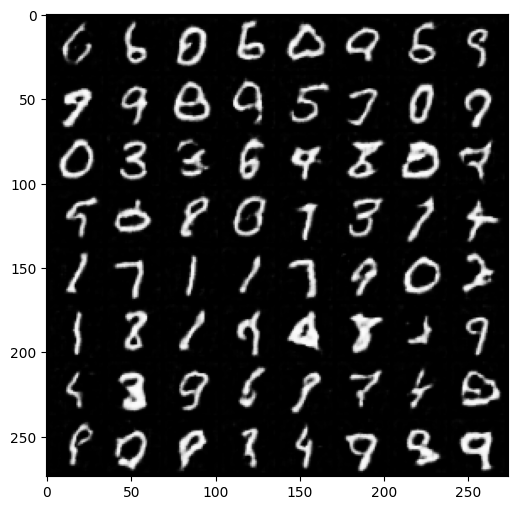

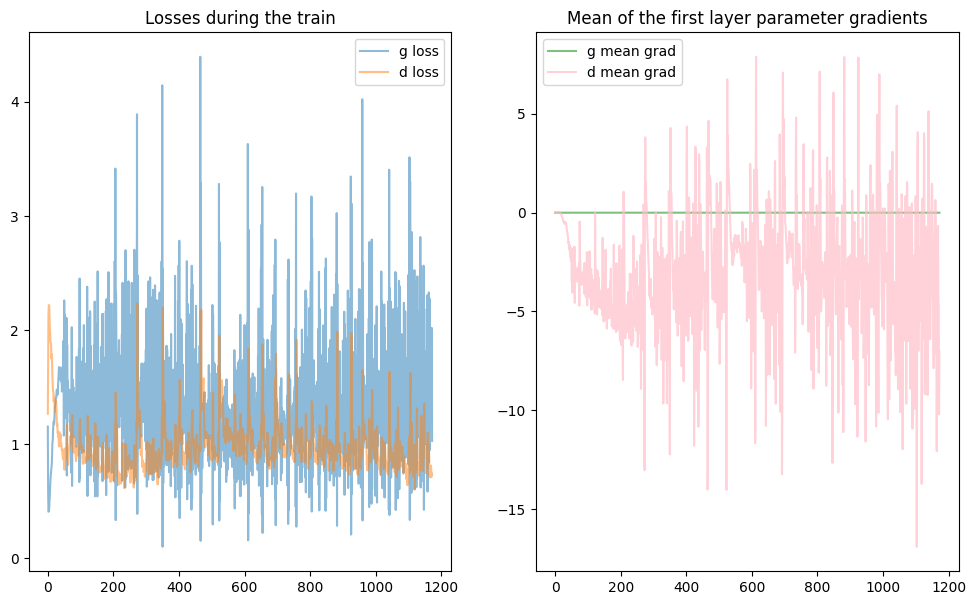

 80%|████████  | 4/5 [01:57<00:28, 28.63s/it]

it: 2344; g_loss: 3.303279399871826; d_loss: 0.28178614377975464; avg_real_score: 0.8543407320976257; avg_fake_score: 0.10706770420074463;
                    g_gradient: [mean,norm,max,min]=(8.505052392138168e-05, 10.122058868408203, 0.4769391715526581, -0.592221200466156);
                    d_gradient: [mean,norm,max,min]=(-4.140030384063721, 598.8093872070312, 186.7427520751953, -152.90274047851562)


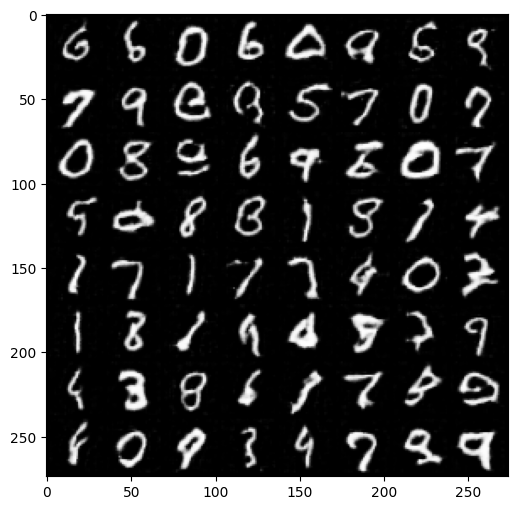

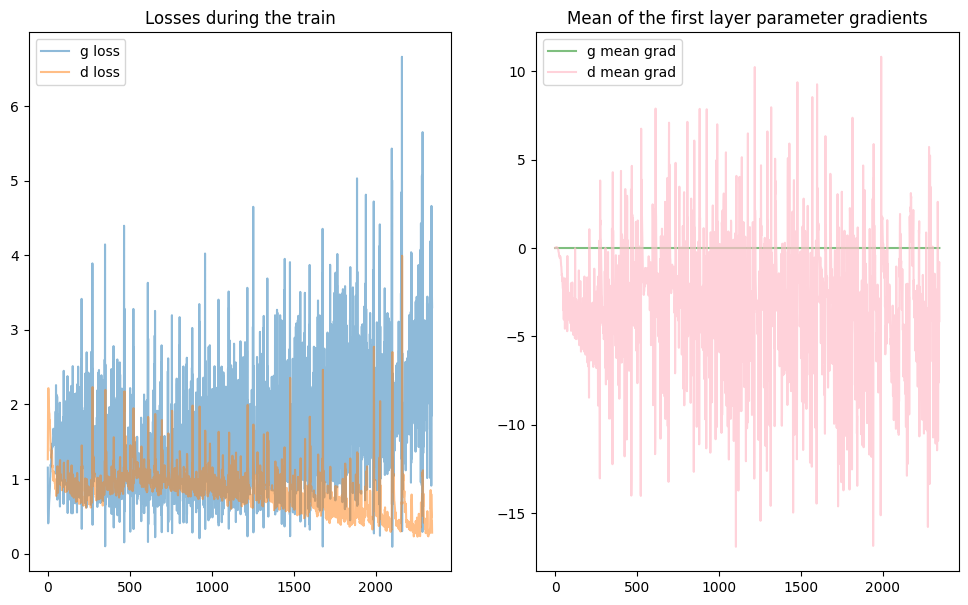

100%|██████████| 5/5 [02:25<00:00, 29.03s/it]

Training complete.


In [ ]:
nz = 10
ngf = 32
ndf = 32

nchannels= 1
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

netD = Discriminator(ndf, nchannels).to(device)
netG = Generator(nz, ngf).to(device)

# default pytorch initialization will be done
netD.apply(weights_init)
netG.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))

training(netG,netD,nz,g_opt,d_opt,dataloader,display_freq=200,nb_epochs=5,display_first_last=True)

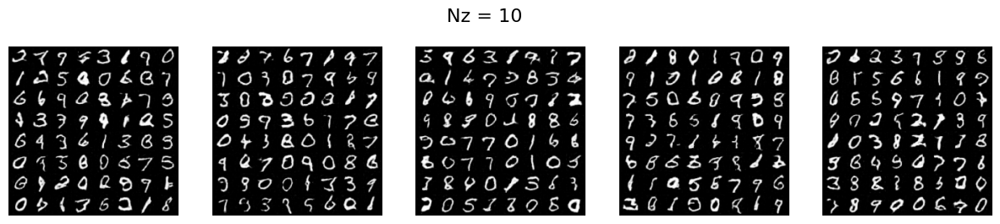

In [ ]:
display_generated_images(netG,NOISES_10,"Nz = 10")

  0%|          | 0/5 [00:00<?, ?it/s]

it: 0; g_loss: 1.2319366931915283; d_loss: 1.4750027656555176; avg_real_score: 0.3699655532836914; avg_fake_score: 0.3417661786079407;
                    g_gradient: [mean,norm,max,min]=(-3.715799437031819e-07, 3.505769729614258, 0.01982007920742035, -0.018101032823324203);
                    d_gradient: [mean,norm,max,min]=(0.007142707705497742, 10.354120254516602, 1.2834739685058594, -1.5700547695159912)


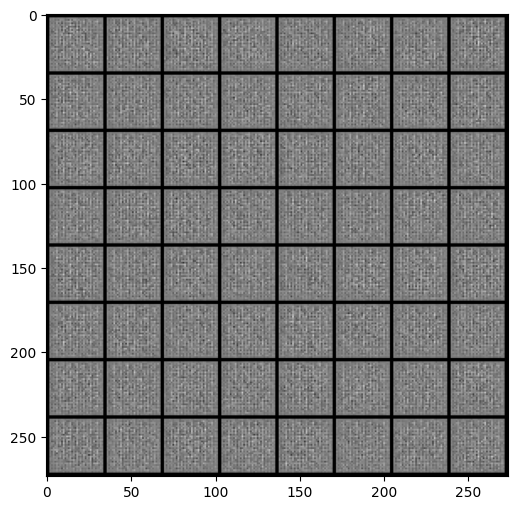

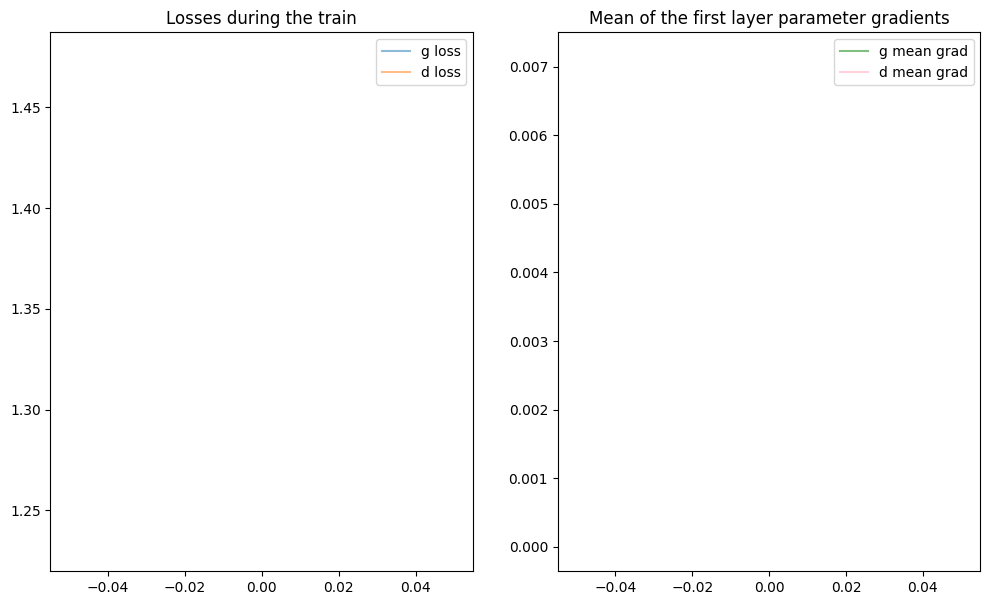

 40%|████      | 2/5 [01:01<01:31, 30.53s/it]

it: 1172; g_loss: 3.213569164276123; d_loss: 0.6482519507408142; avg_real_score: 0.9729692935943604; avg_fake_score: 0.4402299225330353;
                    g_gradient: [mean,norm,max,min]=(9.669181054050568e-06, 11.06680679321289, 0.1265445500612259, -0.14769364893436432);
                    d_gradient: [mean,norm,max,min]=(-1.293884038925171, 173.89646911621094, 23.13528823852539, -69.98159790039062)


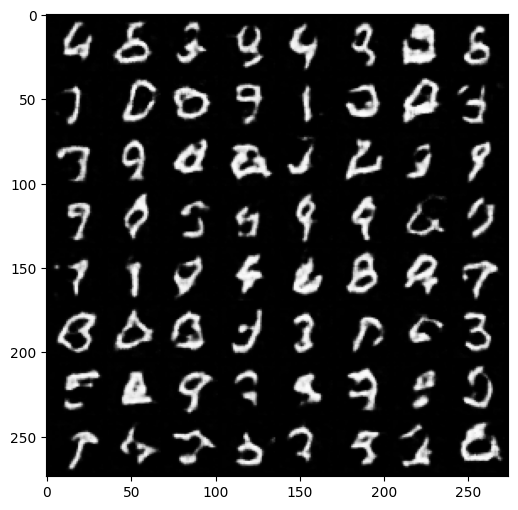

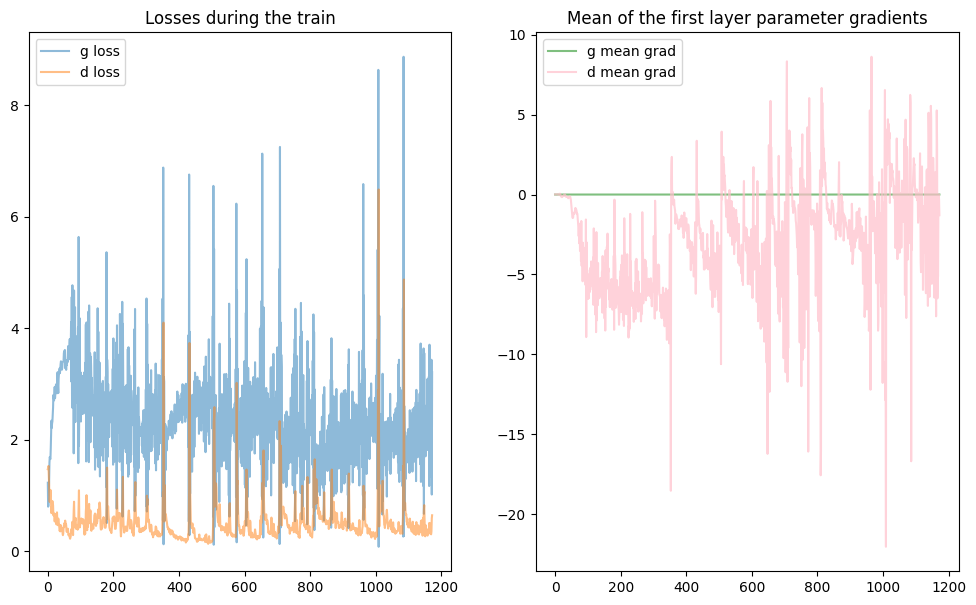

 80%|████████  | 4/5 [02:02<00:30, 30.51s/it]

it: 2344; g_loss: 2.696887493133545; d_loss: 0.39263391494750977; avg_real_score: 0.9241048097610474; avg_fake_score: 0.25480735301971436;
                    g_gradient: [mean,norm,max,min]=(-4.2896719065765865e-08, 10.901687622070312, 0.15046702325344086, -0.1407081037759781);
                    d_gradient: [mean,norm,max,min]=(-1.4944442510604858, 258.0599365234375, 73.03934478759766, -64.30355072021484)


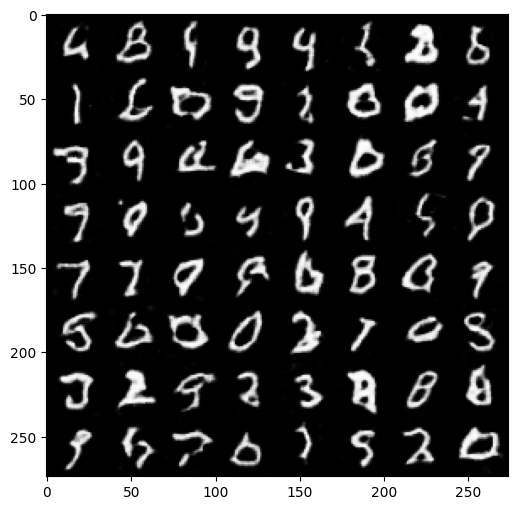

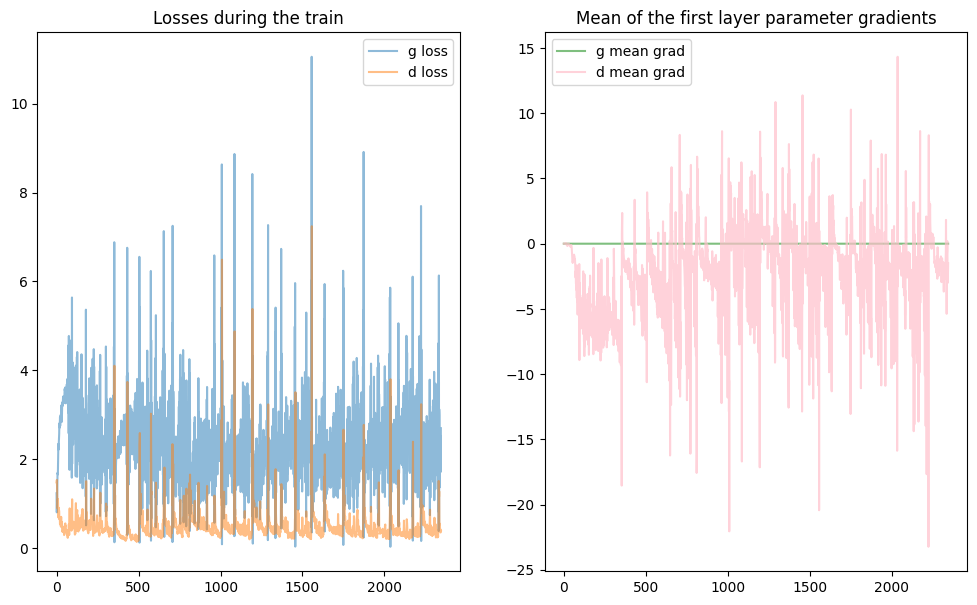

100%|██████████| 5/5 [02:33<00:00, 30.77s/it]

Training complete.


In [ ]:
nz = 1000
ngf = 32
ndf = 32

nchannels= 1
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

netD = Discriminator(ndf, nchannels).to(device)
netG = Generator(nz, ngf).to(device)

# default pytorch initialization will be done
netD.apply(weights_init)
netG.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))

training(netG,netD,nz,g_opt,d_opt,dataloader,display_freq=200,nb_epochs=5,display_first_last=True)

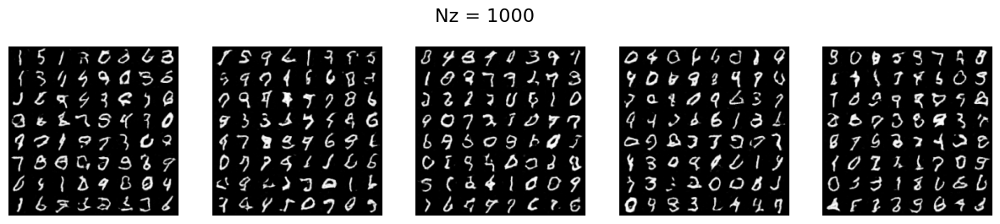

In [ ]:
display_generated_images(netG,NOISES_1000,"Nz = 1000")

## Linear interpolations on noise

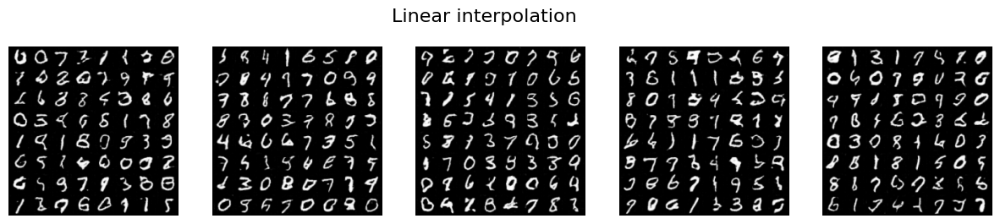

In [ ]:
# already trained  --> basic_netG
display_generated_images(basic_netG,NOISES_100,"Linear interpolation",interpolation=True)

## CIFAR-10 Dataset

In [22]:
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

# Download and load the CIFAR-10 training dataset
cifar10_dataset = torchvision.datasets.CIFAR10(root='./data', train=True, download=True, transform=transform)

batch_size = 128
cifar10_loader = torch.utils.data.DataLoader(cifar10_dataset, batch_size=batch_size, shuffle=True, num_workers=2)

100%|██████████| 170498071/170498071 [00:12<00:00, 13641364.40it/s]


Extracting ./data/cifar-10-python.tar.gz to ./data


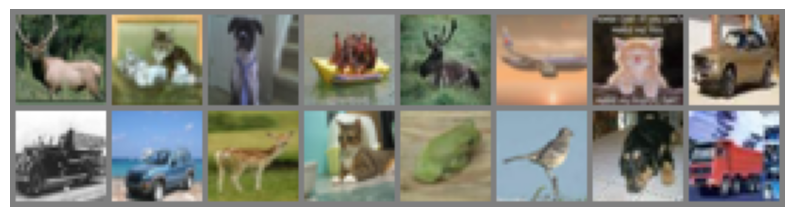

In [ ]:
import numpy as np
def imshowCIFAR10(img):
    img = img / 2 + 0.5  # Denormalization
    npimg = img.numpy()
    npimg = np.clip(npimg, 0, 1)
    plt.imshow(np.transpose(npimg, (1, 2, 0)))
    plt.axis('off')
    plt.show()

images, labels = next(iter(cifar10_loader))
imshowCIFAR10(torchvision.utils.make_grid(images[:16]))

  0%|          | 0/20 [00:00<?, ?it/s]

it: 0; g_loss: 1.2881853580474854; d_loss: 1.436563491821289; avg_real_score: 0.42836564779281616; avg_fake_score: 0.4040724039077759;
                    g_gradient: [mean,norm,max,min]=(-7.746351684545516e-07, 3.5268259048461914, 0.015852367505431175, -0.018139513209462166);
                    d_gradient: [mean,norm,max,min]=(0.004117091652005911, 4.528990745544434, 0.4412727355957031, -0.42019176483154297)


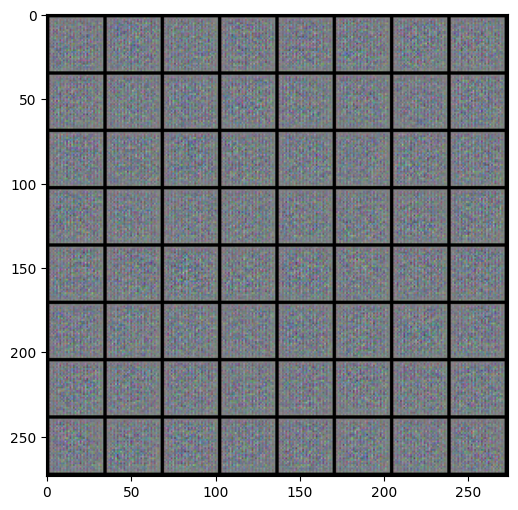

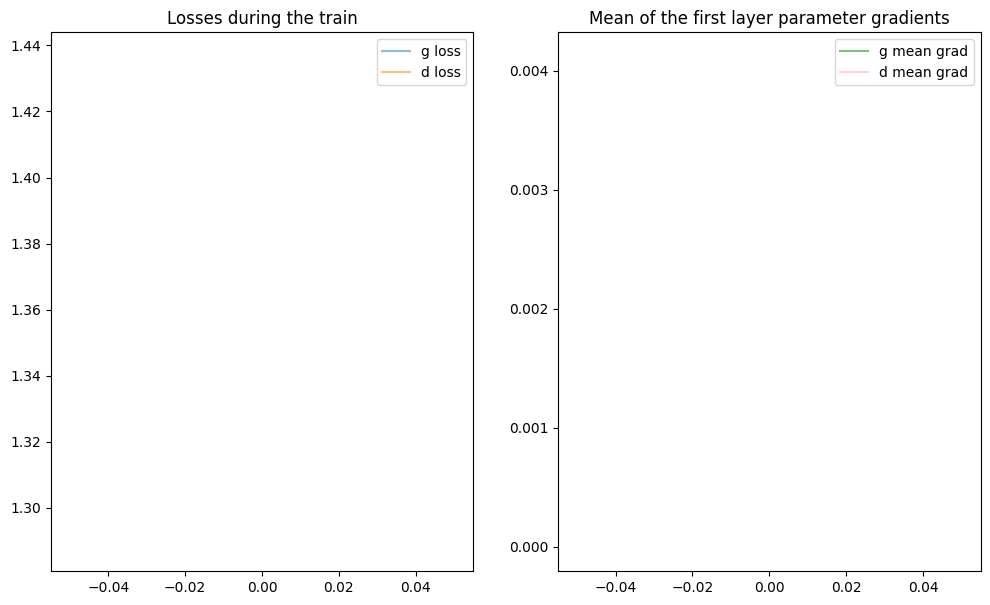

 50%|█████     | 10/20 [03:08<03:04, 18.43s/it]

it: 3910; g_loss: 1.7036387920379639; d_loss: 0.7787531018257141; avg_real_score: 0.7345329523086548; avg_fake_score: 0.3451797664165497;
                    g_gradient: [mean,norm,max,min]=(3.646725872386014e-06, 3.4726216793060303, 0.03479602187871933, -0.04041029512882233);
                    d_gradient: [mean,norm,max,min]=(-0.005911745131015778, 83.4886703491211, 4.757131576538086, -14.814498901367188)


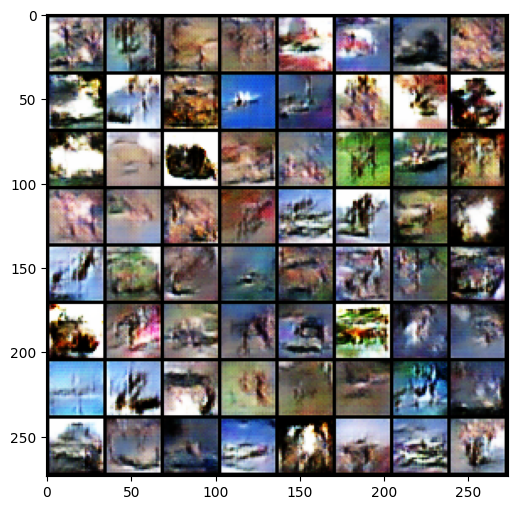

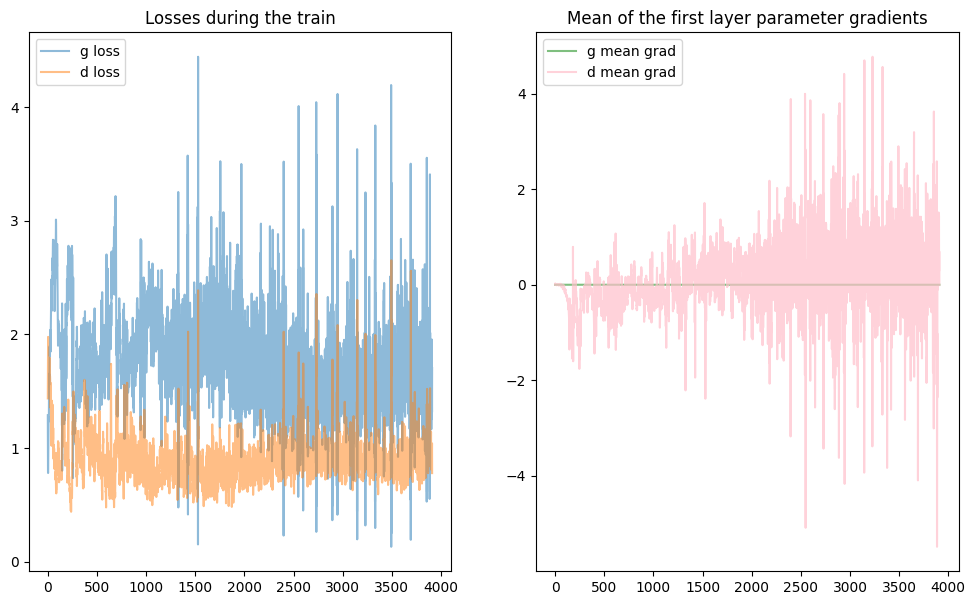

 95%|█████████▌| 19/20 [05:53<00:18, 18.52s/it]

it: 7819; g_loss: 1.4300259351730347; d_loss: 0.7073911428451538; avg_real_score: 0.6830460429191589; avg_fake_score: 0.23496972024440765;
                    g_gradient: [mean,norm,max,min]=(-2.721992871101975e-07, 5.301647663116455, 0.045277178287506104, -0.04633968323469162);
                    d_gradient: [mean,norm,max,min]=(0.4370177686214447, 134.23805236816406, 11.074821472167969, -10.355036735534668)


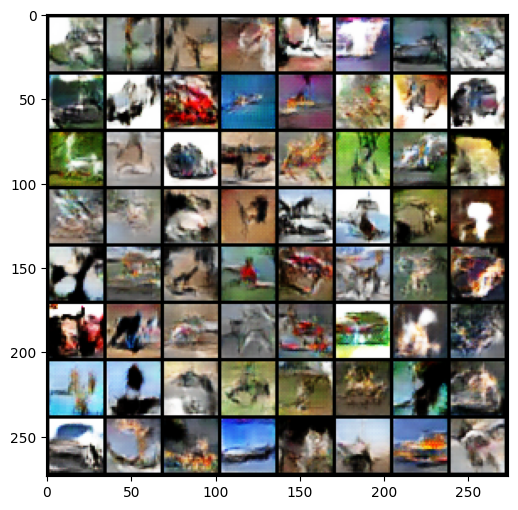

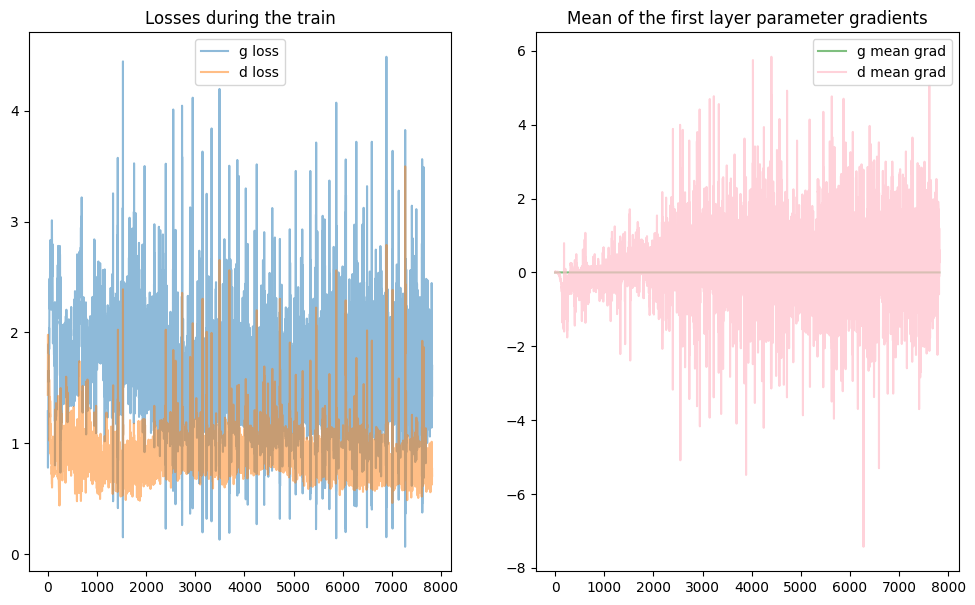

100%|██████████| 20/20 [06:13<00:00, 18.68s/it]

Training complete.


In [ ]:
nz = 1000
ngf = 32
ndf = 32

nchannels= 3
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

cifar10_netD = Discriminator(ndf, nchannels).to(device)
cifar10_netG = Generator(nz, ngf,nchannels).to(device)

cifar10_netD.apply(weights_init)
cifar10_netG.apply(weights_init)

g_opt = torch.optim.Adam(cifar10_netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(cifar10_netD.parameters(), lr=lr_d, betas=(beta1, 0.999))

training(cifar10_netG,cifar10_netD,nz,g_opt,d_opt,cifar10_loader,display_freq=200,nb_epochs=20,display_first_last=True)

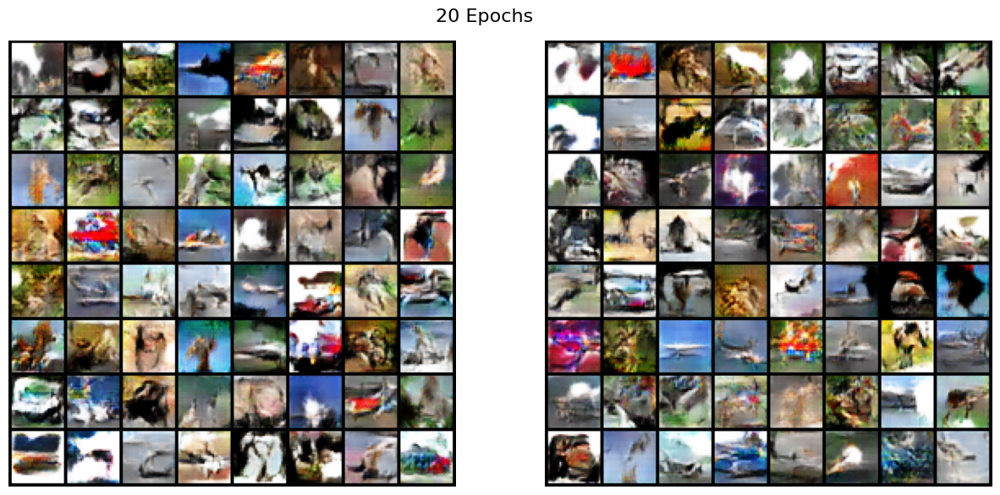

In [ ]:
display_generated_images(cifar10_netG,NOISES_1000_CIFAR,"20 Epochs",nz=1000,times=2)

  0%|          | 0/50 [00:00<?, ?it/s]

it: 0; g_loss: 1.0212358236312866; d_loss: 1.4795210361480713; avg_real_score: 0.5811488628387451; avg_fake_score: 0.5780338048934937;
                    g_gradient: [mean,norm,max,min]=(-1.2270812703718548e-06, 3.201256513595581, 0.016521934419870377, -0.014268697239458561);
                    d_gradient: [mean,norm,max,min]=(-0.012562534771859646, 3.4698548316955566, 0.2973945140838623, -0.36937612295150757)


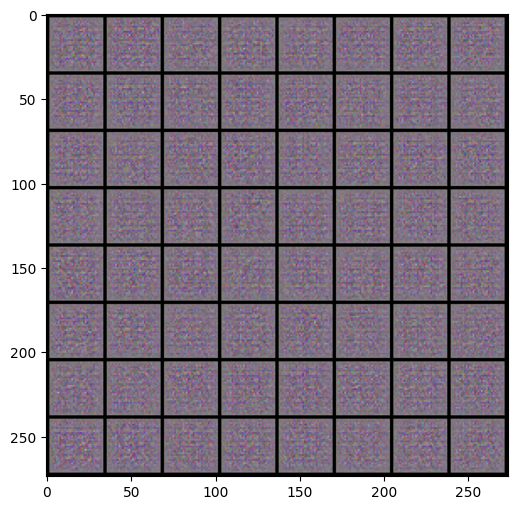

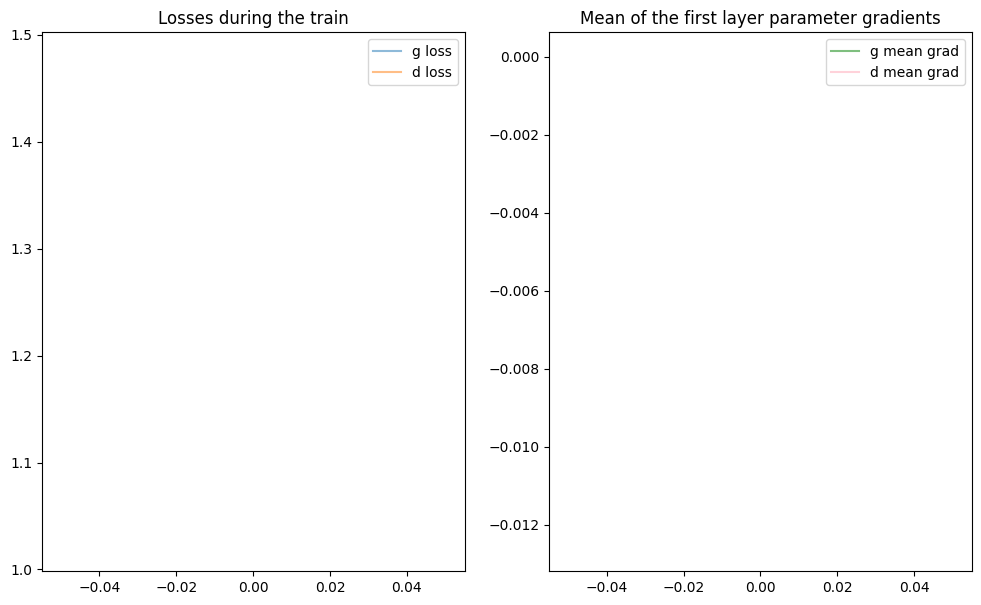

 50%|█████     | 25/50 [07:47<07:34, 18.18s/it]

it: 9775; g_loss: 2.0145764350891113; d_loss: 0.7660839557647705; avg_real_score: 0.7621070742607117; avg_fake_score: 0.34307384490966797;
                    g_gradient: [mean,norm,max,min]=(-1.2897370424980181e-06, 5.1363043785095215, 0.056051116436719894, -0.05281069502234459);
                    d_gradient: [mean,norm,max,min]=(-0.7612364292144775, 144.81092834472656, 15.794302940368652, -13.15399169921875)


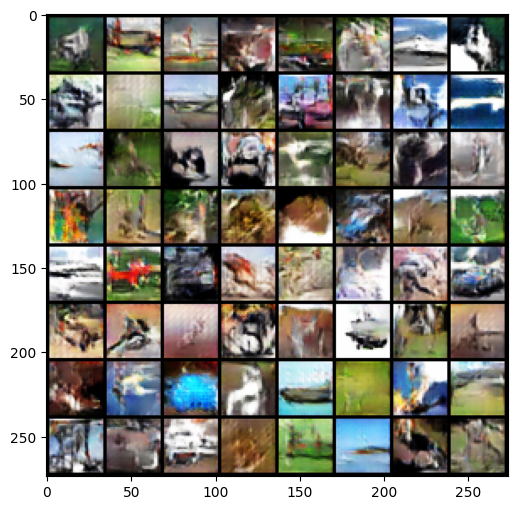

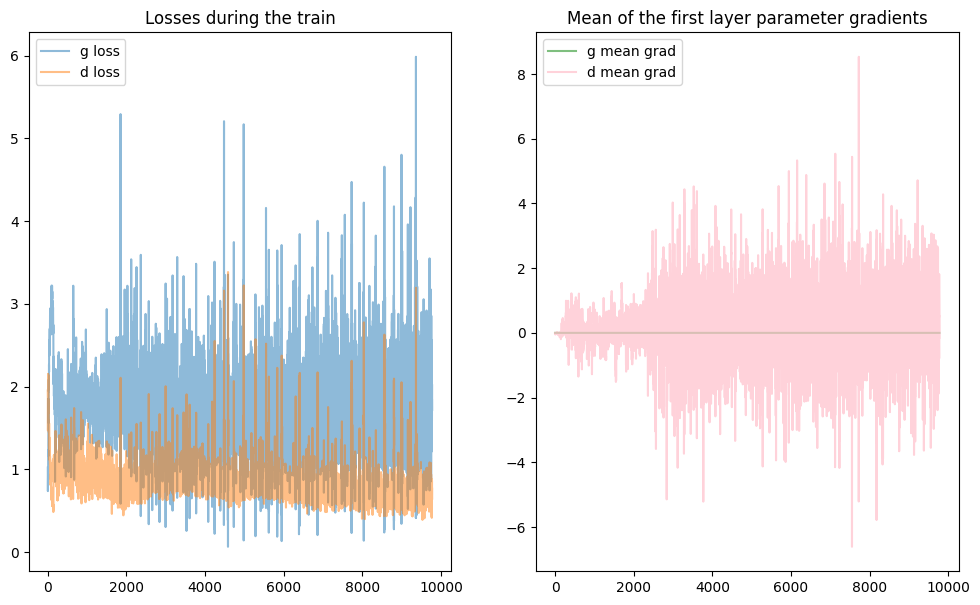

 98%|█████████▊| 49/50 [14:57<00:17, 17.65s/it]

it: 19549; g_loss: 2.104254961013794; d_loss: 0.4197784662246704; avg_real_score: 0.7953879237174988; avg_fake_score: 0.14733587205410004;
                    g_gradient: [mean,norm,max,min]=(9.89700038189767e-06, 9.250594139099121, 0.07889167219400406, -0.07633363455533981);
                    d_gradient: [mean,norm,max,min]=(1.763634443283081, 188.33718872070312, 22.937347412109375, -6.580118656158447)


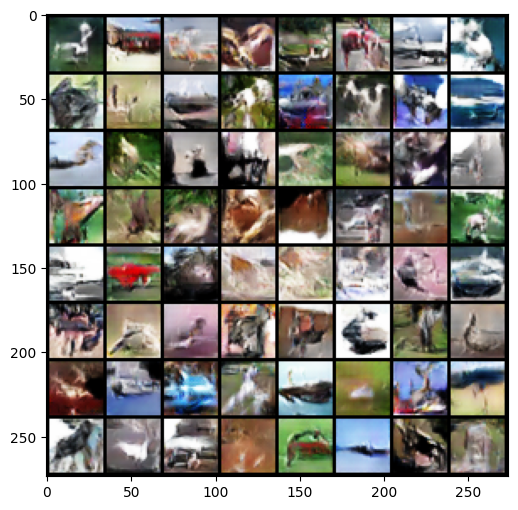

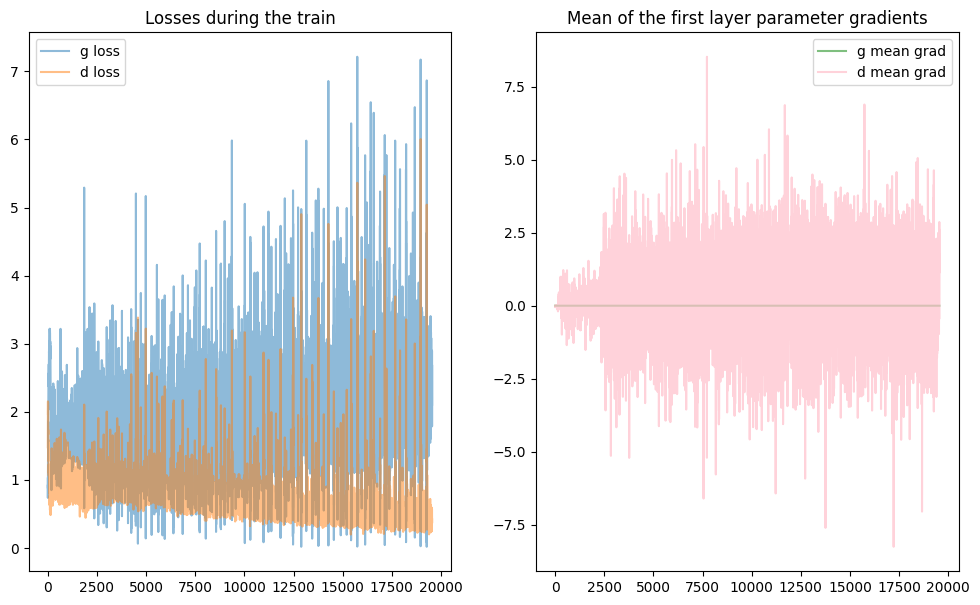

100%|██████████| 50/50 [15:15<00:00, 18.31s/it]

Training complete.


In [ ]:
nz = 1000
ngf = 32
ndf = 32

nchannels= 3
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

cifar10_netD_1 = Discriminator(ndf, nchannels).to(device)
cifar10_netG_1 = Generator(nz, ngf,nchannels).to(device)

cifar10_netD_1.apply(weights_init)
cifar10_netG_1.apply(weights_init)

g_opt = torch.optim.Adam(cifar10_netG_1.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(cifar10_netD_1.parameters(), lr=lr_d, betas=(beta1, 0.999))

training(cifar10_netG_1,cifar10_netD_1,nz,g_opt,d_opt,cifar10_loader,display_freq=200,nb_epochs=50,display_first_last=True)

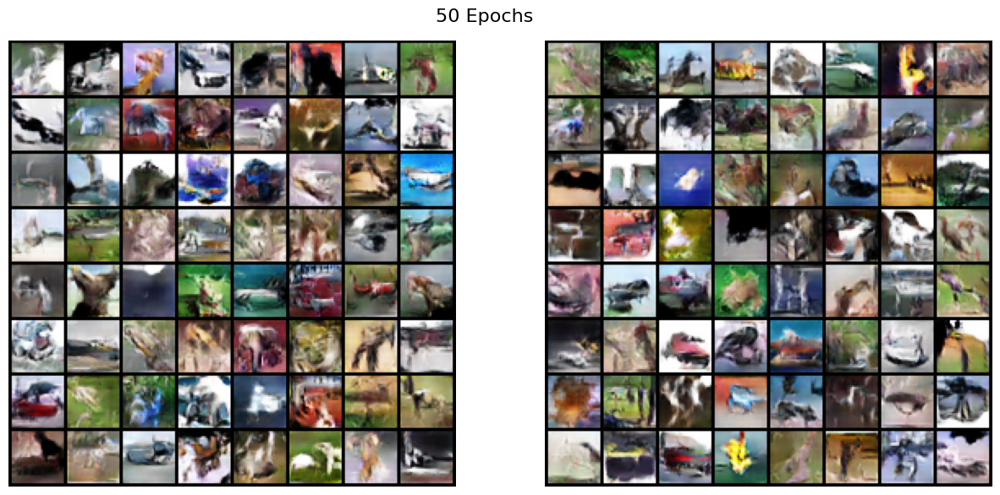

In [ ]:
display_generated_images(cifar10_netG_1,NOISES_1000_CIFAR,"50 Epochs",nz=1000,times=2)

# 4. Conditional GANs [BONUS]

A simple way to improve training performance and obtain control of the generation is to provide extra information into the Generator and the Discriminator, known as **Conditional GANs**. In this case, we will provide the class label (digit number of MNIST) into both the generator and the discriminator. This will help both of the networks.

## 4.1 Conditional Generator and Discriminator

Complete the ConditionalDiscriminator and ConditionalGenerator classes using your GAN building blocks (`get_upsampling_block` and `get_downsampling_block` functions).


### 4.1.1 Generator

In [15]:
# GENERATOR

'''
The conditional generator needs the label information as well as the latent vector. We will combine the latent vector and the class information in the following way:

- The class information for the generator will be represented as a one-hot vector sized `[batch_size, 10]` (since there are 10 classes in MNIST)
- The latent vector for the generator will still be sized `[batch_size, nz]`

1. Transform both of these modalities into 'images' (by adding dimensions)
2. Like before, apply the first upscaling block to both of these 'images'. We will now have 2 separate blocks sized

'''

class ConditionalGenerator(nn.Module):
    def __init__(self, nz, nc, ngf, nchannels=1):
        super().__init__()

        self.upscaling_z = get_upscaling_block(nz, ngf*8, 4, 1, 0)
        self.upscaling_c = get_upscaling_block(nc, ngf*8, 4, 1, 0)

        self.rest_model = nn.Sequential(
            get_upscaling_block(ngf*16, ngf*8, 4, 2, 1),
            get_upscaling_block(ngf*8, ngf*4, 4, 2, 1),
            get_upscaling_block(ngf*4, nchannels, 4, 2, 1,bias=True,last_layer=True)
        )

    def forward(self, x, y):
        x = x.unsqueeze(2).unsqueeze(2)
        y = y.unsqueeze(2).unsqueeze(2)

        upscaled_x = self.upscaling_z(x)
        upscaled_y = self.upscaling_c(y)

        concatenated_branches = torch.cat((upscaled_x,upscaled_y), dim=1)

        return self.rest_model(concatenated_branches)

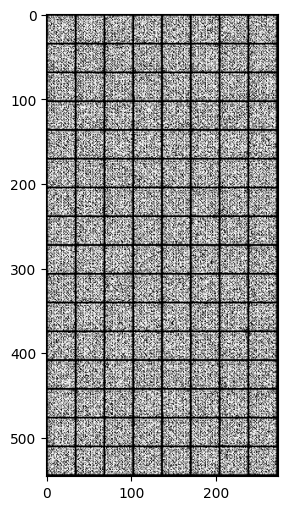

In [16]:
# CONDITIONAL GENERATOR SANITY CHECKING
batch_size = 128
z = torch.randn(batch_size, nz)
y = F.one_hot(real_labels).float()

cG = ConditionalGenerator(nz=nz, ngf=16, nc=10)
x_fake = cG(z, y)
plt.imshow(transforms.ToPILImage()(make_grid(x_fake, nrow=8)))

### 4.1.2 Discriminator

In [17]:
# Discriminator

'''
The conditional discriminator needs the label information as well as the latent vector. We will combine the latent vector and the class information in the following way:

- The class information for the discriminator will be represented as a one-hot vector sized `[batch_size, 10]` (since there are 10 classes in MNIST)
- The latent vector for the generator will still be sized `[batch_size, nz]`

1. Transform both of these modalities into 'images' (by adding dimensions)
2. Like before, apply the first upscaling block to both of these 'images'. We will now have 2 separate blocks sized

'''

class ConditionalDiscriminator(nn.Module):
    def __init__(self, ndf, nc, nchannels=1):
        super().__init__()
        self.downscale_z = get_downscaling_block(nchannels, ndf*2, 4, 2, 1, use_batch_norm=False)
        self.downscale_c = get_downscaling_block(nc, ndf*2, 4, 2, 1, use_batch_norm=False)

        self.rest_model = nn.Sequential(
            get_downscaling_block(ndf*4, ndf*8, 4, 2, 1),
            get_downscaling_block(ndf*8, ndf*16, 4, 2, 1),
            get_downscaling_block(ndf*16,1, 4, 1, 0,is_last=True)
        )


    def forward(self, x, y):

        # initially the y is the one hot vector
        batch_size , nb_classes = y.size()

        # expansion of y
        y = y.view(batch_size , nb_classes, 1, 1).expand(batch_size , nb_classes, 32, 32)

        downscaled_x = self.downscale_z(x)
        downscaled_y = self.downscale_c(y)

        concatenated_branches = torch.cat((downscaled_x,downscaled_y), dim=1)

        return self.rest_model(concatenated_branches).squeeze(1).squeeze(1) # remove spatial dimensions

### 4.1.3 Sanity Checks

In [18]:
# Conditional Discriminator Sanity Checking

cD = ConditionalDiscriminator(ndf=32, nc=10, nchannels=1)
print(real_batch.size())
print(F.one_hot(real_labels).float().size())
assert cD(real_batch, F.one_hot(real_labels).float()).shape == (real_batch.shape[0], 1)

torch.Size([128, 1, 32, 32])
torch.Size([128, 10])


## 4.2 Training

In [19]:
def training_cGAN(net_cG, net_cD, nz, g_opt, d_opt, dataloader, display_freq=200, nb_epochs=5, display_first_last=False):

    g_losses = []
    d_losses = []
    g_mean_grad = []
    d_mean_grad = []

    j = 0

    z_test = sample_z(100, nz)  # we generate the noise only once for testing


    for epoch in tqdm(range(nb_epochs)):

        # train
        for i, batch in enumerate(dataloader):
            im, labels = batch
            im = im.to(device)

            y = F.one_hot(labels).float().to(device)

            cur_batch_size = im.shape[0]
            # gt --> ground-truth
            real_gt_labels = get_labels_one(batch_size)
            generated_gt_labels = get_labels_zero(batch_size)

            # 1. sample a z
            random_sample = sample_z(cur_batch_size, nz)

            # 2. Generate a fake image
            fake_image = net_cG(random_sample,y)

            # 3. Classify real image with D
            yhat_real = net_cD(im,y)

            # 4. Classify fake image with D
            yhat_fake = net_cD(fake_image,y)


            ###
            ### Discriminator
            ###

            d_loss_fake = criterion(yhat_fake, get_labels_zero(cur_batch_size))
            d_loss_real = criterion(yhat_real, get_labels_one(cur_batch_size))
            d_loss = d_loss_real + d_loss_fake
            d_opt.zero_grad()
            d_loss.backward(retain_graph=True) # we need to retain graph=True to be able to calculate the gradient in the g backprop
            gradient_d = [param.grad for param in net_cD.parameters()][0]
            d_opt.step()


            ###
            ### Generator
            ###


            yhat_fake_for_generator = net_cD(fake_image,y)
            g_loss = criterion(yhat_fake_for_generator, get_labels_one(cur_batch_size))
            g_opt.zero_grad()
            g_loss.backward()
            gradient_g = [param.grad for param in net_cG.parameters()][0]
            g_opt.step()

            # Save Metrics
            d_losses.append(d_loss.item())
            g_losses.append(g_loss.item())
            g_mean_grad.append(torch.mean(gradient_g).item())
            d_mean_grad.append(torch.mean(gradient_d).item())

            avg_real_score = yhat_real.mean().item()
            avg_fake_score = yhat_fake.mean().item()

            # Display after each display_freq batches
            if not display_first_last and j % display_freq == 0:
                print(f"it: {j}; g_loss: {g_loss}; d_loss: {d_loss}; avg_real_score: {avg_real_score}; avg_fake_score: {avg_fake_score};\n\
                        g_gradient: [mean,norm,max,min]={torch.mean(gradient_g).item(),torch.norm(gradient_g).item(),torch.max(gradient_g).item(),torch.min(gradient_g).item()};\n\
                        d_gradient: [mean,norm,max,min]={torch.mean(gradient_d).item(),torch.norm(gradient_d).item(),torch.max(gradient_d).item(),torch.min(gradient_d).item()}")

                c_display_plots(net_cG, z_test, g_losses, d_losses, g_mean_grad, d_mean_grad)

            # Display for the first and last iteration
            thesize = len(dataloader)*nb_epochs
            if display_first_last and (j == 0 or j == thesize//2 or j == thesize//4 or j == thesize//8 or j == thesize - 1):
                print(f"it: {j}; g_loss: {g_loss}; d_loss: {d_loss}; avg_real_score: {avg_real_score}; avg_fake_score: {avg_fake_score};\n\
                        g_gradient: [mean,norm,max,min]={torch.mean(gradient_g).item(),torch.norm(gradient_g).item(),torch.max(gradient_g).item(),torch.min(gradient_g).item()};\n\
                        d_gradient: [mean,norm,max,min]={torch.mean(gradient_d).item(),torch.norm(gradient_d).item(),torch.max(gradient_d).item(),torch.min(gradient_d).item()}")

                c_display_plots(net_cG, z_test, g_losses, d_losses, g_mean_grad, d_mean_grad)

            j += 1


    print("Training complete.")

def c_display_plots(netG, z_test, g_losses, d_losses, g_mean_grad, d_mean_grad):
    labels = torch.arange(0, 10).expand(size=(10, 10)).flatten().to(device)
    y = F.one_hot(labels).float().to(device)
    fake_im = netG(z_test,y)

    un_norm = renorm(fake_im)  # for visualization

    grid = torchvision.utils.make_grid(un_norm, nrow=10)
    pil_grid = to_pil(grid)

    plt.imshow(pil_grid)
    plt.show()

    plt.figure(figsize=(12, 7))
    plt.subplot(121)
    plt.title("Losses during the train")
    plt.plot(range(len(g_losses)), g_losses, label='g loss', alpha=0.5)
    plt.plot(range(len(g_losses)), d_losses, label='d loss', alpha=0.5)
    plt.legend()

    plt.subplot(122)
    plt.title("Mean of the first layer parameter gradients")
    plt.plot(range(len(g_mean_grad)), g_mean_grad, label='g mean grad', c='green', alpha=0.5)
    plt.plot(range(len(d_mean_grad)), d_mean_grad, label='d mean grad', c='pink', alpha=0.7)

    plt.legend()
    plt.show()

In [ ]:
nz = 100
ndf = 32
ngf = 32
nchannels= 1
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

nc= 10

net_cD = ConditionalDiscriminator(ndf, nc, nchannels=1).to(device)
net_cG = ConditionalGenerator(nz, nc, ngf).to(device)

net_cG.apply(weights_init)
net_cD.apply(weights_init)

g_opt = torch.optim.Adam(net_cG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(net_cD.parameters(), lr=lr_d, betas=(beta1, 0.999))

  0%|          | 0/5 [00:00<?, ?it/s]

it: 0; g_loss: 3.3484630584716797; d_loss: 1.8733232021331787; avg_real_score: 0.5879555940628052; avg_fake_score: 0.665109395980835;
                        g_gradient: [mean,norm,max,min]=(-4.092481049156049e-06, 1.8716893196105957, 0.01884395070374012, -0.01975073851644993);
                        d_gradient: [mean,norm,max,min]=(0.003549378365278244, 7.869585990905762, 1.19596266746521, -0.9170114994049072)


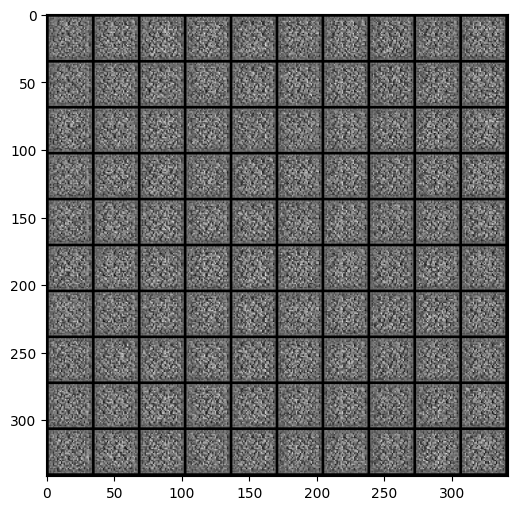

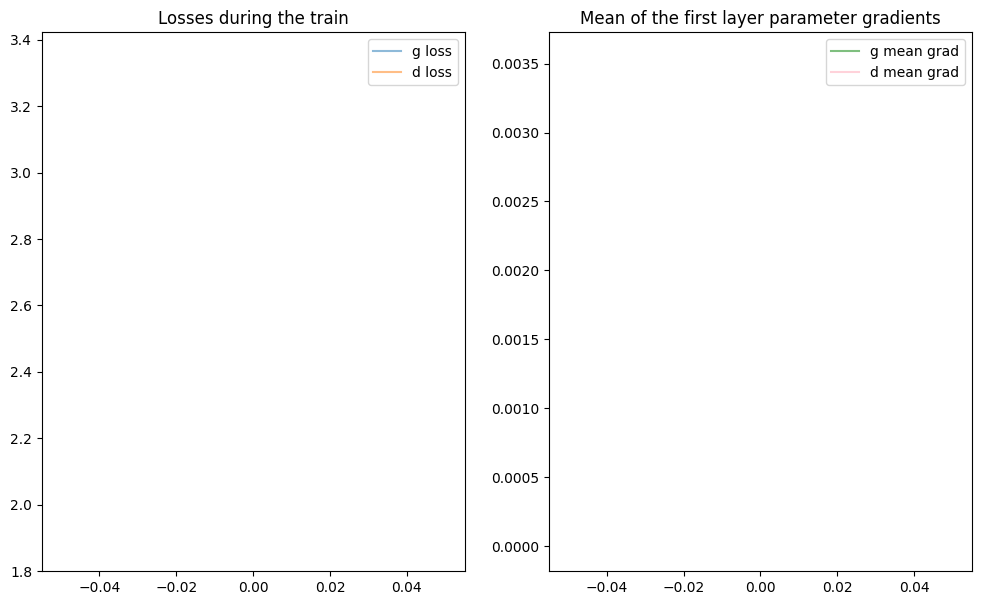

it: 200; g_loss: 2.0958704948425293; d_loss: 0.7440478801727295; avg_real_score: 0.6881401538848877; avg_fake_score: 0.2510756850242615;
                        g_gradient: [mean,norm,max,min]=(8.228286787925754e-06, 0.3230465352535248, 0.004980770871043205, -0.004764750134199858);
                        d_gradient: [mean,norm,max,min]=(1.1261976957321167, 53.337013244628906, 5.4207763671875, -2.42476487159729)


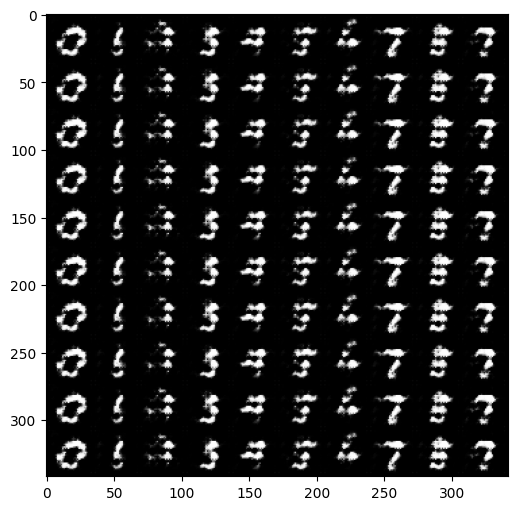

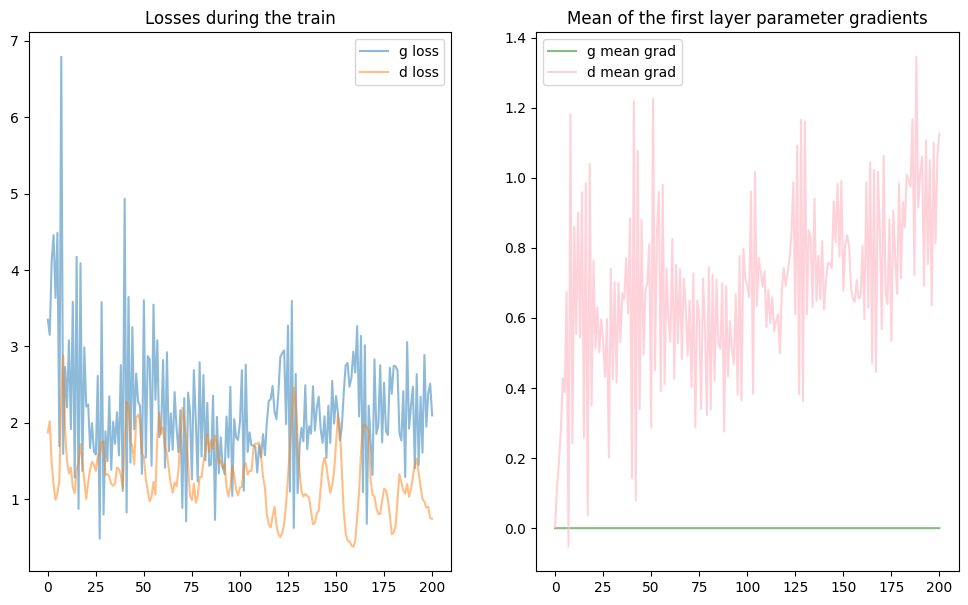

it: 400; g_loss: 1.6778186559677124; d_loss: 1.1078695058822632; avg_real_score: 0.47862571477890015; avg_fake_score: 0.13027429580688477;
                        g_gradient: [mean,norm,max,min]=(-1.516594329586951e-05, 0.4713531732559204, 0.008995133452117443, -0.009815303608775139);
                        d_gradient: [mean,norm,max,min]=(0.9912495613098145, 56.4838752746582, 5.7956013679504395, -2.6984009742736816)


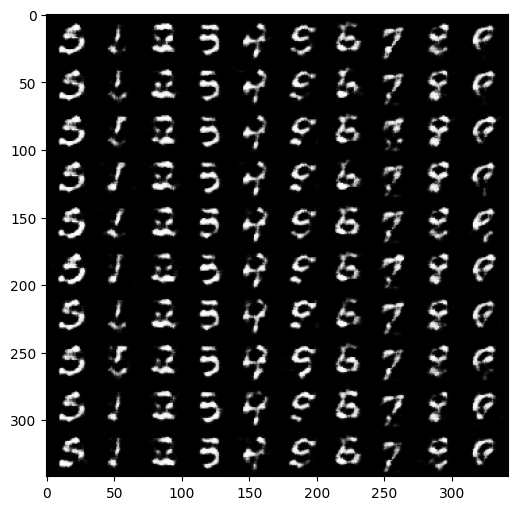

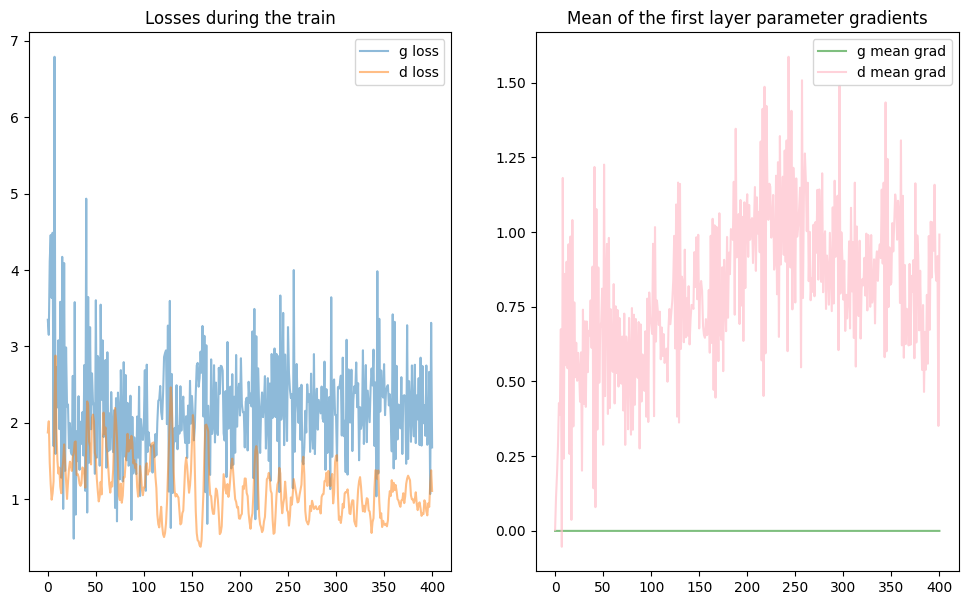

 20%|██        | 1/5 [01:11<04:45, 71.33s/it]

Training complete.
it: 600; g_loss: 1.2000904083251953; d_loss: 1.0397394895553589; avg_real_score: 0.5846308469772339; avg_fake_score: 0.30604273080825806;
                        g_gradient: [mean,norm,max,min]=(-1.5374104123111465e-06, 0.5439090728759766, 0.00731118768453598, -0.007767935283482075);
                        d_gradient: [mean,norm,max,min]=(0.565865695476532, 36.94514465332031, 4.1415886878967285, -2.828781843185425)


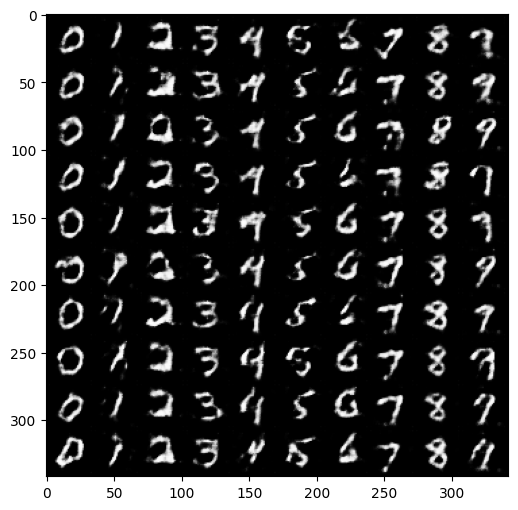

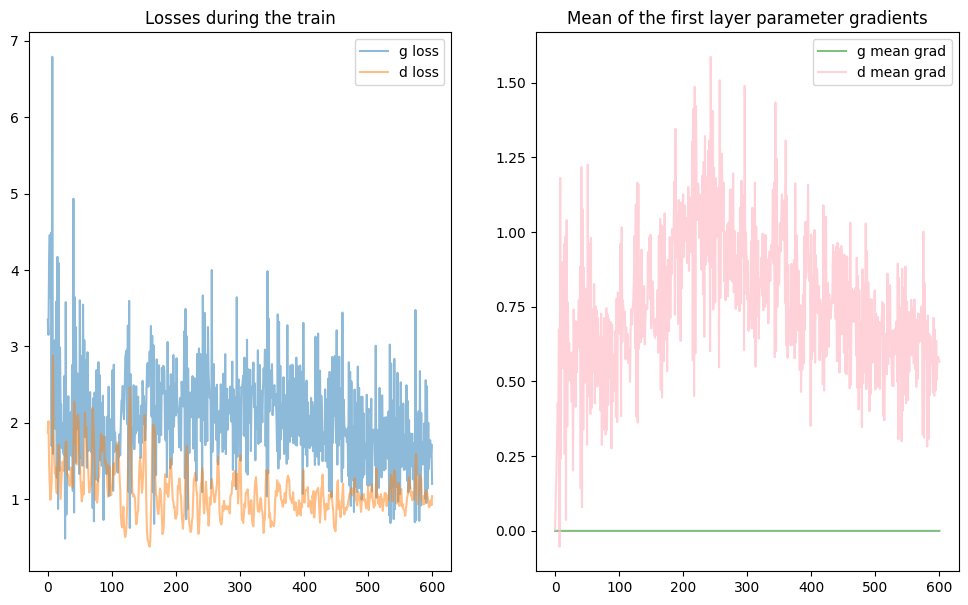

it: 800; g_loss: 1.0246098041534424; d_loss: 1.4541795253753662; avg_real_score: 0.4695333242416382; avg_fake_score: 0.4006788432598114;
                        g_gradient: [mean,norm,max,min]=(-3.3755552522052312e-06, 0.6005208492279053, 0.008380497805774212, -0.009599070064723492);
                        d_gradient: [mean,norm,max,min]=(0.6084380149841309, 43.8931770324707, 5.584930419921875, -3.408250331878662)


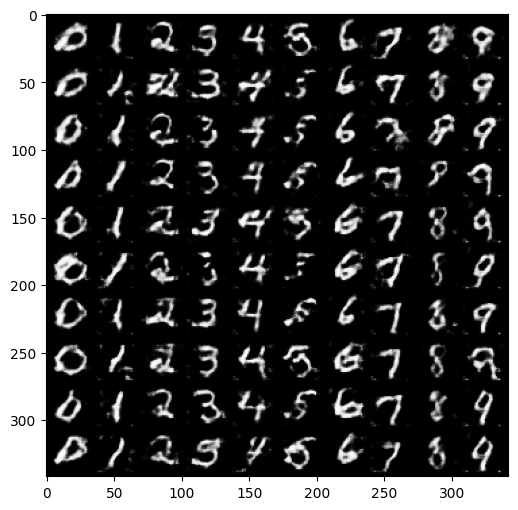

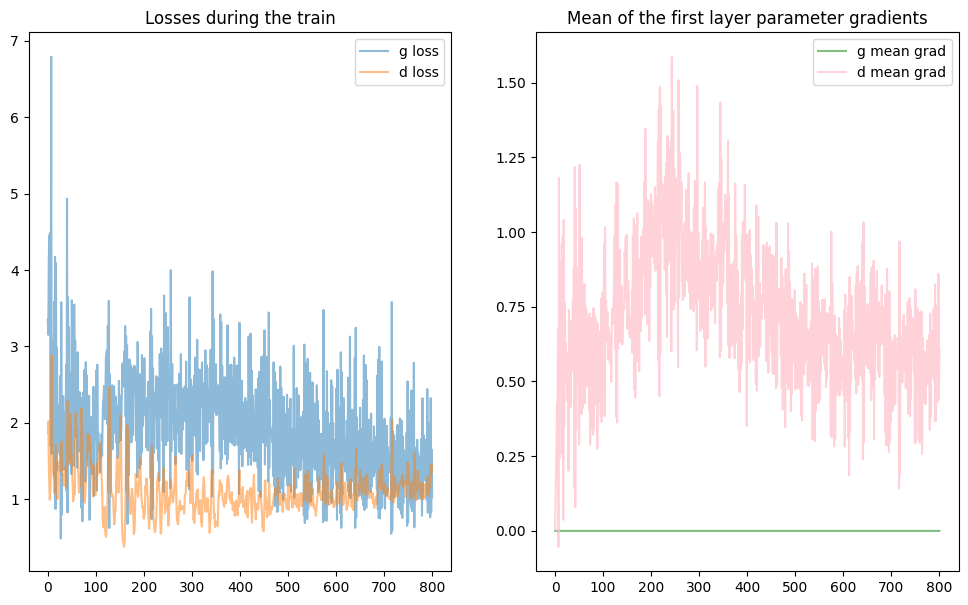

 40%|████      | 2/5 [02:16<03:23, 67.87s/it]

Training complete.
it: 1000; g_loss: 2.1042325496673584; d_loss: 1.3840515613555908; avg_real_score: 0.7922083139419556; avg_fake_score: 0.6373310685157776;
                        g_gradient: [mean,norm,max,min]=(-1.339254595222883e-05, 0.7103903889656067, 0.010155095718801022, -0.011838731355965137);
                        d_gradient: [mean,norm,max,min]=(0.1800178438425064, 19.49811553955078, 3.1210436820983887, -1.4145128726959229)


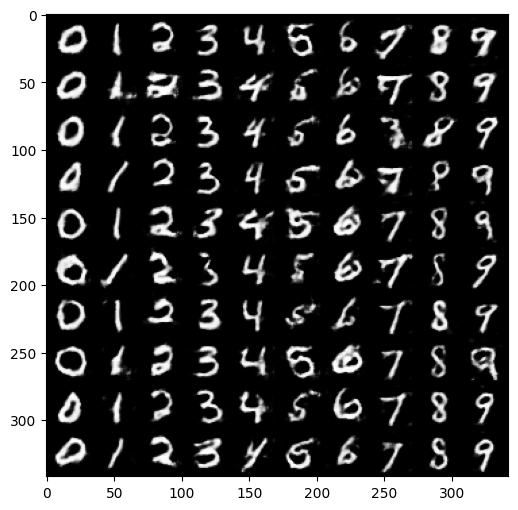

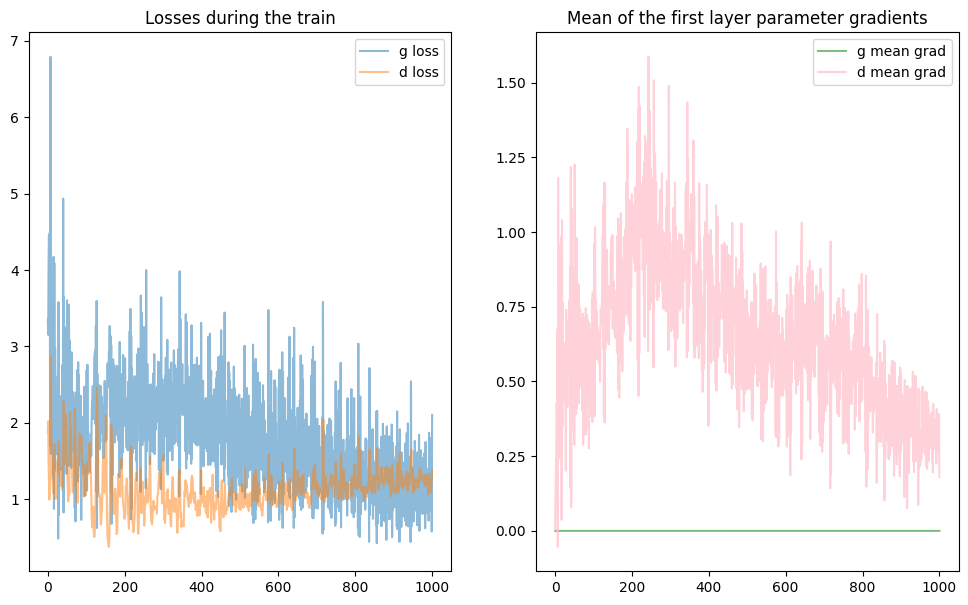

it: 1200; g_loss: 1.0039438009262085; d_loss: 1.137688159942627; avg_real_score: 0.6299768686294556; avg_fake_score: 0.45435720682144165;
                        g_gradient: [mean,norm,max,min]=(1.1644619007711299e-05, 0.5068179368972778, 0.007358054630458355, -0.007614190690219402);
                        d_gradient: [mean,norm,max,min]=(0.16355489194393158, 32.52293014526367, 4.7521233558654785, -3.6719584465026855)


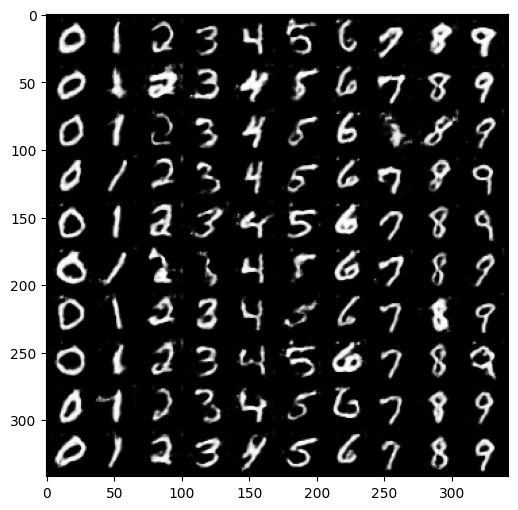

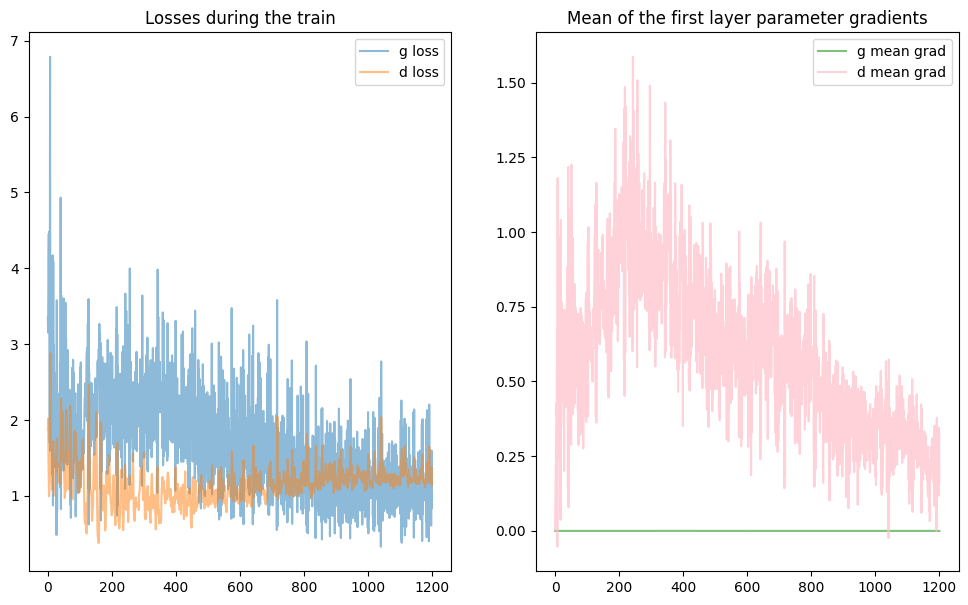

it: 1400; g_loss: 1.4553240537643433; d_loss: 1.3581078052520752; avg_real_score: 0.7737974524497986; avg_fake_score: 0.6396039724349976;
                        g_gradient: [mean,norm,max,min]=(5.587531177297933e-06, 0.5440707802772522, 0.009212934412062168, -0.007328071165829897);
                        d_gradient: [mean,norm,max,min]=(0.04848288744688034, 16.82371711730957, 2.972940444946289, -1.370096206665039)


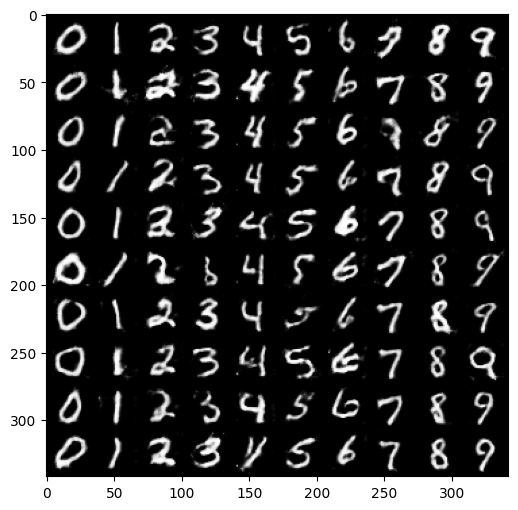

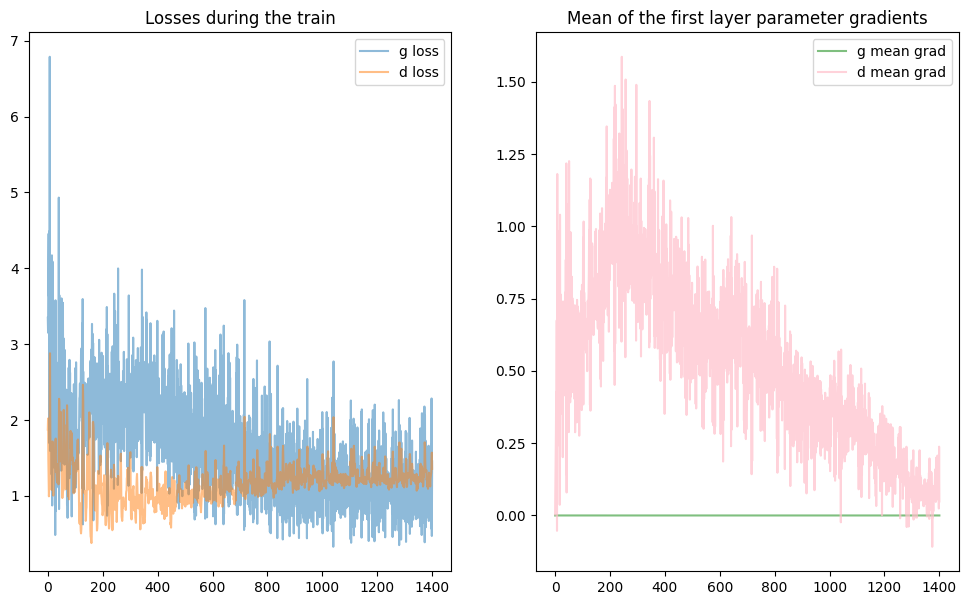

 60%|██████    | 3/5 [03:21<02:12, 66.49s/it]

Training complete.
it: 1600; g_loss: 2.016749620437622; d_loss: 1.565439224243164; avg_real_score: 0.8084955215454102; avg_fake_score: 0.7181180119514465;
                        g_gradient: [mean,norm,max,min]=(-2.5860426831059158e-06, 0.6767241358757019, 0.010555793531239033, -0.01011066883802414);
                        d_gradient: [mean,norm,max,min]=(-0.03970003500580788, 17.619638442993164, 3.3714370727539062, -1.4304075241088867)


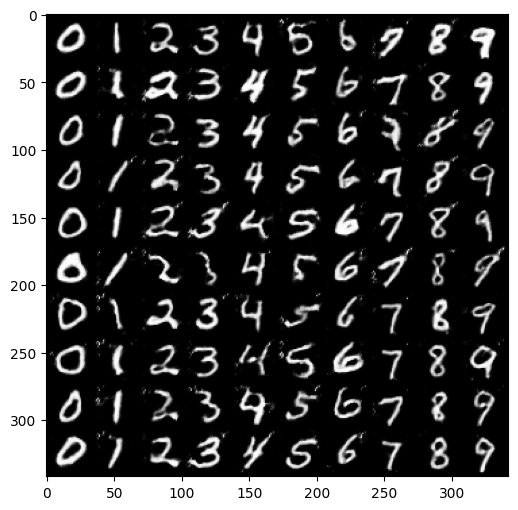

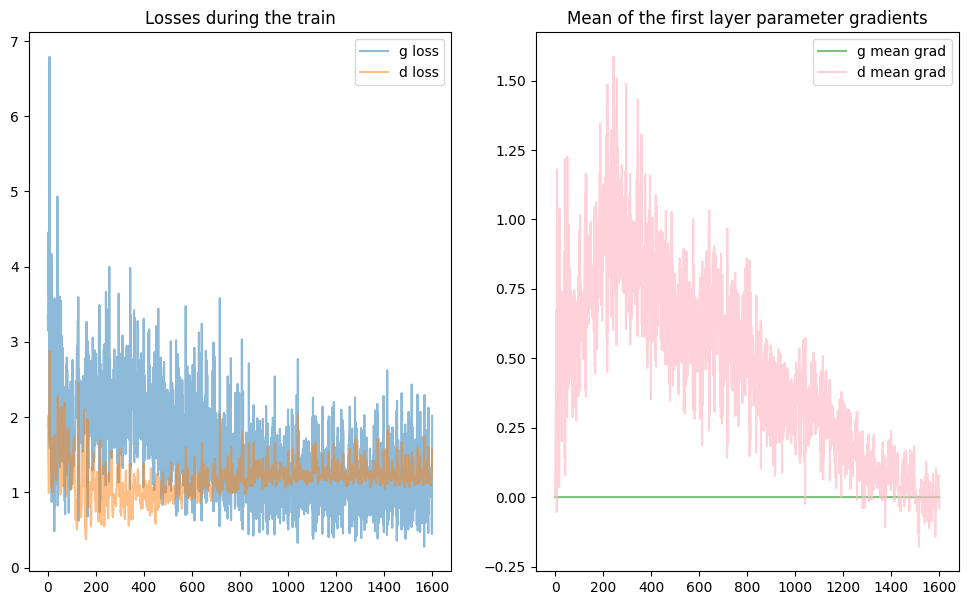

it: 1800; g_loss: 0.8792325854301453; d_loss: 1.1547961235046387; avg_real_score: 0.5235520005226135; avg_fake_score: 0.36071985960006714;
                        g_gradient: [mean,norm,max,min]=(-7.539803391409805e-06, 0.49601835012435913, 0.007032250519841909, -0.007849962450563908);
                        d_gradient: [mean,norm,max,min]=(-0.02412782609462738, 54.34919738769531, 10.080367088317871, -4.249714374542236)


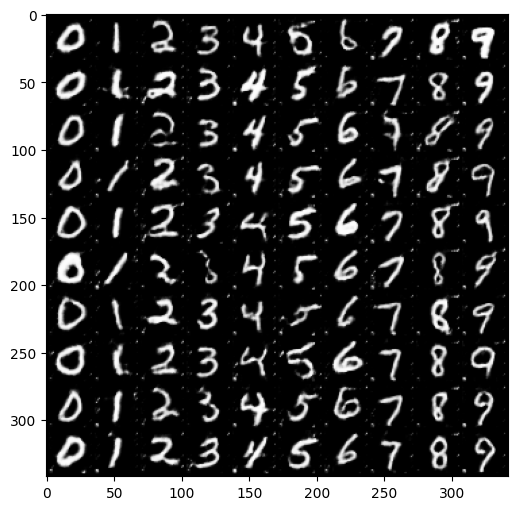

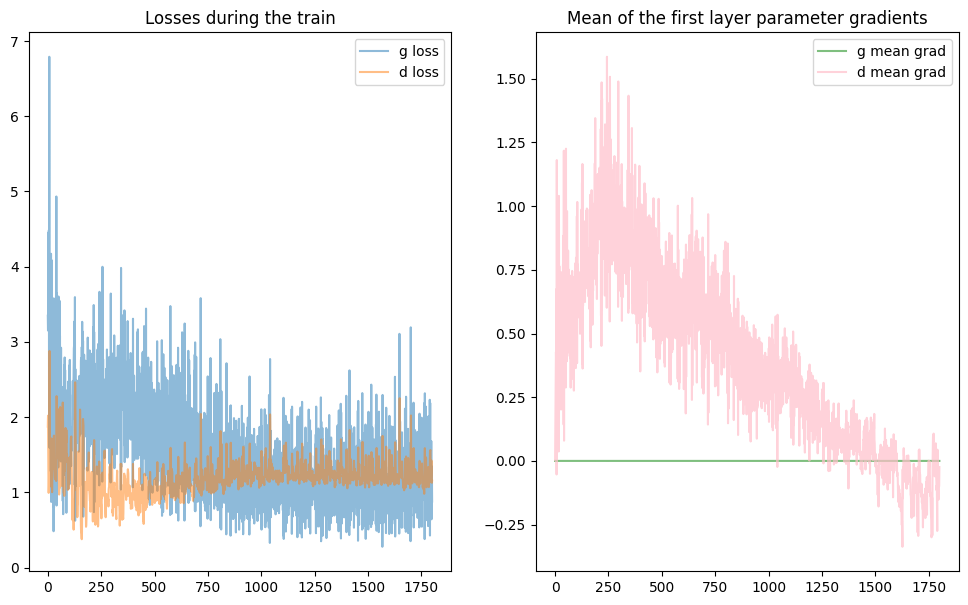

 80%|████████  | 4/5 [04:25<01:05, 65.39s/it]

Training complete.
it: 2000; g_loss: 1.0682461261749268; d_loss: 1.0393527746200562; avg_real_score: 0.5937634110450745; avg_fake_score: 0.37204688787460327;
                        g_gradient: [mean,norm,max,min]=(-3.3279638955718838e-06, 0.5962824821472168, 0.012141339480876923, -0.010933821089565754);
                        d_gradient: [mean,norm,max,min]=(-0.26223909854888916, 67.46282958984375, 13.561195373535156, -10.378292083740234)


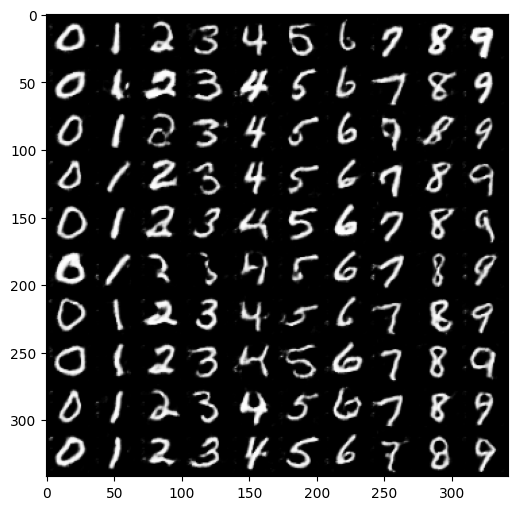

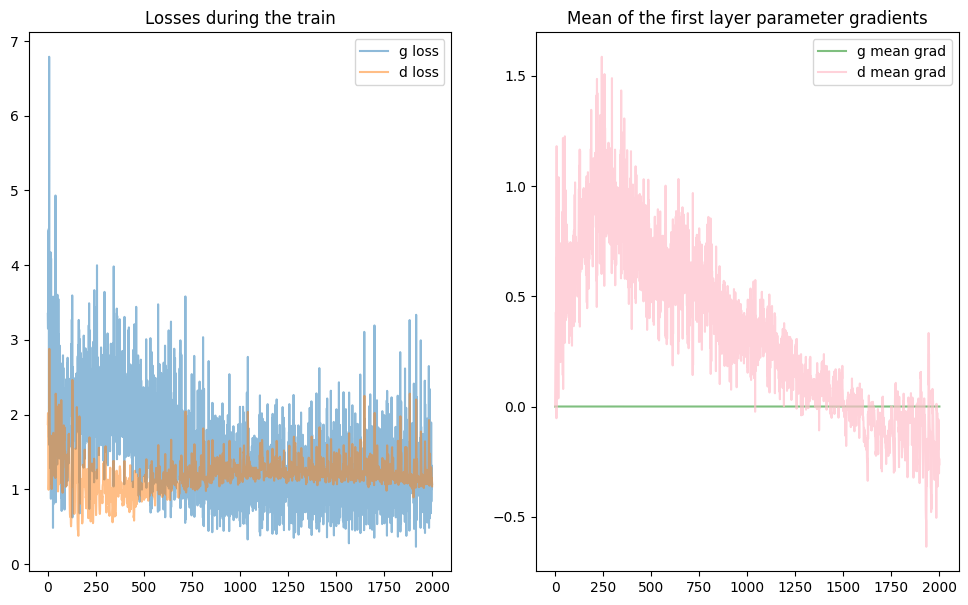

it: 2200; g_loss: 0.4754229187965393; d_loss: 1.3750293254852295; avg_real_score: 0.3550930321216583; avg_fake_score: 0.21334382891654968;
                        g_gradient: [mean,norm,max,min]=(2.6480513497517677e-06, 0.35512763261795044, 0.005232577212154865, -0.00553867919370532);
                        d_gradient: [mean,norm,max,min]=(-0.18715351819992065, 78.56208038330078, 14.19621753692627, -6.325201988220215)


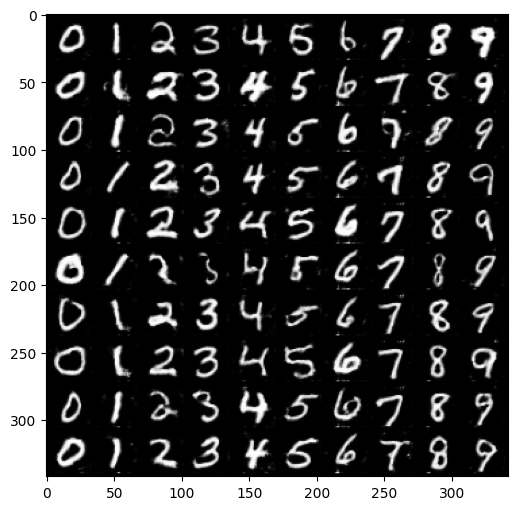

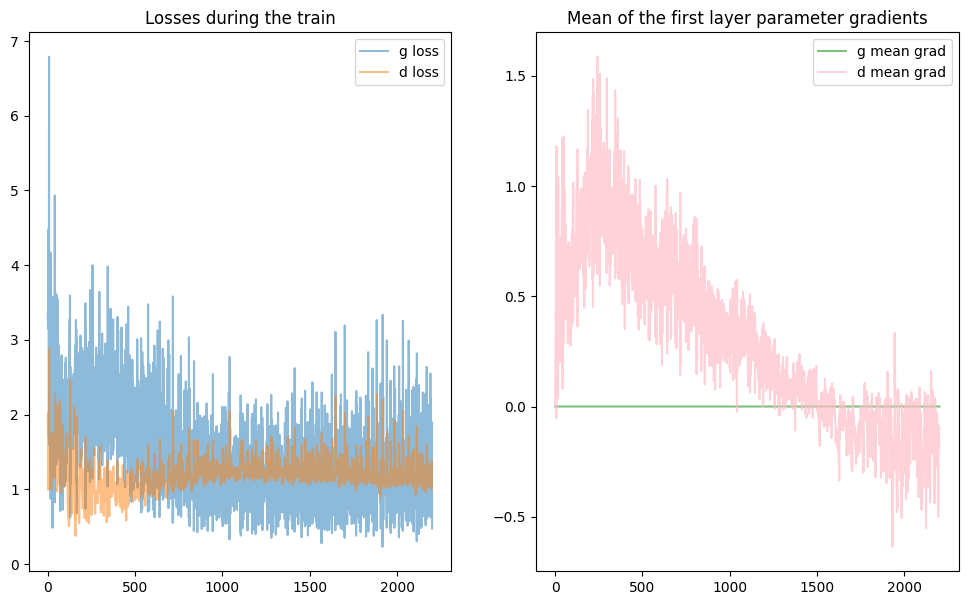

100%|██████████| 5/5 [05:29<00:00, 65.92s/it]

Training complete.


In [ ]:
training_cGAN(net_cG, net_cD, nz, g_opt, d_opt, dataloader, display_freq=200, nb_epochs=5, display_first_last=False)

## 4.2 Testing
Visualization of the impact of z on generation. All digits in the same column have the same noise vector z.

In [20]:
def display_cGAN(net_cG,z,n_classes,n_ex,nz,title):
    net_cG.eval()

    labels = torch.arange(n_classes).unsqueeze(0).reshape(-1, 1).repeat(1, n_ex).flatten().to(device)

    ys = F.one_hot(labels).float()
    fake_ims = net_cG(z, ys)

    un_norm= renorm(fake_ims) # for visualization
    grid = torchvision.utils.make_grid(un_norm, nrow=n_ex)
    pil_grid = to_pil(grid)

    plt.title(title)
    plt.imshow(pil_grid)
    plt.show()

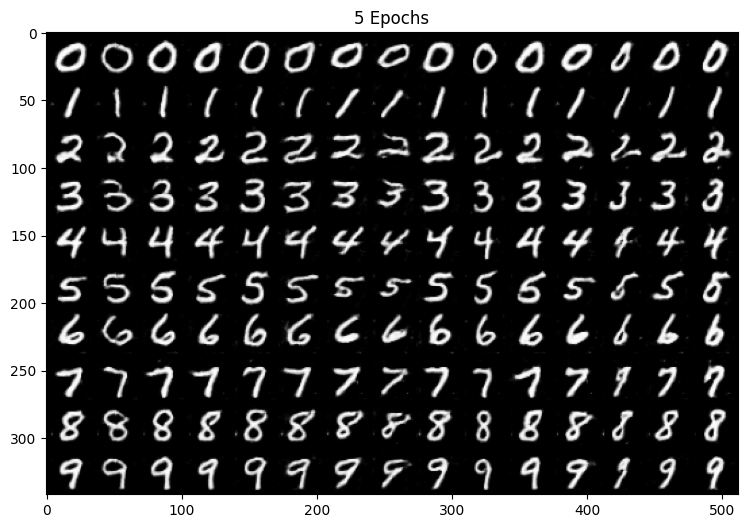

In [ ]:
n_ex = 15
n_classes = 10
nz = 100
z = sample_z(n_ex, nz).repeat(n_classes, 1)

display_cGAN(net_cG,z,n_classes,n_ex,nz,"5 Epochs")

By having multiple columns, we introduce diversity in the generated images. The generator can use these different noise vectors to produce variations of the same class of images.

## CIFAR-10 Dataset

#### 5 epochs

  0%|          | 0/5 [00:00<?, ?it/s]

it: 0; g_loss: 4.287408828735352; d_loss: 2.3172643184661865; avg_real_score: 0.7199694514274597; avg_fake_score: 0.7666856646537781;
                        g_gradient: [mean,norm,max,min]=(3.5111693108547115e-08, 3.11767578125, 0.012578325346112251, -0.012828359380364418);
                        d_gradient: [mean,norm,max,min]=(0.031015675514936447, 5.234325885772705, 0.5689568519592285, -0.2683643102645874)


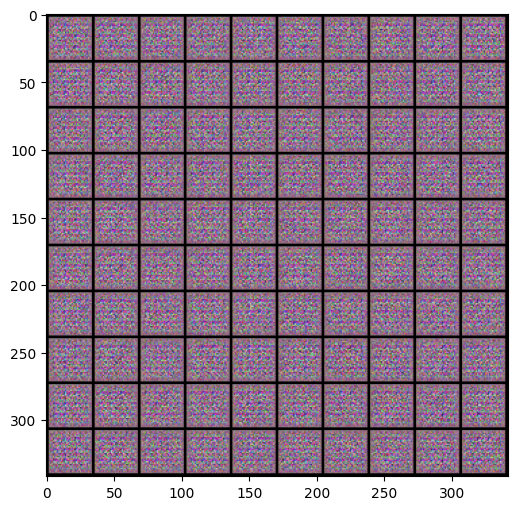

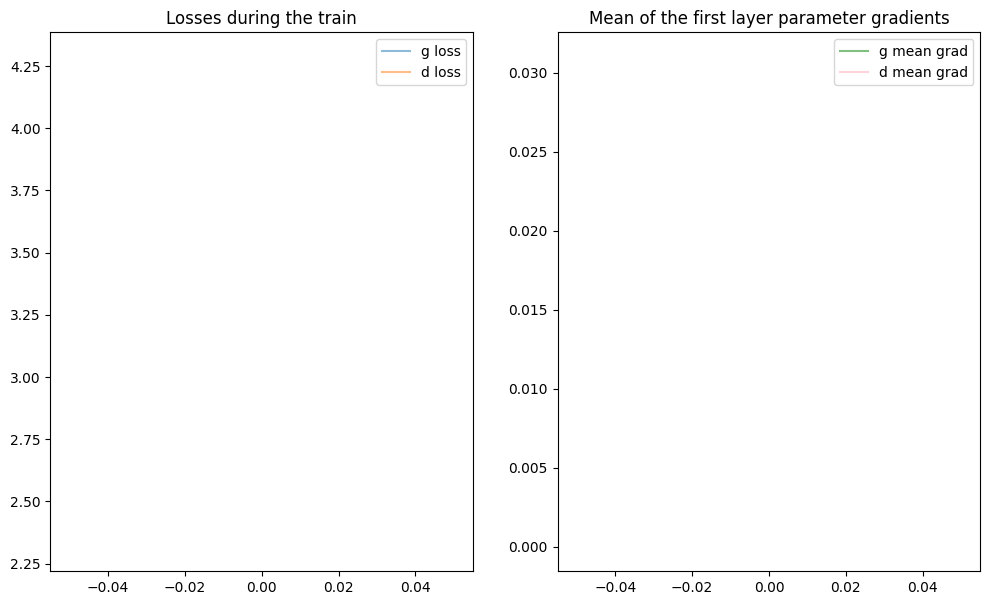

it: 200; g_loss: 2.744690418243408; d_loss: 1.122738242149353; avg_real_score: 0.6501880288124084; avg_fake_score: 0.34577804803848267;
                        g_gradient: [mean,norm,max,min]=(3.3146912414849794e-07, 0.4483044445514679, 0.002671139780431986, -0.0029918819200247526);
                        d_gradient: [mean,norm,max,min]=(-0.10196767747402191, 15.283052444458008, 0.824842095375061, -0.981319785118103)


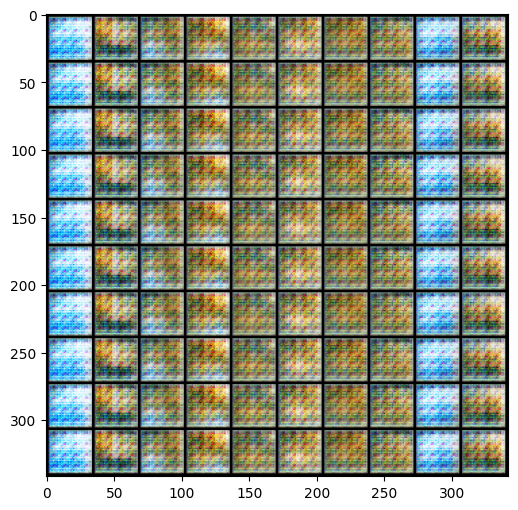

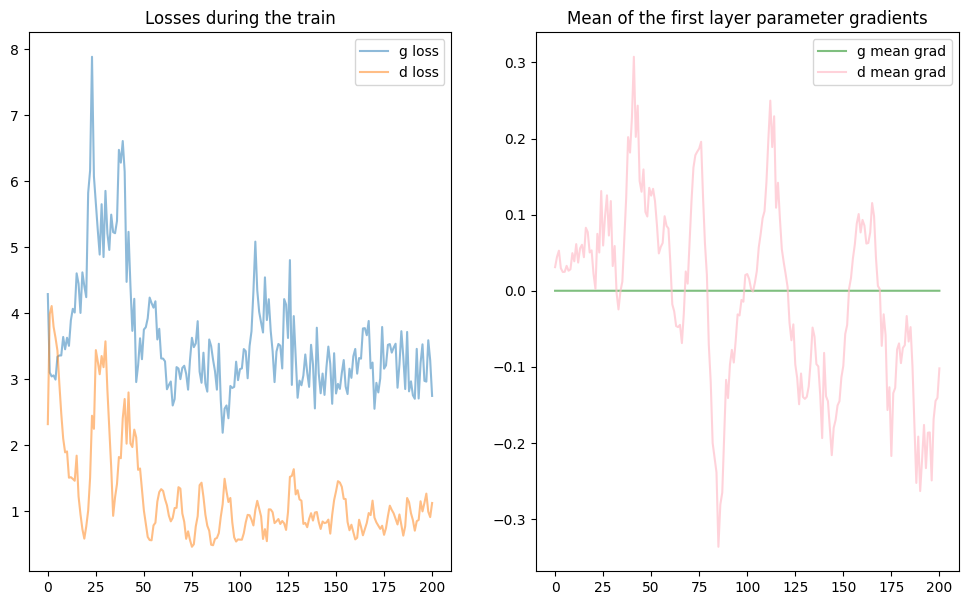

 20%|██        | 1/5 [01:03<04:13, 63.34s/it]

Training complete.
it: 400; g_loss: 3.7274932861328125; d_loss: 0.4584317207336426; avg_real_score: 0.8018050193786621; avg_fake_score: 0.1712549477815628;
                        g_gradient: [mean,norm,max,min]=(-1.771693746377423e-06, 0.6033428311347961, 0.0027739228680729866, -0.003036209149286151);
                        d_gradient: [mean,norm,max,min]=(-0.2001877725124359, 18.749357223510742, 0.6618953347206116, -1.166025996208191)


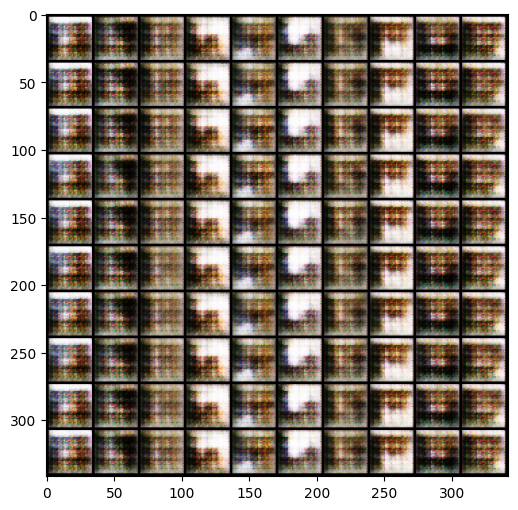

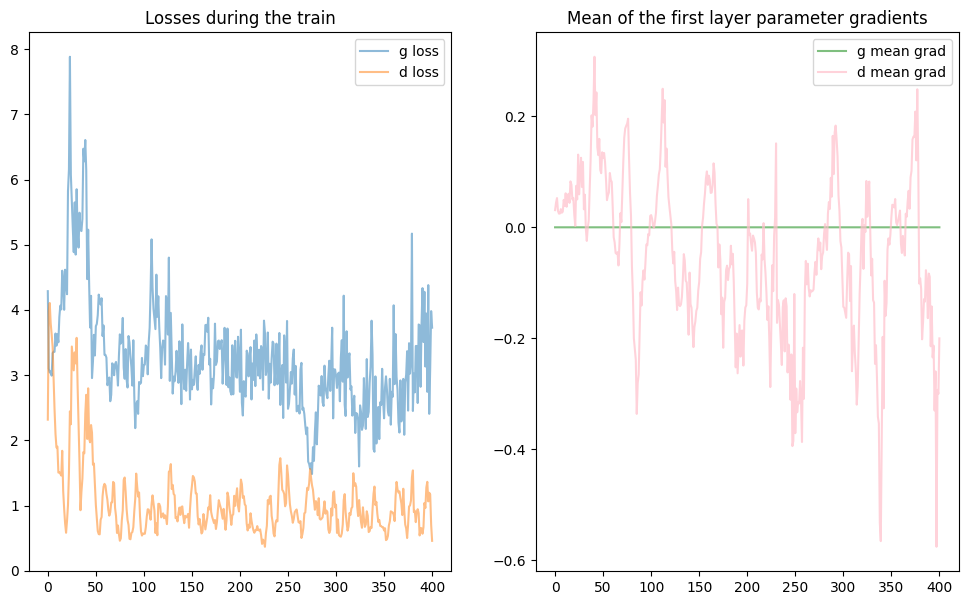

it: 600; g_loss: 1.966357707977295; d_loss: 1.8117882013320923; avg_real_score: 0.7787697315216064; avg_fake_score: 0.7360353469848633;
                        g_gradient: [mean,norm,max,min]=(-1.8742337033472722e-06, 1.3282289505004883, 0.005767851136624813, -0.0074549028649926186);
                        d_gradient: [mean,norm,max,min]=(-0.8952950239181519, 54.612098693847656, 0.5285310745239258, -2.1317498683929443)


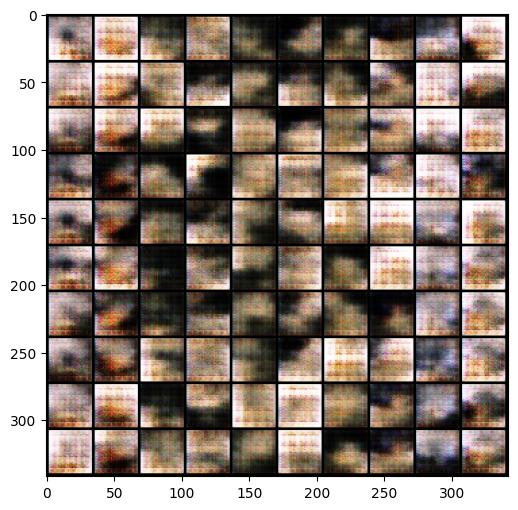

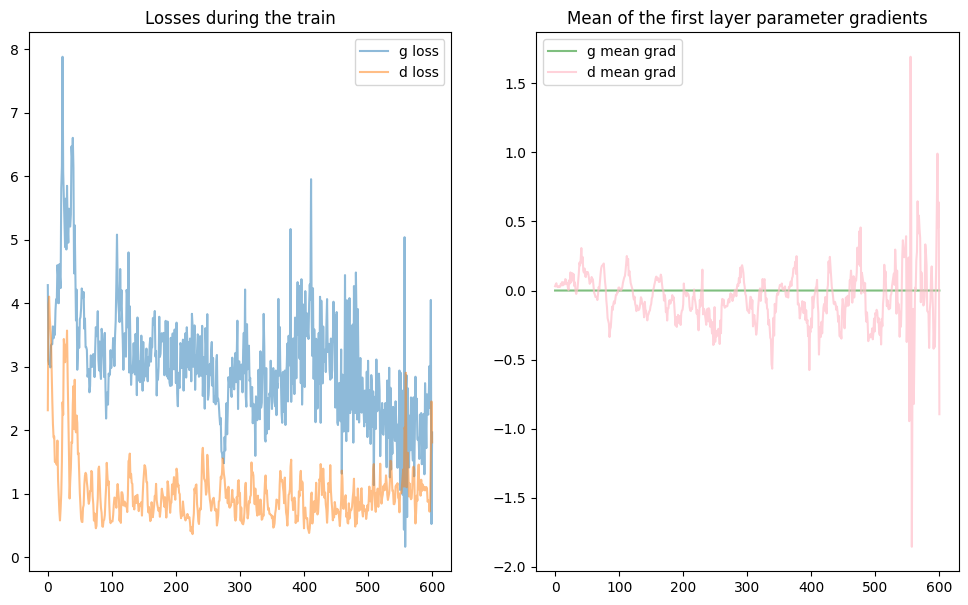

 40%|████      | 2/5 [02:03<03:03, 61.20s/it]

Training complete.
it: 800; g_loss: 1.9931440353393555; d_loss: 0.8768489956855774; avg_real_score: 0.5630768537521362; avg_fake_score: 0.1553286612033844;
                        g_gradient: [mean,norm,max,min]=(9.70740984485019e-07, 0.901820957660675, 0.003486009081825614, -0.003207501256838441);
                        d_gradient: [mean,norm,max,min]=(-0.14144891500473022, 23.470531463623047, 1.0587137937545776, -2.3503973484039307)


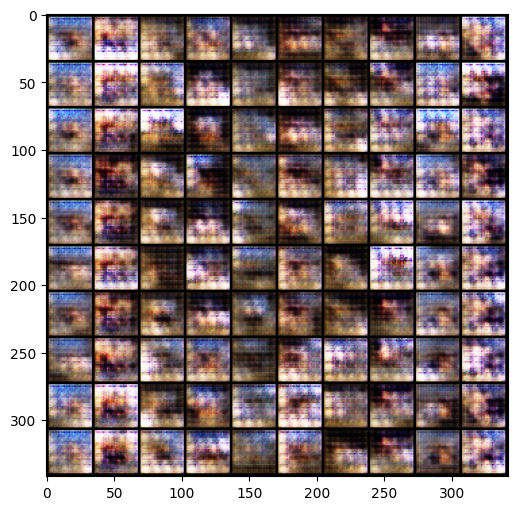

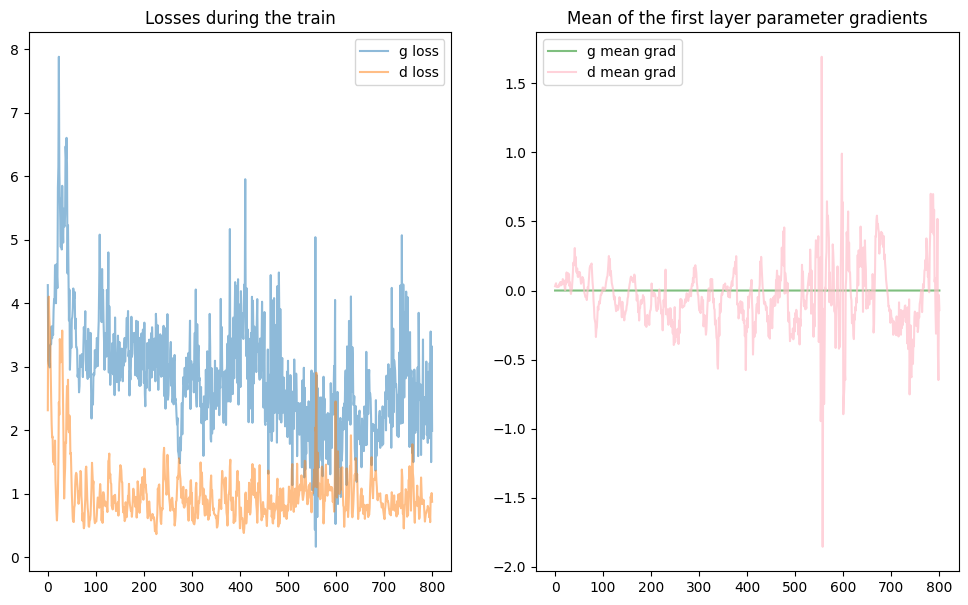

it: 1000; g_loss: 1.1182401180267334; d_loss: 1.1421191692352295; avg_real_score: 0.5256265997886658; avg_fake_score: 0.2916822135448456;
                        g_gradient: [mean,norm,max,min]=(1.4813753068665392e-06, 0.6802574396133423, 0.003094341605901718, -0.0030158080626279116);
                        d_gradient: [mean,norm,max,min]=(0.34138259291648865, 37.67378616333008, 1.8878836631774902, -1.7745230197906494)


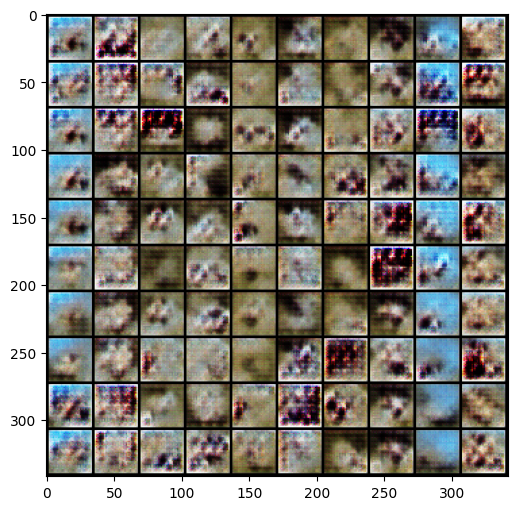

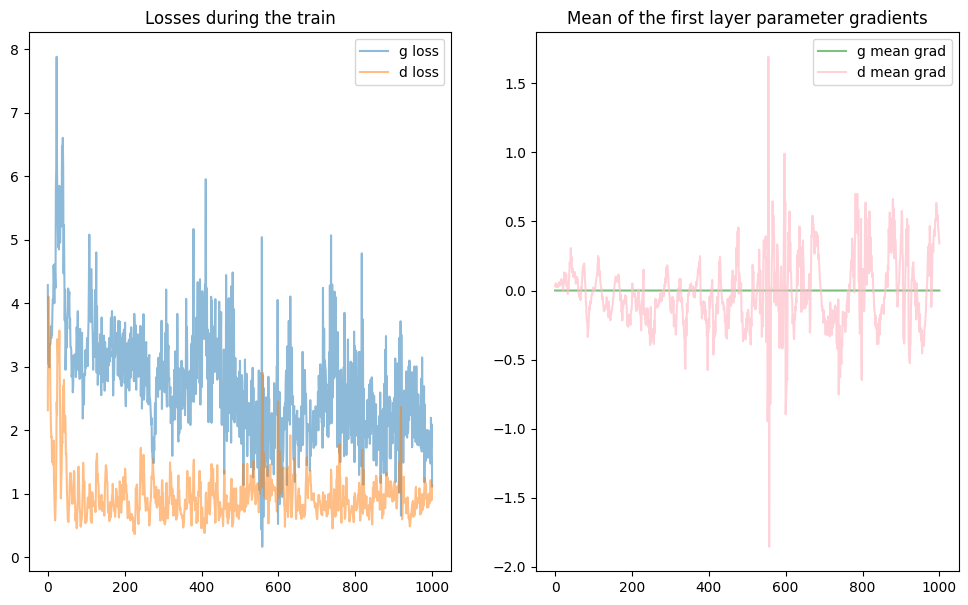

 60%|██████    | 3/5 [03:03<02:01, 60.76s/it]

Training complete.
it: 1200; g_loss: 1.0488824844360352; d_loss: 1.7347071170806885; avg_real_score: 0.24976539611816406; avg_fake_score: 0.06810588389635086;
                        g_gradient: [mean,norm,max,min]=(-4.706260824605124e-06, 0.6371182203292847, 0.0027918906416743994, -0.0030280910432338715);
                        d_gradient: [mean,norm,max,min]=(0.16137933731079102, 35.8446044921875, 2.123427391052246, -1.5848898887634277)


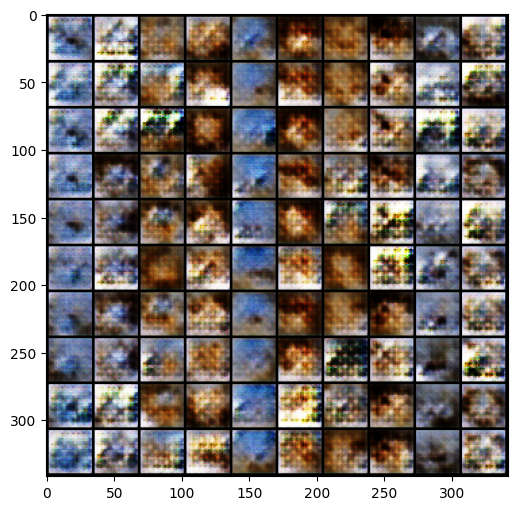

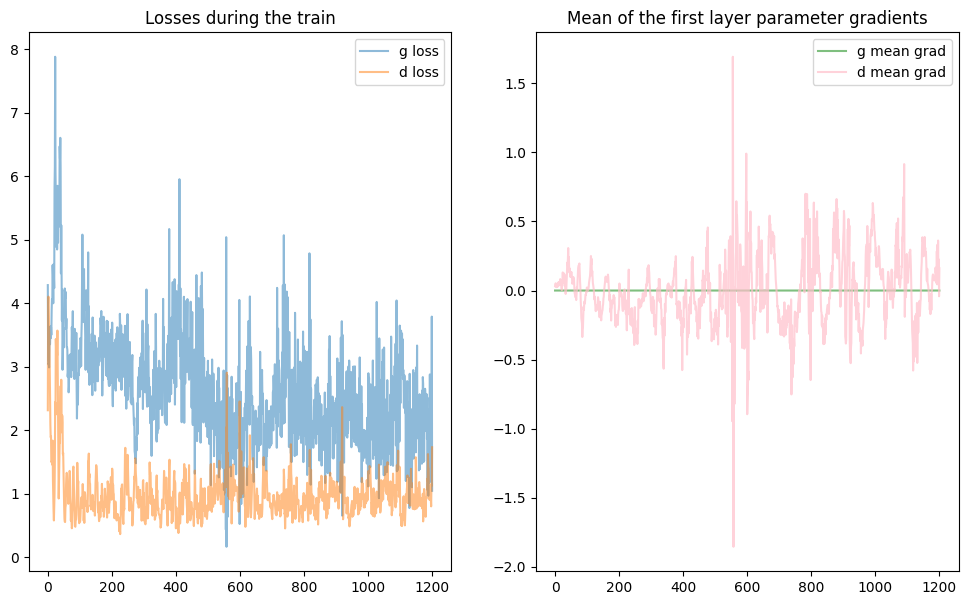

it: 1400; g_loss: 1.8252390623092651; d_loss: 0.7836281061172485; avg_real_score: 0.7038453817367554; avg_fake_score: 0.3069054186344147;
                        g_gradient: [mean,norm,max,min]=(-5.07495497004129e-06, 0.9949185252189636, 0.005756542552262545, -0.005049063824117184);
                        d_gradient: [mean,norm,max,min]=(-0.16278477013111115, 22.261865615844727, 0.9650623202323914, -2.3314313888549805)


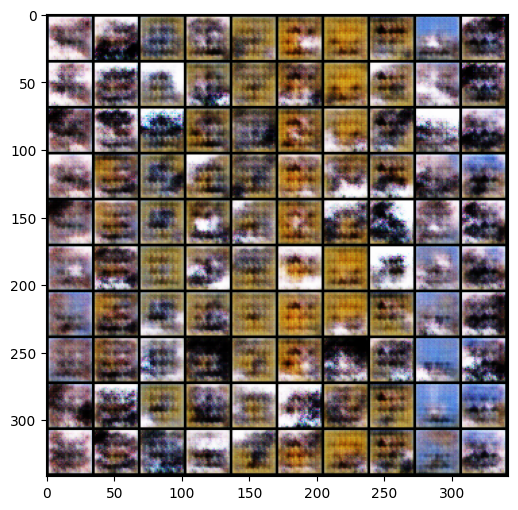

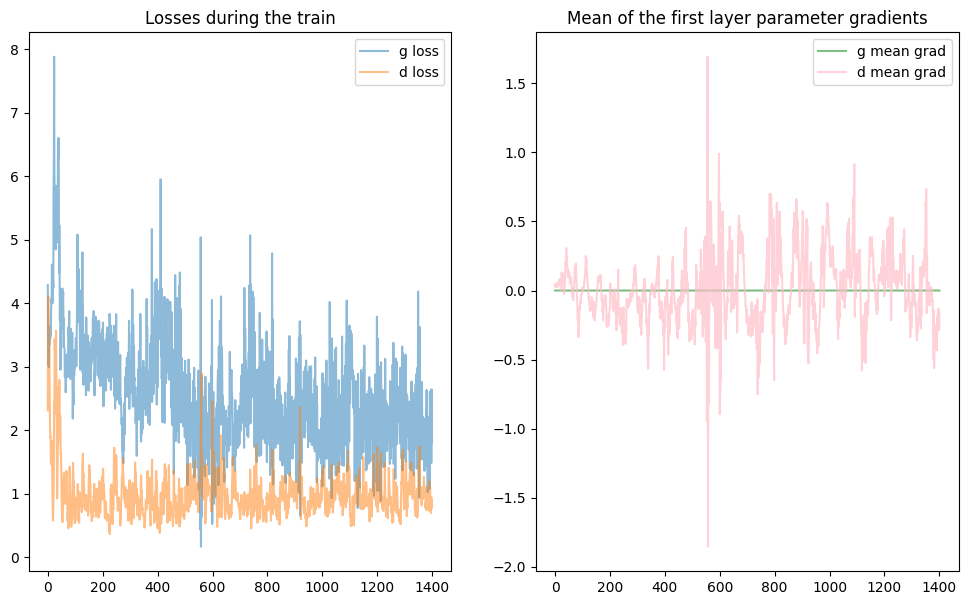

 80%|████████  | 4/5 [04:03<01:00, 60.44s/it]

Training complete.
it: 1600; g_loss: 3.49149751663208; d_loss: 0.7248696088790894; avg_real_score: 0.7944577932357788; avg_fake_score: 0.3256261348724365;
                        g_gradient: [mean,norm,max,min]=(-2.0801089704036713e-06, 1.1479301452636719, 0.0071696019731462, -0.0075289662927389145);
                        d_gradient: [mean,norm,max,min]=(-0.09974702447652817, 28.670801162719727, 1.2534223794937134, -1.5271316766738892)


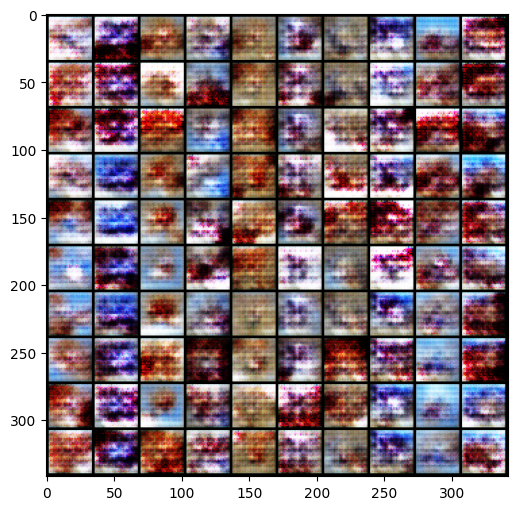

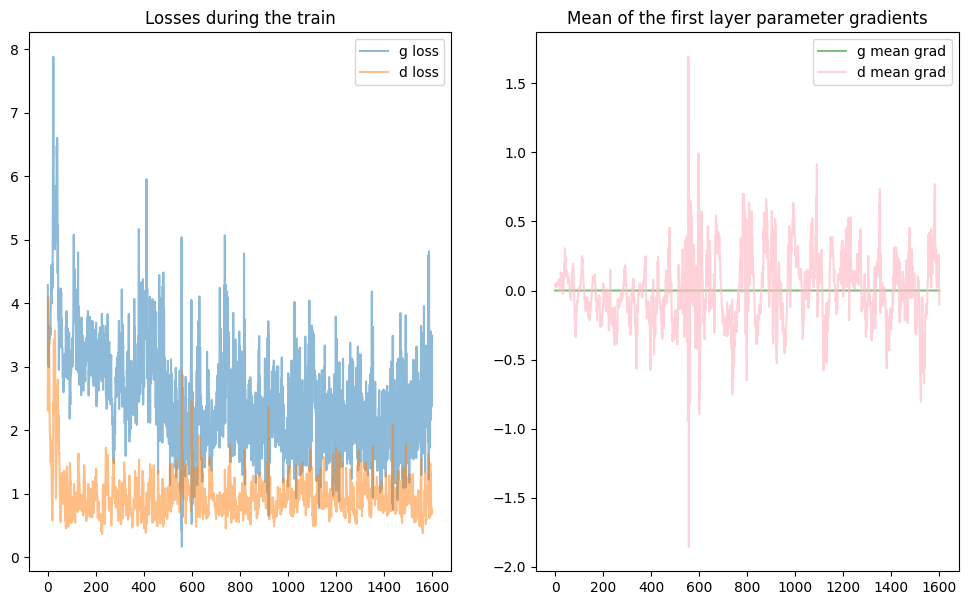

it: 1800; g_loss: 2.2167646884918213; d_loss: 0.5596617460250854; avg_real_score: 0.754473865032196; avg_fake_score: 0.1876523196697235;
                        g_gradient: [mean,norm,max,min]=(5.566964318859391e-06, 1.082632303237915, 0.009567302651703358, -0.007951593026518822);
                        d_gradient: [mean,norm,max,min]=(-0.019033843651413918, 28.214807510375977, 1.3170287609100342, -1.505155086517334)


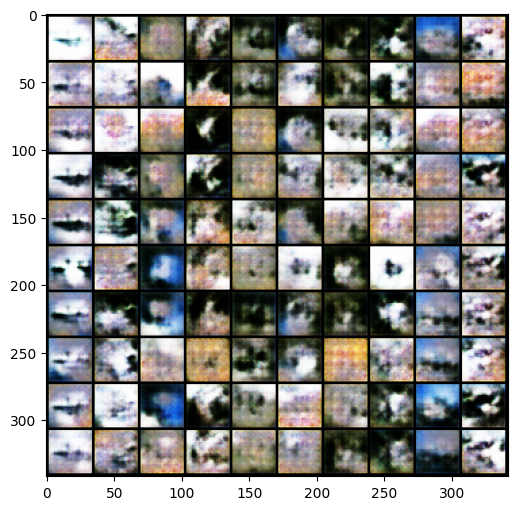

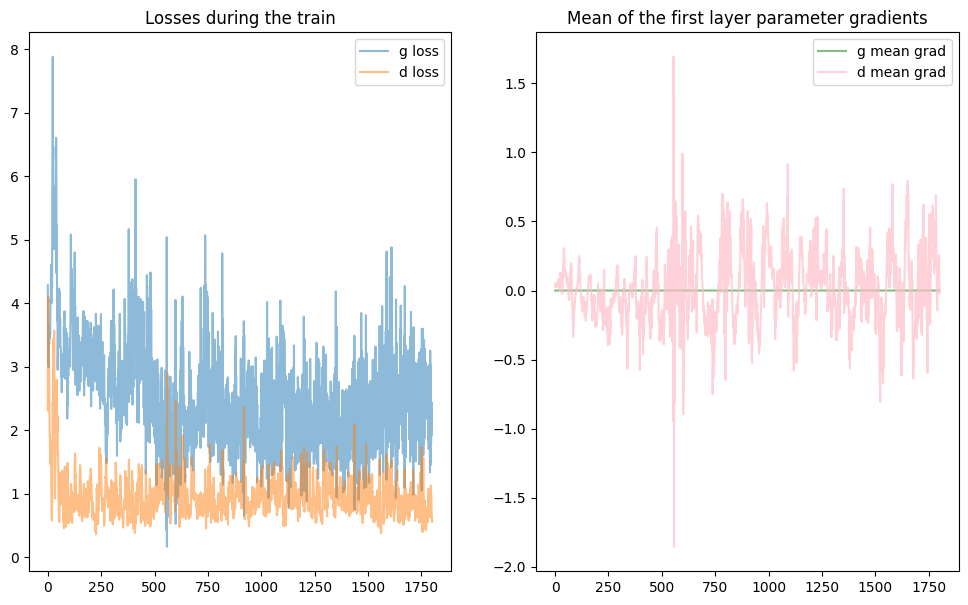

100%|██████████| 5/5 [05:03<00:00, 60.76s/it]

Training complete.


In [ ]:
nz = 1000
ndf = 32
ngf = 32
nchannels= 3
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

nc= 10

cifar10_net_cD = ConditionalDiscriminator(ndf, nc, nchannels).to(device)
cifar10_net_cG = ConditionalGenerator(nz, nc, ngf,nchannels).to(device)

cifar10_net_cG.apply(weights_init)
cifar10_net_cD.apply(weights_init)

g_opt = torch.optim.Adam(cifar10_net_cG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(cifar10_net_cD.parameters(), lr=lr_d, betas=(beta1, 0.999))

training_cGAN(cifar10_net_cG,cifar10_net_cD, nz, g_opt, d_opt,cifar10_loader, display_freq=200, nb_epochs=5, display_first_last=False)

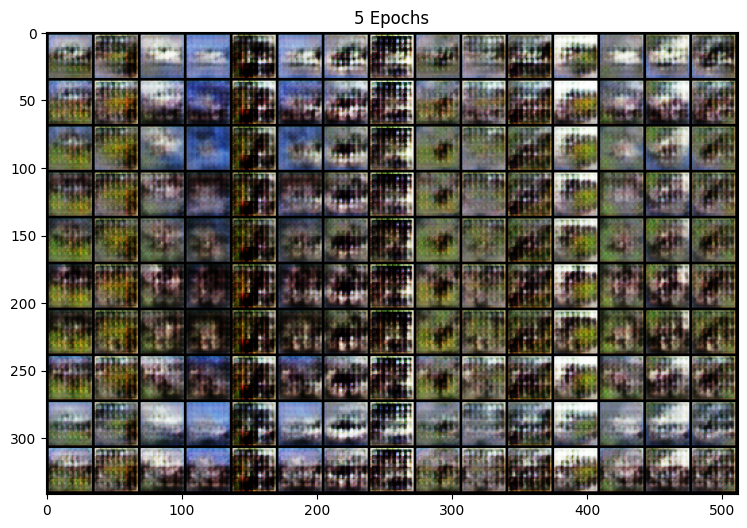

In [ ]:
n_ex = 15
n_classes = 10
nz = 1000
z = sample_z(n_ex, nz).repeat(n_classes, 1)

display_cGAN(cifar10_net_cG,z,n_classes,n_ex,nz,"5 Epochs")

#### 50 epochs

  0%|          | 0/50 [00:00<?, ?it/s]

it: 0; g_loss: 2.19297194480896; d_loss: 2.076003074645996; avg_real_score: 0.33904168009757996; avg_fake_score: 0.43553346395492554;
                        g_gradient: [mean,norm,max,min]=(-5.501245823325007e-07, 2.1945085525512695, 0.010455125011503696, -0.008911686949431896);
                        d_gradient: [mean,norm,max,min]=(0.0054565295577049255, 6.962928295135498, 0.4201368987560272, -0.46459829807281494)


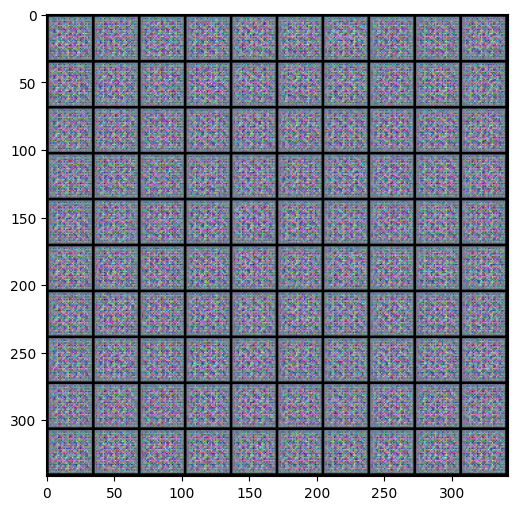

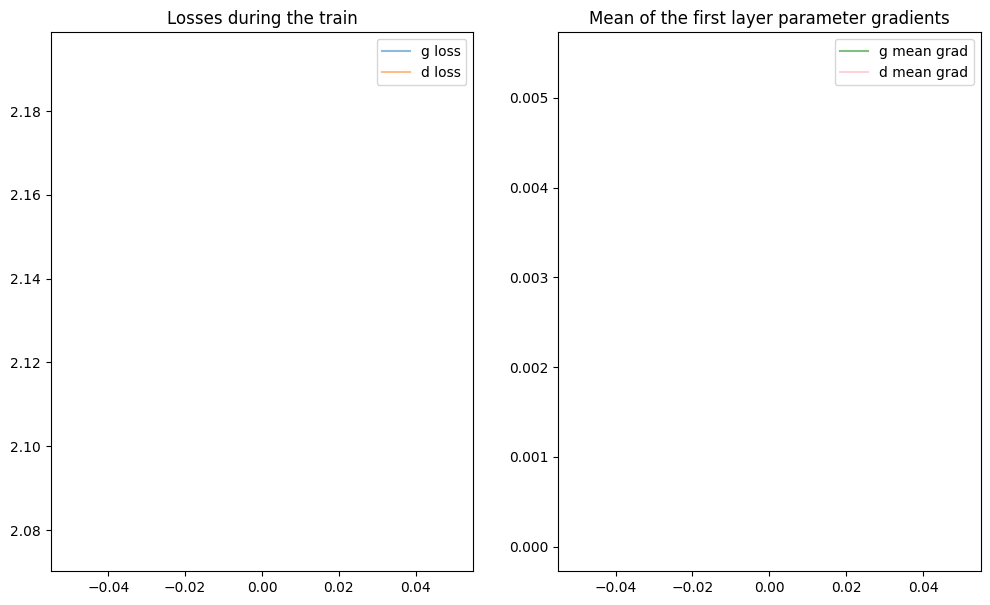

 50%|█████     | 25/50 [24:04<23:59, 57.60s/it]

it: 9775; g_loss: 1.3299689292907715; d_loss: 0.7783851027488708; avg_real_score: 0.6438517570495605; avg_fake_score: 0.20753467082977295;
                        g_gradient: [mean,norm,max,min]=(-6.756332027180179e-07, 1.8053340911865234, 0.012564882636070251, -0.013402187265455723);
                        d_gradient: [mean,norm,max,min]=(0.602489173412323, 111.98975372314453, 13.549227714538574, -2.6862244606018066)


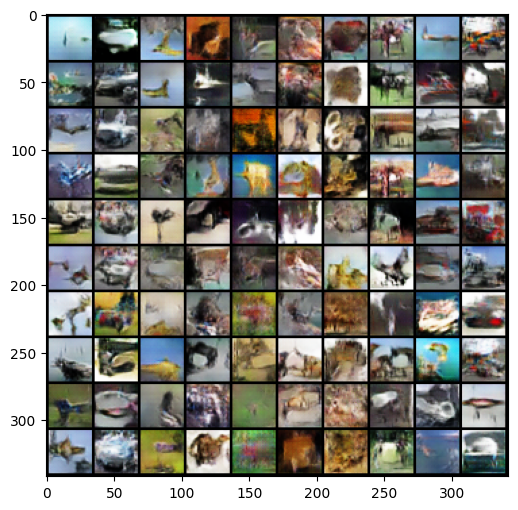

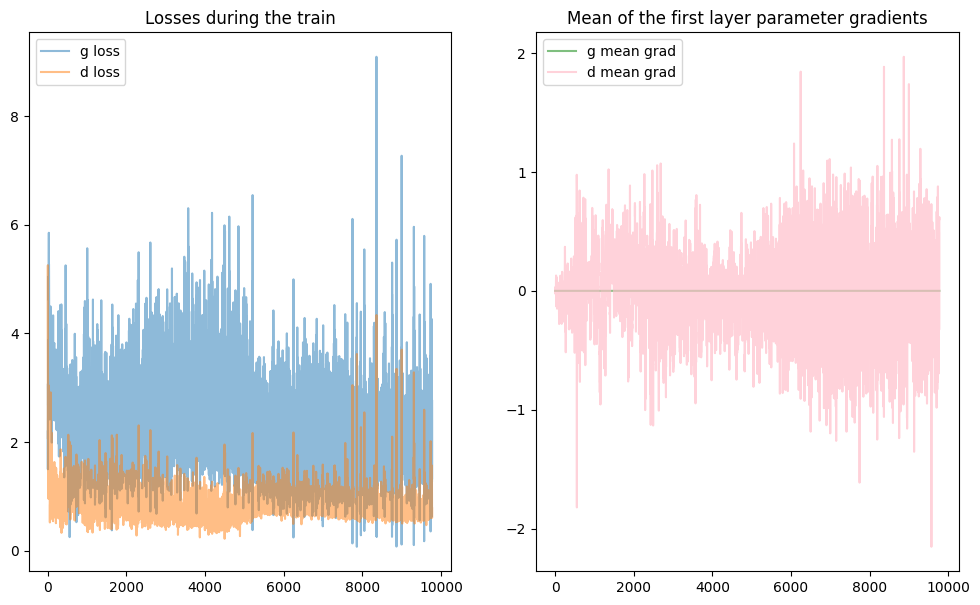

 98%|█████████▊| 49/50 [47:05<00:57, 57.42s/it]

it: 19549; g_loss: 3.6498875617980957; d_loss: 0.40834635496139526; avg_real_score: 0.8838512301445007; avg_fake_score: 0.20639705657958984;
                        g_gradient: [mean,norm,max,min]=(-9.265544917980151e-07, 4.630815029144287, 0.030007008463144302, -0.030785970389842987);
                        d_gradient: [mean,norm,max,min]=(-0.6223121881484985, 65.23789978027344, 1.650307297706604, -5.518909454345703)


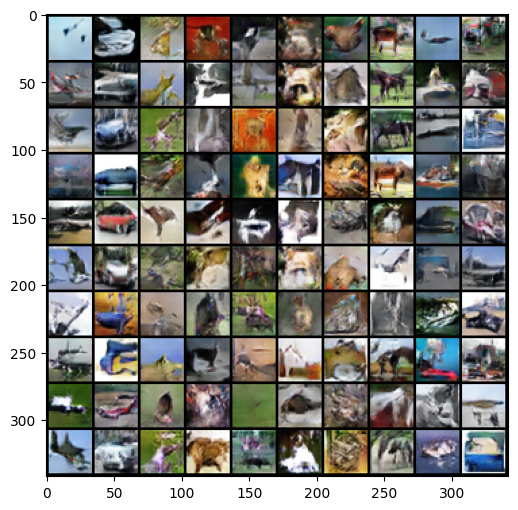

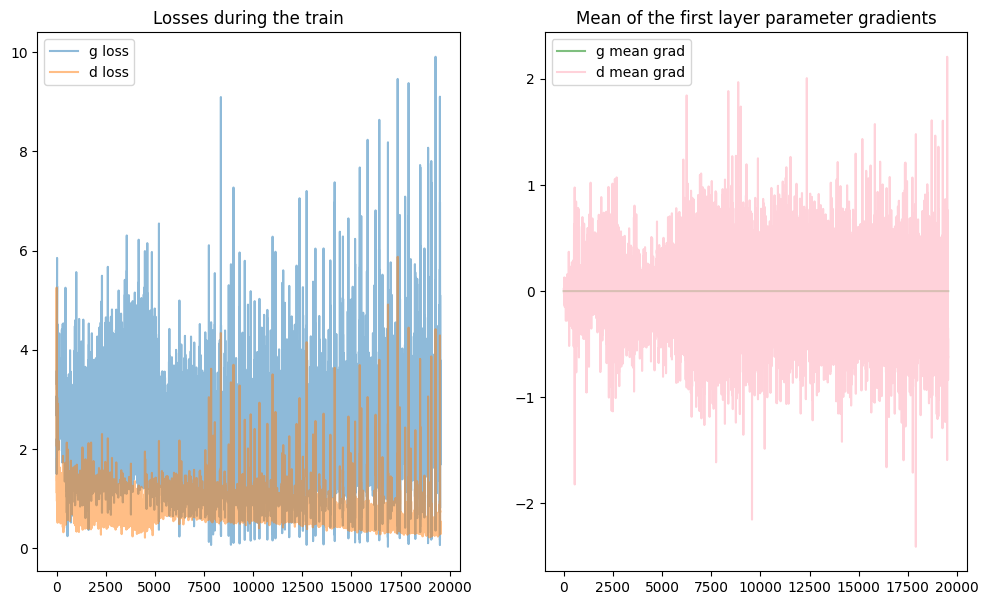

100%|██████████| 50/50 [48:04<00:00, 57.68s/it]

Training complete.


In [ ]:
nz = 1000
ndf = 32
ngf = 32
nchannels= 3
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

nc= 10

cifar10_net_cD_1 = ConditionalDiscriminator(ndf, nc, nchannels).to(device)
cifar10_net_cG_1 = ConditionalGenerator(nz, nc, ngf,nchannels).to(device)

cifar10_net_cG_1.apply(weights_init)
cifar10_net_cD_1.apply(weights_init)

g_opt = torch.optim.Adam(cifar10_net_cG_1.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(cifar10_net_cD_1.parameters(), lr=lr_d, betas=(beta1, 0.999))

training_cGAN(cifar10_net_cG_1,cifar10_net_cD_1, nz, g_opt, d_opt,cifar10_loader, display_freq=200, nb_epochs=50, display_first_last=True)

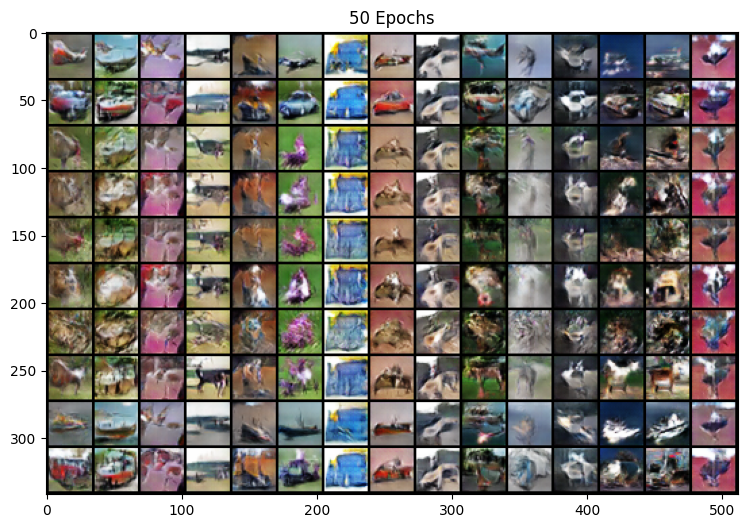

In [ ]:
n_ex = 15
n_classes = 10
nz = 1000
z = sample_z(n_ex, nz).repeat(n_classes, 1)

display_cGAN(cifar10_net_cG_1,z,n_classes,n_ex,nz,"50 Epochs")

#### 100 epochs

  0%|          | 0/100 [00:00<?, ?it/s]

it: 0; g_loss: 2.3086888790130615; d_loss: 2.0191192626953125; avg_real_score: 0.39978253841400146; avg_fake_score: 0.4696458578109741;
                        g_gradient: [mean,norm,max,min]=(4.260678849732358e-07, 2.1448974609375, 0.008842725306749344, -0.008475945331156254);
                        d_gradient: [mean,norm,max,min]=(0.008625386282801628, 8.444351196289062, 0.5552812814712524, -0.425646036863327)


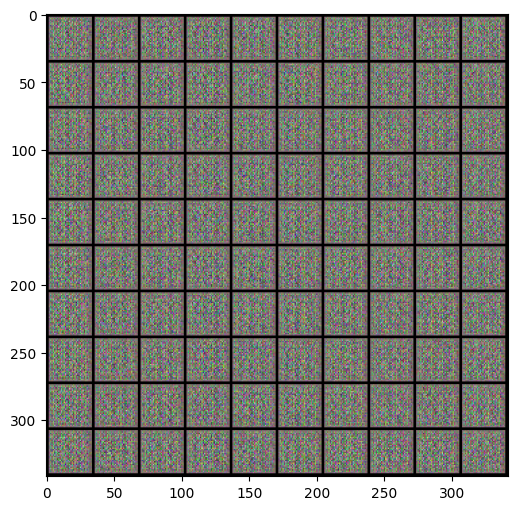

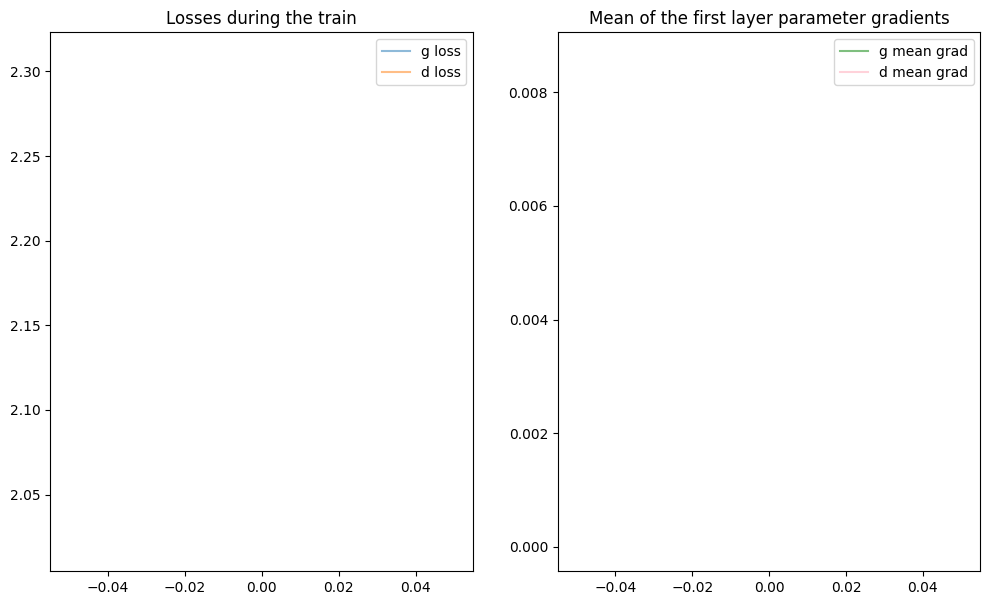

 12%|█▏        | 12/100 [11:49<1:26:38, 59.08s/it]

it: 4887; g_loss: 3.207791328430176; d_loss: 0.6820394992828369; avg_real_score: 0.7982150316238403; avg_fake_score: 0.2951599359512329;
                        g_gradient: [mean,norm,max,min]=(-3.2445254873891827e-06, 1.4817805290222168, 0.013713956810534, -0.012417793273925781);
                        d_gradient: [mean,norm,max,min]=(-0.2137082815170288, 52.971580505371094, 2.6578142642974854, -3.9883310794830322)


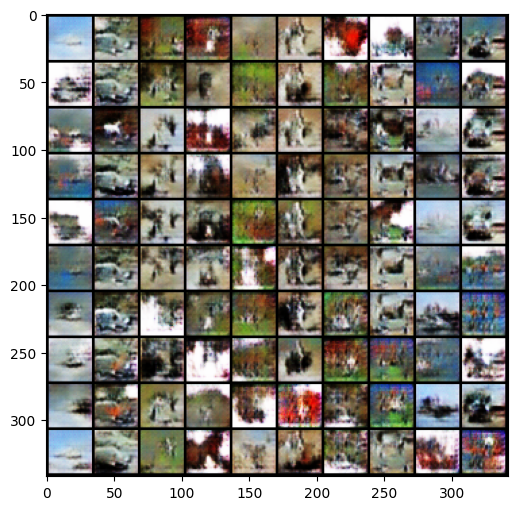

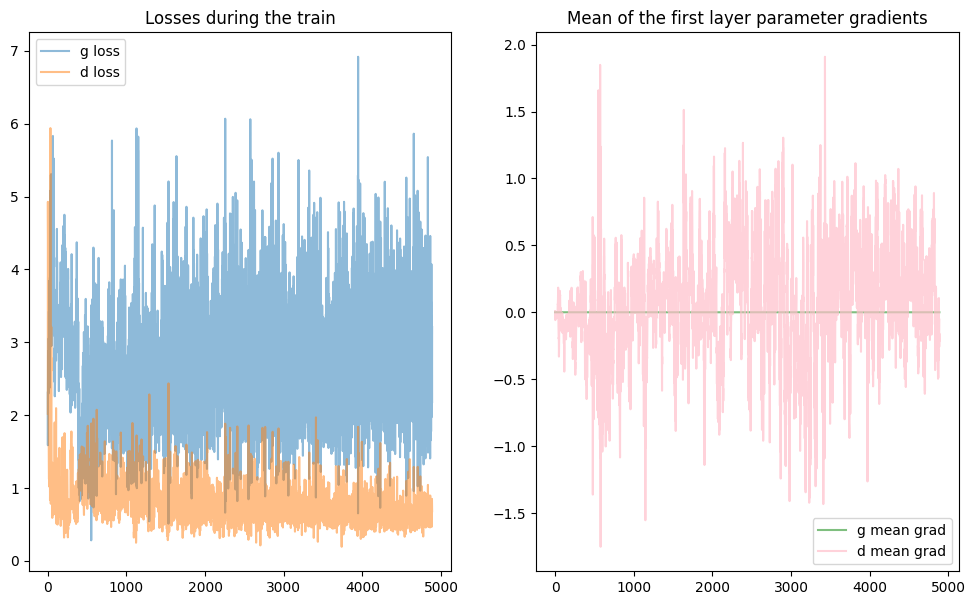

 25%|██▌       | 25/100 [24:37<1:13:47, 59.03s/it]

it: 9775; g_loss: 2.653470993041992; d_loss: 1.176782250404358; avg_real_score: 0.8810935616493225; avg_fake_score: 0.5804072022438049;
                        g_gradient: [mean,norm,max,min]=(-1.962153874046635e-06, 1.9293153285980225, 0.013033346273005009, -0.016459910199046135);
                        d_gradient: [mean,norm,max,min]=(0.14259867370128632, 50.26547622680664, 3.598045587539673, -3.2313859462738037)


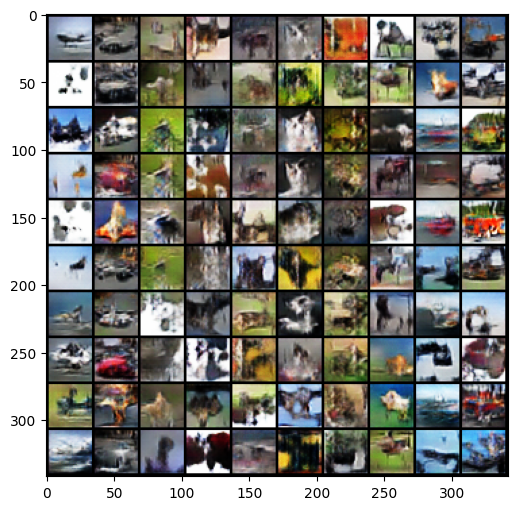

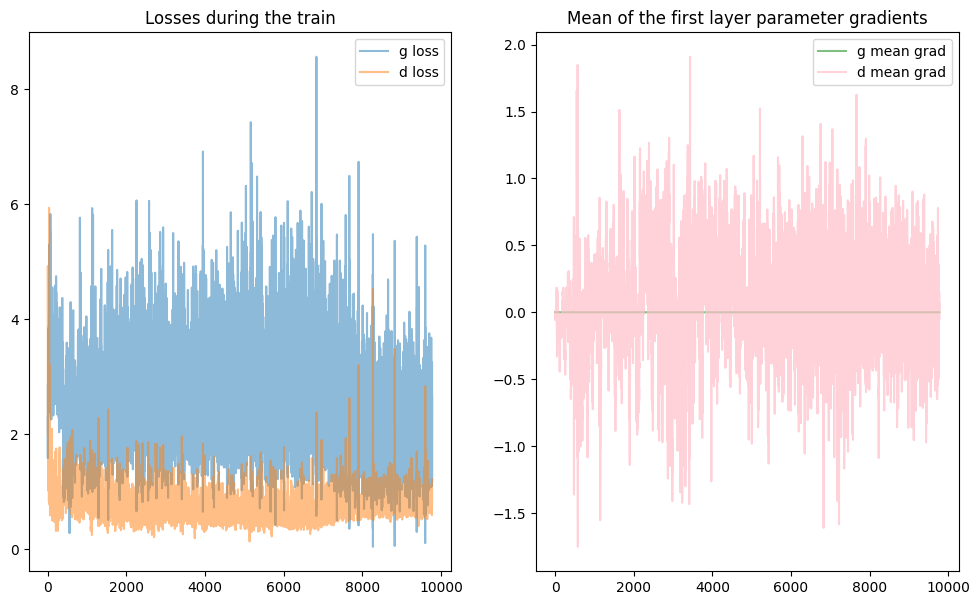

 50%|█████     | 50/100 [49:08<48:56, 58.73s/it]

it: 19550; g_loss: 3.5127532482147217; d_loss: 0.49849769473075867; avg_real_score: 0.920106053352356; avg_fake_score: 0.2862926721572876;
                        g_gradient: [mean,norm,max,min]=(1.530020995232917e-06, 2.9856135845184326, 0.020069658756256104, -0.02318074181675911);
                        d_gradient: [mean,norm,max,min]=(0.04440314695239067, 52.5953254699707, 4.899927139282227, -2.879547119140625)


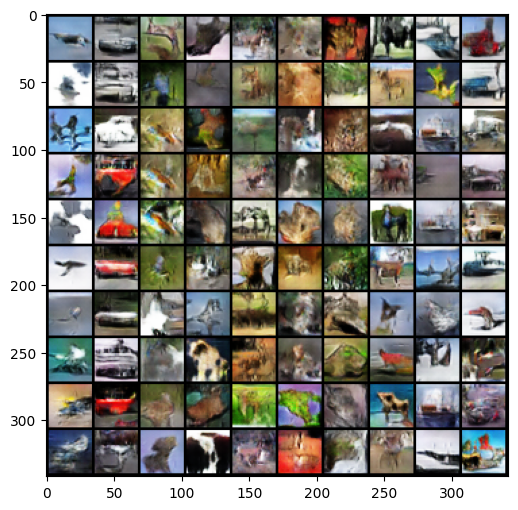

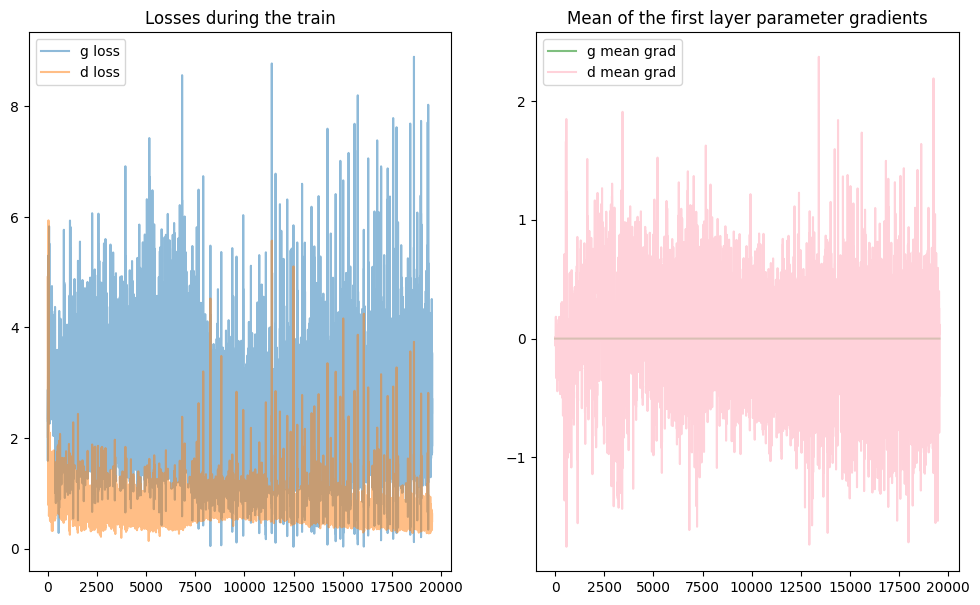

 99%|█████████▉| 99/100 [1:37:07<00:58, 58.63s/it]

it: 39099; g_loss: 3.832965135574341; d_loss: 0.14512576162815094; avg_real_score: 0.9111385345458984; avg_fake_score: 0.029698962345719337;
                        g_gradient: [mean,norm,max,min]=(5.590962700807722e-06, 6.0984649658203125, 0.06144214794039726, -0.05387924239039421);
                        d_gradient: [mean,norm,max,min]=(-0.5040220022201538, 104.69459533691406, 5.356313228607178, -6.365306377410889)


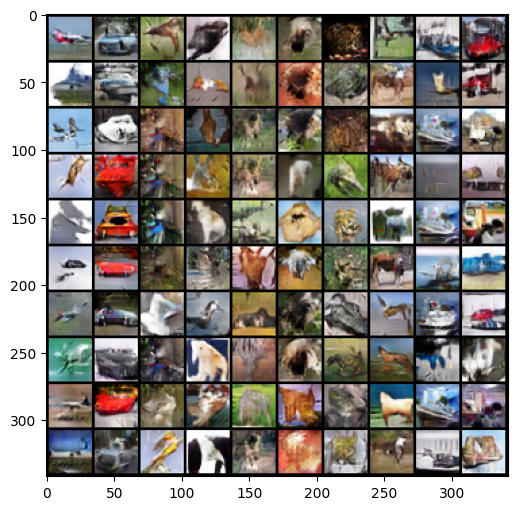

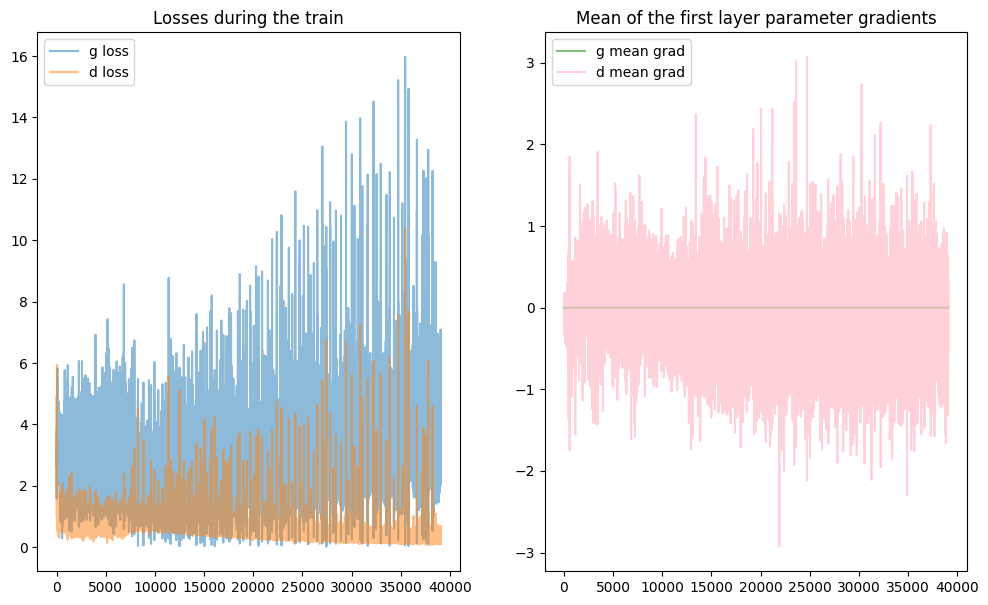

100%|██████████| 100/100 [1:38:07<00:00, 58.88s/it]

Training complete.


In [23]:
nz = 1000
ndf = 32
ngf = 32
nchannels= 3
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

nc= 10

cifar10_net_cD_2 = ConditionalDiscriminator(ndf, nc, nchannels).to(device)
cifar10_net_cG_2 = ConditionalGenerator(nz, nc, ngf,nchannels).to(device)

cifar10_net_cG_2.apply(weights_init)
cifar10_net_cD_2.apply(weights_init)

g_opt = torch.optim.Adam(cifar10_net_cG_2.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(cifar10_net_cD_2.parameters(), lr=lr_d, betas=(beta1, 0.999))

training_cGAN(cifar10_net_cG_2,cifar10_net_cD_2, nz, g_opt, d_opt,cifar10_loader, display_freq=200, nb_epochs=100, display_first_last=True)

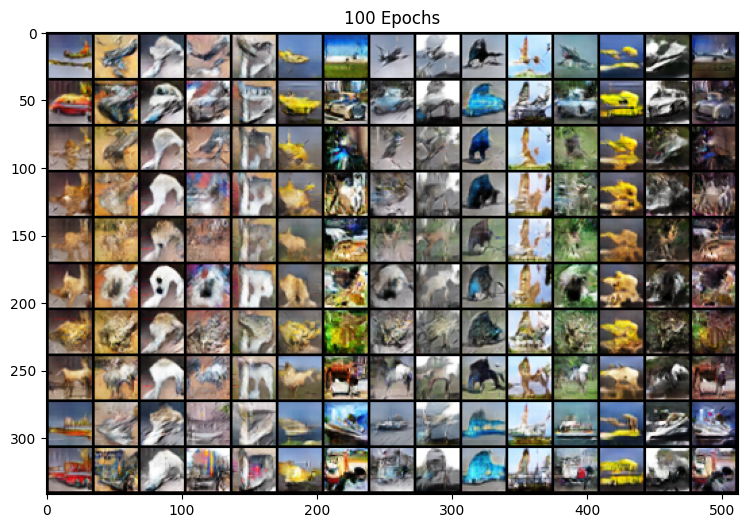

In [27]:
n_ex = 15
n_classes = 10
nz = 1000
z = sample_z(n_ex, nz).repeat(n_classes, 1)

display_cGAN(cifar10_net_cG_2,z,n_classes,n_ex,nz,"100 Epochs")